## Open Data and Imports 

In [83]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import descartes 
from shapely.geometry import Point, Polygon
import statsmodels.api as sm
import pmdarima as pm
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import  ARIMA
from sklearn.metrics import mean_squared_error
%matplotlib inline 

In [84]:
raw_df = pd.read_csv('Seoul.csv')
df_measurements = pd.read_csv('Measurement_info.csv')
df_station = pd.read_csv('Measurement_station_info.csv')

In [85]:
raw_df.head()

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
0,2017-01-01 00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005007,0.004,0.059,0.002,1.2,73.0,57.0
1,2017-01-01 01:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005007,0.004,0.058,0.002,1.2,71.0,59.0
2,2017-01-01 02:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005007,0.004,0.056,0.002,1.2,70.0,59.0
3,2017-01-01 03:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005007,0.004,0.056,0.002,1.2,70.0,58.0
4,2017-01-01 04:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005007,0.003,0.051,0.002,1.2,69.0,61.0


##### This is a general indiction of what levels of certain pollutants are the worse.

In [86]:
df_measurements

,Item code,Item name,Unit of measurement,Good(Blue),Normal(Green),Bad(Yellow),Very bad(Red)
0,1,SO2,ppm,0.02,0.05,0.15,1.0
1,3,NO2,ppm,0.03,0.06,0.20,2.0
2,5,CO,ppm,2.00,9.00,15.00,50.0
3,6,O3,ppm,0.03,0.09,0.15,0.5
4,8,PM10,Mircrogram/m3,30.00,80.00,150.00,600.0
5,9,PM2.5,Mircrogram/m3,15.00,35.00,75.00,500.0


##### Station based on district of Seoul

In [87]:
df_station

,Station code,Station name(district),Address,Latitude,Longitude
0,101,Jongno-gu,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008
1,102,Jung-gu,"15, Deoksugung-gil, Jung-gu, Seoul, Republic o...",37.564263,126.974676
2,103,Yongsan-gu,"136, Hannam-daero, Yongsan-gu, Seoul, Republic...",37.540033,127.004850
3,104,Eunpyeong-gu,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",37.609823,126.934848
4,105,Seodaemun-gu,"32, Segeomjeong-ro 4-gil, Seodaemun-gu, Seoul,...",37.593742,126.949679
5,106,Mapo-gu,"10, Poeun-ro 6-gil, Mapo-gu, Seoul, Republic o...",37.555580,126.905597
6,107,Seongdong-gu,"18, Ttukseom-ro 3-gil, Seongdong-gu, Seoul, Re...",37.541864,127.049659
7,108,Gwangjin-gu,"571, Gwangnaru-ro, Gwangjin-gu, Seoul, Republi...",37.547180,127.092493
8,109,Dongdaemun-gu,"43, Cheonho-daero 13-gil, Dongdaemun-gu, Seoul...",37.575743,127.028885
9,110,Jungnang-gu,"369, Yongmasan-ro, Jungnang-gu, Seoul, Republi...",37.584848,127.094023


##### Cutting down to look at the daily average and creating a df that looks at every station and date seperatley 

In [88]:
raw_df['Measurement date'] = raw_df['Measurement date'].str.slice(0, 11)
df = raw_df.groupby(['Station code', 'Measurement date']).aggregate({'SO2': 'mean', 'NO2':'mean', 'O3':'mean', 'CO':'mean', 'PM10':'mean', 'PM2.5':'mean'})

# Functions Relevant for Creating New Columns

##### SO2 Level

In [89]:
def SO2Level(x):
    if x <= 0.02:
        return "Good"
    elif 0.02 < x <= 0.05:
        return  "Normal"
    elif 0.05 < x <= 0.15:
        return "Bad"
    elif 0.15 < x <= 1.0:
        return  "Very Bad"
df['SO2 Level'] = df.apply(lambda row: SO2Level(row.SO2), axis=1)

##### NO2 Level

In [90]:
def NO2Level(x):
    if x <= 0.03:
        return "Good"
    elif 0.03 < x <= 0.06:
        return "Normal"
    elif 0.06 < x <= 0.2:
        return "Bad"
    elif 0.2 < x <= 2.0:
        return "Very Bad"
df['NO2 Level'] = df.apply(lambda row: NO2Level(row.NO2), axis=1) 

##### CO Level

In [91]:
def COLevel(x):
    if x <= 2:
        return "Good"
    elif 2 < x <= 9:
        return "Normal"
    elif 9 < x <= 15:
        return "Bad"
    elif 15 < x <= 50:
        return "Very Bad"
df['CO Level'] = df.apply(lambda row: COLevel(row.CO), axis=1)

##### O3 Level

In [92]:
def O3Level(x):
    if x <= 0.03:
        return "Good"
    elif 0.03 < x <= 0.09:
        return "Normal"
    elif 0.09 < x <= 0.15:
        return "Bad"
    elif 0.15 < x <= 0.5:
        return "Very Bad"
df['O3 Level'] = df.apply(lambda row: O3Level(row.O3), axis=1)

##### PM10 Level

In [93]:
def PM10Level(x):
    if x <= 30:
        return "Good"
    elif 30 < x <= 80:
        return "Normal"
    elif 80 < x <= 150:
        return "Bad"
    elif 150 < x <= 600:
        return "Very Bad"
df['PM10 Level'] = df.apply(lambda row: PM10Level(row.PM10), axis=1)

##### PM2.5 Level

In [94]:
def PM25Level(x):
    if x <= 15:
        return "Good"
    elif 15 < x <= 35:
        return "Normal"
    elif 35 < x <= 75:
        return "Bad"
    elif 75 < x <= 500:
        return "Very Bad"
df['PM2.5 Level'] = df.apply(lambda row: PM25Level(row['PM2.5']), axis=1)

In [95]:
df

SO2       NO2        O3        CO  \
Station code Measurement date                                           
101          2017-01-01        0.004208  0.054250  0.003125  1.029167   
             2017-01-02        0.004792  0.046250  0.016375  1.020833   
             2017-01-03        0.004833  0.046750  0.013875  0.833333   
             2017-01-04        0.005375  0.058167  0.008750  0.991667   
             2017-01-05        0.004333  0.041333  0.011000  0.620833   
...                                 ...       ...       ...       ...   
125          2019-12-27        0.002958  0.031667  0.015708  0.562500   
             2019-12-28        0.003292  0.043417  0.005667  0.612500   
             2019-12-29        0.003125  0.036833  0.007958  0.591667   
             2019-12-30        0.002958  0.030792  0.012083  0.591667   
             2019-12-31        0.002875  0.019542  0.018542  0.416667   

                                     PM10      PM2.5 SO2 Level NO2 Level  \
Station code Measurement date                                              
101          2017-01-01         81.666667  67.291667      Good    Normal   
             2017-01-02        112.166667  87.166667      Good    Normal   
             2017-01-03         72.916667  51.833333      Good    Normal   
             2017-01-04         51.125000  34.916667      Good    Normal   
             2017-01-05         34.875000  21.958333      Good    Normal   
...                                   ...        ...       ...       ...   
125          2019-12-27         41.083333  30.125000      Good    Normal   
             2019-12-28         49.375000  31.291667      Good    Normal   
             2019-12-29         49.791667  33.666667      Good    Normal   
             2019-12-30         46.125000  35.250000      Good    Normal   
             2019-12-31         27.458333  19.291667      Good      Good   

                              CO Level O3 Level PM10 Level PM2.5 Level  
Station code Measurement date                                           
101          2017-01-01           Good     Good        Bad         Bad  
             2017-01-02           Good     Good        Bad    Very Bad  
             2017-01-03           Good     Good     Normal         Bad  
             2017-01-04           Good     Good     Normal      Normal  
             2017-01-05           Good     Good     Normal      Normal  
...                                ...      ...        ...         ...  
125          2019-12-27           Good     Good     Normal      Normal  
             2019-12-28           Good     Good     Normal      Normal  
             2019-12-29           Good     Good     Normal      Normal  
             2019-12-30           Good     Good     Normal         Bad  
             2019-12-31           Good     Good       Good      Normal  

[27125 rows x 12 columns]

# Some EDA 

In [99]:
df.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 27125 entries, (101, '2017-01-01 ') to (125, '2019-12-31 ')
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   SO2          27125 non-null  float64
 1   NO2          27125 non-null  float64
 2   O3           27125 non-null  float64
 3   CO           27125 non-null  float64
 4   PM10         27125 non-null  float64
 5   PM2.5        27125 non-null  float64
 6   SO2 Level    27125 non-null  object 
 7   NO2 Level    27123 non-null  object 
 8   CO Level     27125 non-null  object 
 9   O3 Level     27123 non-null  object 
 10  PM10 Level   27109 non-null  object 
 11  PM2.5 Level  27117 non-null  object 
dtypes: float64(6), object(6)
memory usage: 2.6+ MB


Looking to see any correlations between any pollutants 

In [100]:
df.corr().style.background_gradient(cmap='coolwarm')

,SO2,NO2,O3,CO,PM10,PM2.5
SO2,1.000000,0.915449,0.934451,0.416637,0.064411,0.090977
NO2,0.915449,1.000000,0.936623,0.467155,0.099394,0.149780
O3,0.934451,0.936623,1.000000,0.343521,0.059576,0.076826
CO,0.416637,0.467155,0.343521,1.000000,0.245039,0.407023
PM10,0.064411,0.099394,0.059576,0.245039,1.000000,0.360625
PM2.5,0.090977,0.149780,0.076826,0.407023,0.360625,1.000000


Looking at Stations and different 

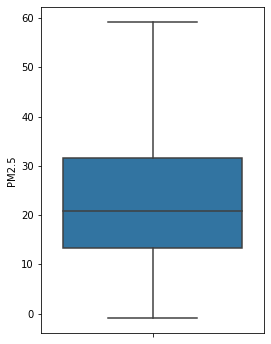

In [101]:
#Pm2.5 Levels by Stations
fig, axes = plt.subplots(1, 1, figsize=(4, 6))
sns.boxplot(y='PM2.5', data=df, showfliers=False);

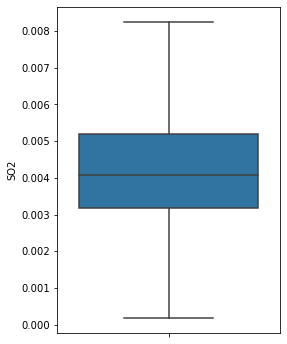

In [102]:
#SO2 Levels by Stations
fig, axes = plt.subplots(1, 1, figsize=(4, 6))
sns.boxplot(y='SO2', data=df, showfliers=False);

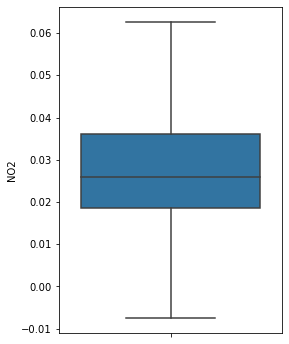

In [103]:
#NO2 Levels by Stations
fig, axes = plt.subplots(1, 1, figsize=(4, 6))
sns.boxplot(y='NO2', data=df, showfliers=False);

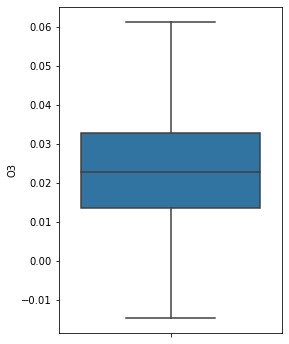

In [104]:
#O3 Levels by Stations
fig, axes = plt.subplots(1, 1, figsize=(4, 6))
sns.boxplot(y='O3', data=df, showfliers=False);

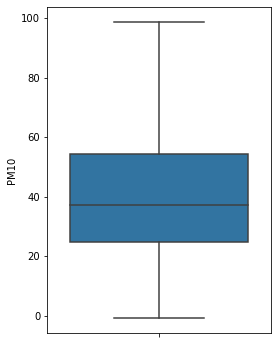

In [105]:
#PM10 Levels by Stations
fig, axes = plt.subplots(1, 1, figsize=(4, 6))
sns.boxplot(y='PM10', data=df, showfliers=False);

In [106]:
df = df.reset_index()

In [107]:
df['Measurement date'] = pd.to_datetime(df['Measurement date'])
df.set_index(df['Measurement date'], inplace=True)
df = df.drop('Measurement date', axis=1)
df

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,101,0.004208,0.054250,0.003125,1.029167,81.666667,67.291667,Good,Normal,Good,Good,Bad,Bad
2017-01-02,101,0.004792,0.046250,0.016375,1.020833,112.166667,87.166667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,101,0.004833,0.046750,0.013875,0.833333,72.916667,51.833333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,101,0.005375,0.058167,0.008750,0.991667,51.125000,34.916667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,101,0.004333,0.041333,0.011000,0.620833,34.875000,21.958333,Good,Normal,Good,Good,Normal,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-27,125,0.002958,0.031667,0.015708,0.562500,41.083333,30.125000,Good,Normal,Good,Good,Normal,Normal
2019-12-28,125,0.003292,0.043417,0.005667,0.612500,49.375000,31.291667,Good,Normal,Good,Good,Normal,Normal
2019-12-29,125,0.003125,0.036833,0.007958,0.591667,49.791667,33.666667,Good,Normal,Good,Good,Normal,Normal


In [108]:
df_station

,Station code,Station name(district),Address,Latitude,Longitude
0,101,Jongno-gu,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008
1,102,Jung-gu,"15, Deoksugung-gil, Jung-gu, Seoul, Republic o...",37.564263,126.974676
2,103,Yongsan-gu,"136, Hannam-daero, Yongsan-gu, Seoul, Republic...",37.540033,127.004850
3,104,Eunpyeong-gu,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",37.609823,126.934848
4,105,Seodaemun-gu,"32, Segeomjeong-ro 4-gil, Seodaemun-gu, Seoul,...",37.593742,126.949679
5,106,Mapo-gu,"10, Poeun-ro 6-gil, Mapo-gu, Seoul, Republic o...",37.555580,126.905597
6,107,Seongdong-gu,"18, Ttukseom-ro 3-gil, Seongdong-gu, Seoul, Re...",37.541864,127.049659
7,108,Gwangjin-gu,"571, Gwangnaru-ro, Gwangjin-gu, Seoul, Republi...",37.547180,127.092493
8,109,Dongdaemun-gu,"43, Cheonho-daero 13-gil, Dongdaemun-gu, Seoul...",37.575743,127.028885
9,110,Jungnang-gu,"369, Yongmasan-ro, Jungnang-gu, Seoul, Republi...",37.584848,127.094023


Testing every station and see what pollutants are relavent to each station before modeling and testing. I will sperate every year and see if it shows the variation

In [109]:
features = ['SO2', 'NO2', 'O3', 'CO', 'PM10', 'PM2.5']

## Relevant functions 

In [110]:
def arima_results(endog, test, order=[0,0,0]):
    arima = ARIMA(endog, order=order).fit()
    
    train_hat = arima.predict()
    
    rmse_train = mean_squared_error(endog,
                                    train_hat,
                                    squared=False)
    
    
    rmse_test = mean_squared_error(test,
                                   arima.predict(), 
                                   squared=False)
    
 
    print(f"""Train RMSE: {rmse_train}""")     
    print(f"""Test RMSE: {rmse_test}""")    
    print(f"""Summary: {arima.summary()}""")
    
    return sm

In [111]:
def stationarity_check(df):     
    df_test = adfuller(df)
    print('Results of Dickey-Fuller Test: \n')

    dfoutput = pd.Series(df_test[0:4], index=['Test Statistic', 'p-value', 
                                             '#Lags Used', 'Number of Observations Used'])
    for key,value in df_test[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)
    return None

In [112]:
def arimamodel(timeseries):
    automodel = pm.auto_arima(timeseries, 
                              start_p=1, 
                              start_q=1,
                              test="adf",
                              seasonal=False,
                              trace=True)
    return automodel

In [113]:
def plotarima(n_periods, timeseries, automodel):
    # Forecast
    fc, confint = automodel.predict(n_periods=n_periods, 
                                    return_conf_int=True)
    # Weekly index
    fc_ind = pd.date_range(timeseries.index[timeseries.shape[0]-1], 
                           periods=n_periods, 
                           freq="W")
    # Forecast series
    fc_series = pd.Series(fc, index=fc_ind)
    # Upper and lower confidence bounds
    lower_series = pd.Series(confint[:, 0], index=fc_ind)
    upper_series = pd.Series(confint[:, 1], index=fc_ind)
    # Create plot
    plt.figure(figsize=(10, 6))
    plt.plot(timeseries)
    plt.plot(fc_series, color="red")
    plt.xlabel("date")
    plt.ylabel(timeseries.name)
    plt.fill_between(lower_series.index, 
                     lower_series, 
                     upper_series, 
                     color="k", 
                     alpha=0.25)
    plt.legend(("past", "forecast", "95% confidence interval"),  
               loc="upper left")
    plt.show()

# Station 101

In [114]:
df_101 = df[df['Station code'] == 101]

In [115]:
df_101

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,101,0.004208,0.054250,0.003125,1.029167,81.666667,67.291667,Good,Normal,Good,Good,Bad,Bad
2017-01-02,101,0.004792,0.046250,0.016375,1.020833,112.166667,87.166667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,101,0.004833,0.046750,0.013875,0.833333,72.916667,51.833333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,101,0.005375,0.058167,0.008750,0.991667,51.125000,34.916667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,101,0.004333,0.041333,0.011000,0.620833,34.875000,21.958333,Good,Normal,Good,Good,Normal,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-27,101,0.006042,0.025083,0.018375,0.837500,34.416667,24.958333,Good,Good,Good,Good,Normal,Normal
2019-12-28,101,0.004250,0.046542,0.004708,0.766667,44.500000,30.458333,Good,Normal,Good,Good,Normal,Normal
2019-12-29,101,0.003792,0.037750,0.008167,0.708333,45.375000,30.291667,Good,Normal,Good,Good,Normal,Normal


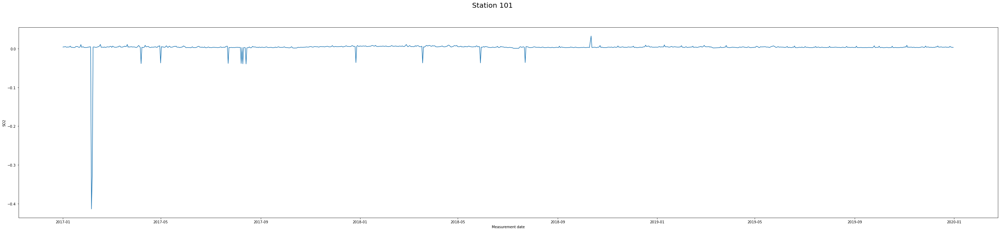

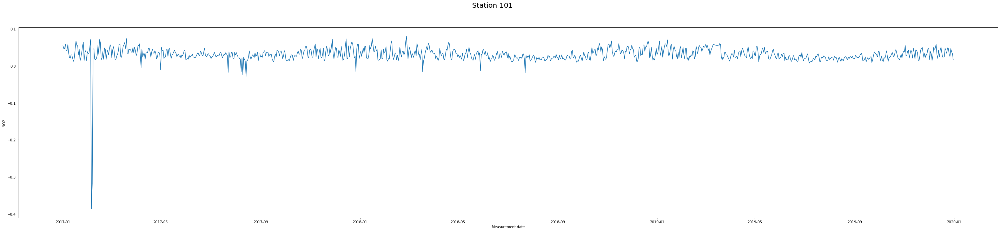

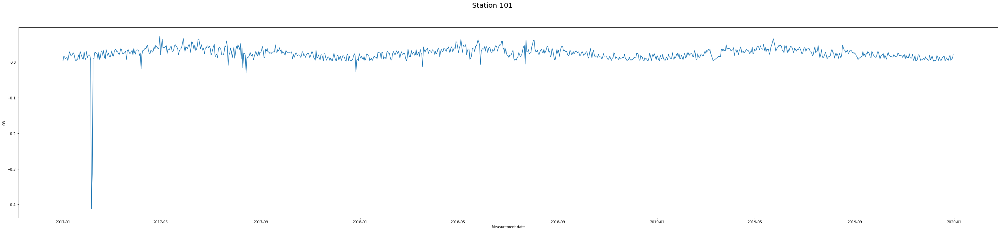

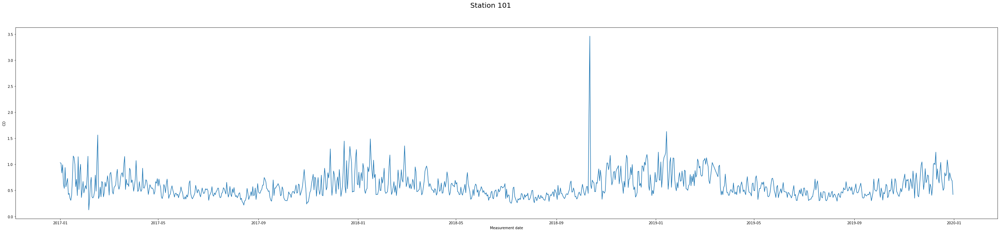

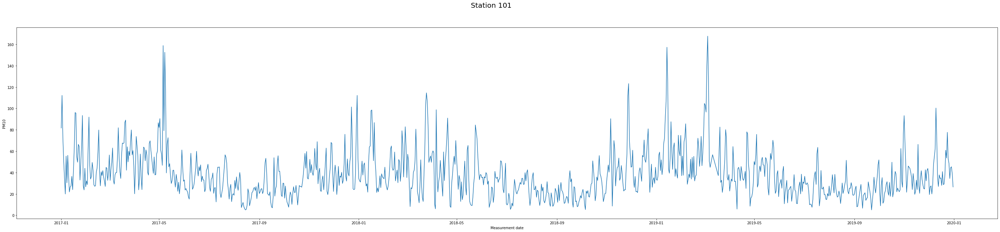

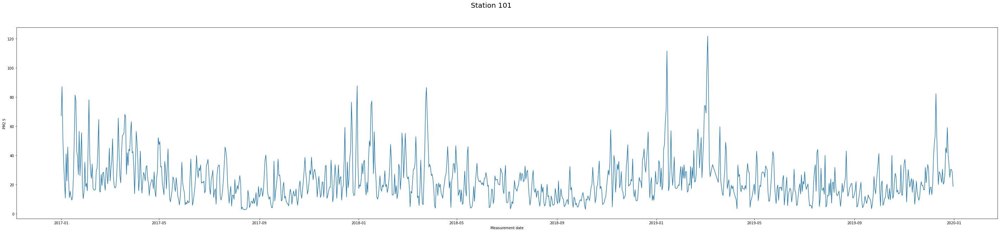

In [116]:
for feature in features:
    fig, ax = plt.subplots(figsize=(50,10))
    fig.suptitle("Station 101", fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_101)

#### So as seen above for Station 101
- NO2 reaches levels of 'Bad' on 24 occasions and sits close to bad on most of the year. 
- PM10 reaches levels of 'Bad' on 46 occasions and 'Very Bad' on 4, can gets close to bad on many occasions. 
- Lastly, PM2.5 reaches levels of 'Bad' on 146 occasions and 'Very Bad' on 14 occasions. 
- Therefore, i will make a new df that only has those three pollutants since I am trying to test for pollutants that are deadly. 

In [117]:
df_101

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,101,0.004208,0.054250,0.003125,1.029167,81.666667,67.291667,Good,Normal,Good,Good,Bad,Bad
2017-01-02,101,0.004792,0.046250,0.016375,1.020833,112.166667,87.166667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,101,0.004833,0.046750,0.013875,0.833333,72.916667,51.833333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,101,0.005375,0.058167,0.008750,0.991667,51.125000,34.916667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,101,0.004333,0.041333,0.011000,0.620833,34.875000,21.958333,Good,Normal,Good,Good,Normal,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-27,101,0.006042,0.025083,0.018375,0.837500,34.416667,24.958333,Good,Good,Good,Good,Normal,Normal
2019-12-28,101,0.004250,0.046542,0.004708,0.766667,44.500000,30.458333,Good,Normal,Good,Good,Normal,Normal
2019-12-29,101,0.003792,0.037750,0.008167,0.708333,45.375000,30.291667,Good,Normal,Good,Good,Normal,Normal


# Picking the relevant columns 

In [118]:
columns = ['NO2', 'PM10', 'PM2.5']
df_101 = df_101[columns]
df_101

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.054250,81.666667,67.291667
2017-01-02,0.046250,112.166667,87.166667
2017-01-03,0.046750,72.916667,51.833333
2017-01-04,0.058167,51.125000,34.916667
2017-01-05,0.041333,34.875000,21.958333
...,...,...,...
2019-12-27,0.025083,34.416667,24.958333
2019-12-28,0.046542,44.500000,30.458333
2019-12-29,0.037750,45.375000,30.291667


# Train-Test Split

In [119]:
train = df_101[:-542]
test = df_101[542:]

<AxesSubplot:xlabel='Measurement date'>

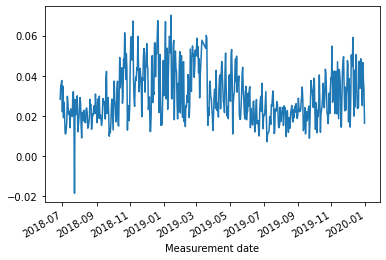

In [120]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

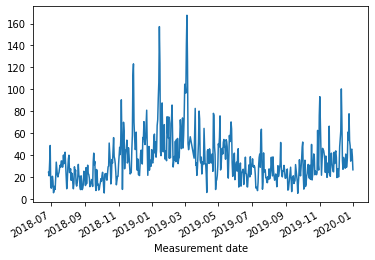

In [121]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

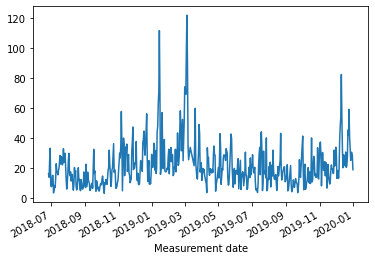

In [122]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

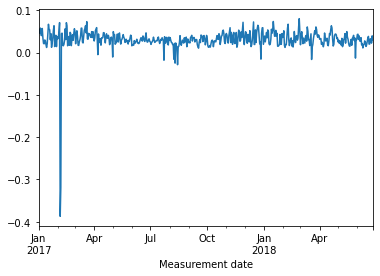

In [123]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

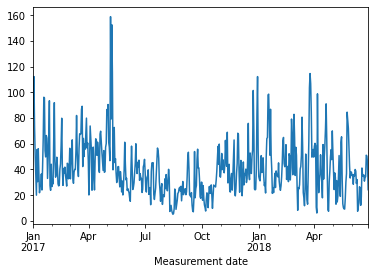

In [124]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

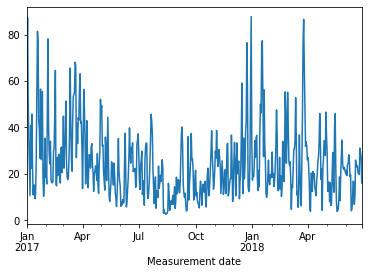

In [125]:
train['PM2.5'].plot()

In [126]:
print(stationarity_check(df_101['PM2.5']))
print(stationarity_check(df_101['PM10']))
print(stationarity_check(df_101['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                   -5.321631
p-value                           0.000005
#Lags Used                       13.000000
Number of Observations Used    1071.000000
Critical Value (1%)              -3.436470
Critical Value (5%)              -2.864242
Critical Value (10%)             -2.568209
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -5.915741e+00
p-value                        2.575463e-07
#Lags Used                     1.000000e+01
Number of Observations Used    1.074000e+03
Critical Value (1%)           -3.436453e+00
Critical Value (5%)           -2.864235e+00
Critical Value (10%)          -2.568205e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.508201e+00
p-value                        1.117369e-08
#Lags Used                     1.300000e+01
Number of Observations Used    1.071000e+03
Critical Value (1%)           -3.436470e+00
Critical Value (5%)           -2

# Rolling Mean Difference Train

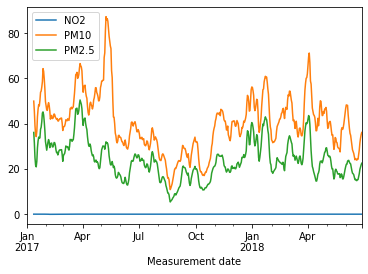

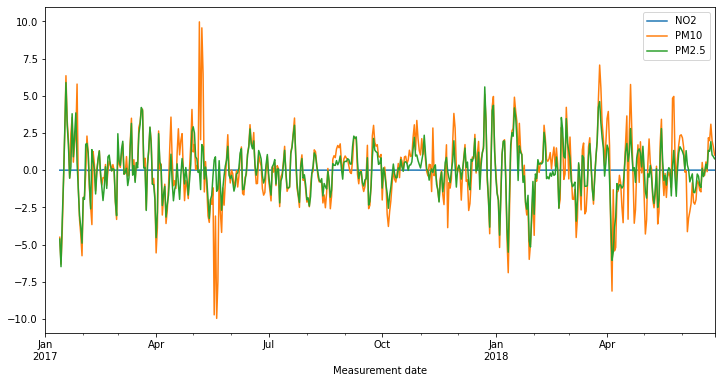

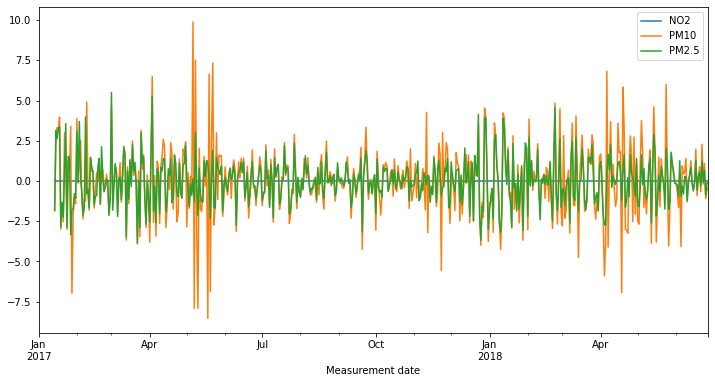

In [127]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [128]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.721942e+00
p-value                        1.186229e-11
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.362457e+00
p-value                        2.799742e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.917348e+00
p-value                        1.063850e-14
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)      

In [129]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.076823e+01
p-value                        2.421605e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.073179e+01
p-value                        2.966897e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.952936e+00
p-value                        2.486988e-17
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Test

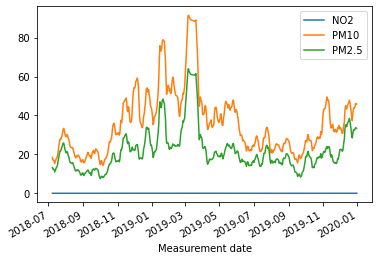

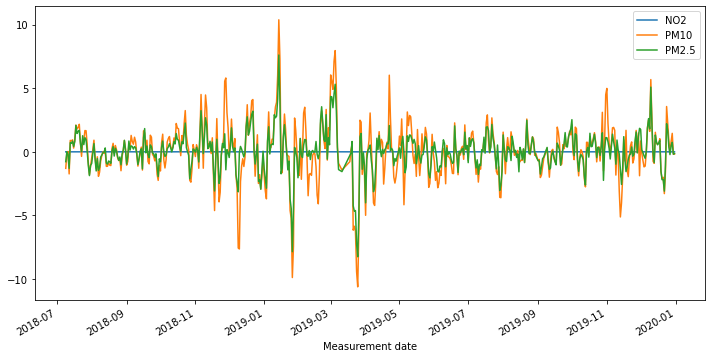

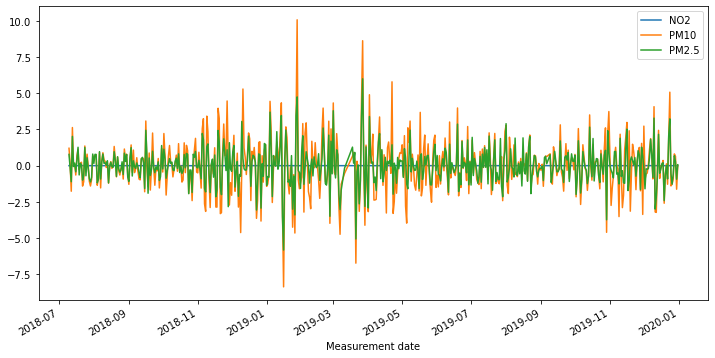

In [130]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [131]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.342381e+00
p-value                        2.734622e-08
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.979350e+00
p-value                        2.649065e-12
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.795774e+00
p-value                        2.303079e-09
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)      

In [132]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.560612e+00
p-value                        2.431629e-16
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.166386e+01
p-value                        1.904796e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.017954e+01
p-value                        6.751796e-18
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# First Simple Model 

# Station 101 PM2.5

In [133]:
base_model = sm.tsa.statespace.SARIMAX(df_101['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4467.775
Date:                Mon, 18 Oct 2021   AIC                           8939.549
Time:                        11:06:16   BIC                           8949.528
Sample:                             0   HQIC                          8943.327
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     22.8531      0.609     37.504      0.000      21.659      24.047
sigma2       220.8872      6.567     33.634      0.000     208.015     233.759
Ljung-Box (L1) (Q):                 510.36   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8379.443, Time=0.04 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10253.923, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8377.701, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9291.279, Time=0.04 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8379.575, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8371.134, Time=0.09 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8210.393, Time=0.21 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8323.457, Time=0.07 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8208.702, Time=0.27 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8303.897, Time=0.07 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8210.655, Time=0.40 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=0.56 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8209.151, Time=0.31 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=8291.323, Time=0.14 sec
 ARIMA(5,0,2)(0,0,0)[0]             :

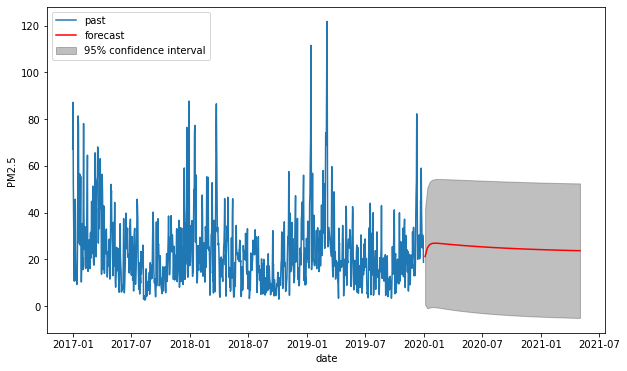

In [134]:
timeseries = df_101['PM2.5']
automodel = arimamodel(df_101['PM2.5'])
plotarima(70, timeseries, automodel)

In [135]:
best_model = sm.tsa.statespace.SARIMAX(df_101['PM2.5'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4094.542
Date:                Mon, 18 Oct 2021   AIC                           8201.084
Time:                        11:06:24   BIC                           8231.020
Sample:                             0   HQIC                          8212.417
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3303      0.217      1.521      0.128      -0.095       0.756
ar.L1          1.3768      0.057     24.285      0.000       1.266       1.488
ar.L2         -0.3913      0.051     -7.701      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [136]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 11.141133861796654
Test RMSE: 18.608189264988095
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2076.121
Date:                Mon, 18 Oct 2021   AIC                           4164.242
Time:                        11:06:25   BIC                           4190.025
Sample:                    01-01-2017   HQIC                          4174.323
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         24.4734      1.586     15.430      0.000      21.365      27.582
ar.L1         -0.2620      0.167     -1.569      0.117      -

# Station 101 NO2

In [137]:
base_model = sm.tsa.statespace.SARIMAX(df_101['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                2626.791
Date:                Mon, 18 Oct 2021   AIC                          -5249.583
Time:                        11:06:25   BIC                          -5239.604
Sample:                             0   HQIC                         -5245.805
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0305      0.001     30.446      0.000       0.029       0.033
sigma2         0.0005   3.09e-06    149.742      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 216.31   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-5303.845, Time=0.20 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4052.782, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-5241.732, Time=0.06 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-4842.913, Time=0.07 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-5266.897, Time=0.18 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-5577.093, Time=0.35 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-5022.466, Time=0.09 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-5563.326, Time=0.38 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-5575.378, Time=0.53 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-5086.023, Time=0.21 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-5573.402, Time=0.48 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-5571.659, Time=0.21 sec

Best model:  ARIMA(1,0,2)(0,0,0)[0]          
Total fit time: 2.785 seconds


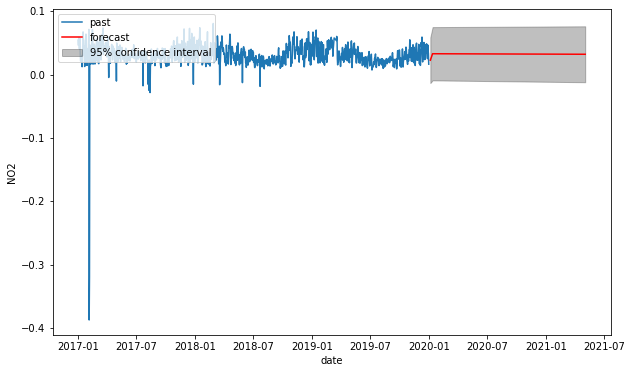

In [138]:
timeseries = df_101['NO2']
automodel = arimamodel(df_101['NO2'])
plotarima(70, timeseries, automodel)

In [139]:
best_model = sm.tsa.statespace.SARIMAX(df_101['NO2'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood                2790.830
Date:                Mon, 18 Oct 2021   AIC                          -5571.659
Time:                        11:06:28   BIC                          -5546.712
Sample:                             0   HQIC                         -5562.215
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0142      0.021      0.691      0.490      -0.026       0.054
ar.L1          0.5350      0.671      0.797      0.425      -0.780       1.850
ma.L1          0.0628      0.671      0.094      0.9

In [140]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[1,0,2])

Train RMSE: 11.179153390361055
Test RMSE: 18.609613715224143
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood               -2078.064
Date:                Mon, 18 Oct 2021   AIC                           4166.128
Time:                        11:06:28   BIC                           4187.614
Sample:                    01-01-2017   HQIC                          4174.529
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         24.4767      1.625     15.066      0.000      21.293      27.661
ar.L1          0.6017      0.095      6.318      0.000       

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 101 PM10

In [141]:
base_model = sm.tsa.statespace.SARIMAX(df_101['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4875.241
Date:                Mon, 18 Oct 2021   AIC                           9754.481
Time:                        11:06:28   BIC                           9764.460
Sample:                             0   HQIC                          9758.259
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     37.9738      0.849     44.748      0.000      36.311      39.637
sigma2       468.1279     14.189     32.993      0.000     440.319     495.937
Ljung-Box (L1) (Q):                 512.02   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9190.636, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11278.195, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9204.205, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10298.104, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9204.883, Time=0.13 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9063.629, Time=0.09 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=9879.548, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9022.992, Time=0.16 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9024.473, Time=0.39 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9024.319, Time=0.31 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=9032.012, Time=0.18 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9025.688, Time=0.22 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=9025.719, Time=0.43 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=9017.193, Time=0.52 sec
 ARIMA(1,0,2)(0,0,0)[0] interce

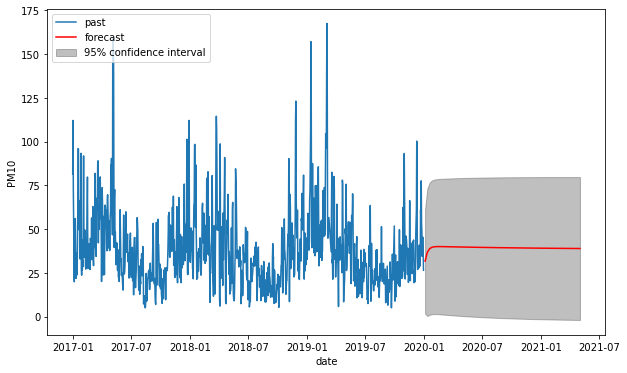

In [142]:
timeseries = df_101['PM10']
automodel = arimamodel(df_101['PM10'])
plotarima(70, timeseries, automodel)

In [143]:
best_model = sm.tsa.statespace.SARIMAX(df_101['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4502.597
Date:                Mon, 18 Oct 2021   AIC                           9017.193
Time:                        11:06:35   BIC                           9047.129
Sample:                             0   HQIC                          9028.526
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.4130      0.268      1.542      0.123      -0.112       0.938
ar.L1          1.3866      0.048     28.910      0.000       1.293       1.481
ar.L2         -0.3974      0.044     -9.004      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [144]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

Train RMSE: 16.409248252265836
Test RMSE: 28.582567463643873
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2288.574
Date:                Mon, 18 Oct 2021   AIC                           4589.148
Time:                        11:06:35   BIC                           4614.931
Sample:                    01-01-2017   HQIC                          4599.229
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         40.7421      5.394      7.553      0.000      30.170      51.314
ar.L1          1.4014      0.067     21.006      0.000       

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 102

In [145]:
df_102 = df[df['Station code'] == 102]

In [146]:
df_102['PM2.5 Level'].value_counts()

Normal      581
Good        345
Bad         147
Very Bad     12
Name: PM2.5 Level, dtype: int64

In [147]:
df_102.tail()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2019-12-27,102,0.003167,0.022667,0.020417,0.495833,33.333333,28.250000,Good,Good,Good,Good,Normal,Normal
2019-12-28,102,0.003625,0.043792,0.003833,0.695833,44.000000,32.833333,Good,Normal,Good,Good,Normal,Normal
2019-12-29,102,0.003500,0.034958,0.008292,0.612500,44.958333,33.166667,Good,Normal,Good,Good,Normal,Normal
2019-12-30,102,0.003083,0.029875,0.011833,0.600000,35.250000,29.791667,Good,Good,Good,Good,Normal,Normal
2019-12-31,102,0.002375,0.013583,0.021542,0.375000,25.666667,18.041667,Good,Good,Good,Good,Good,Normal


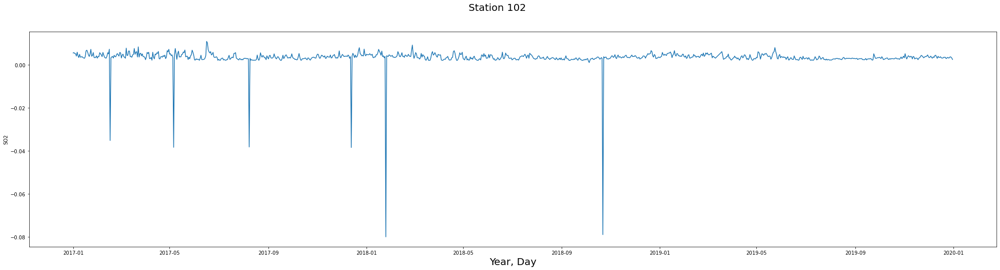

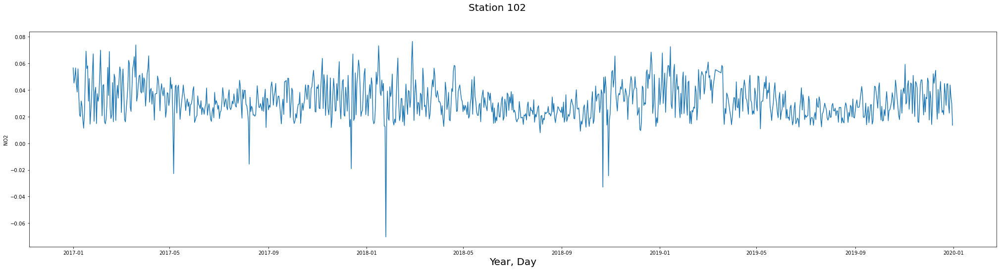

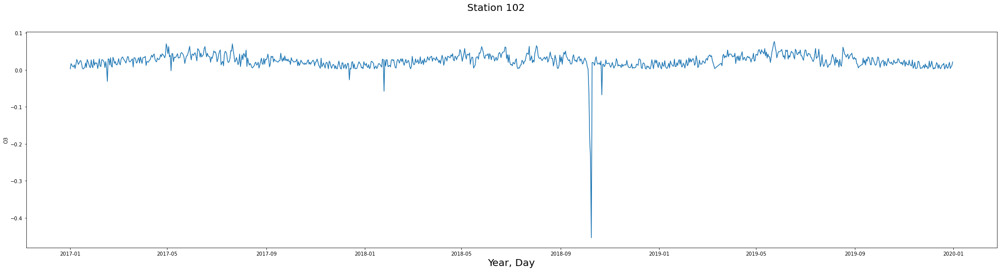

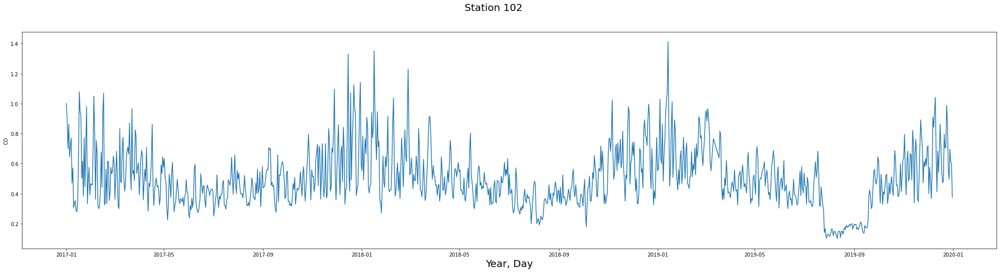

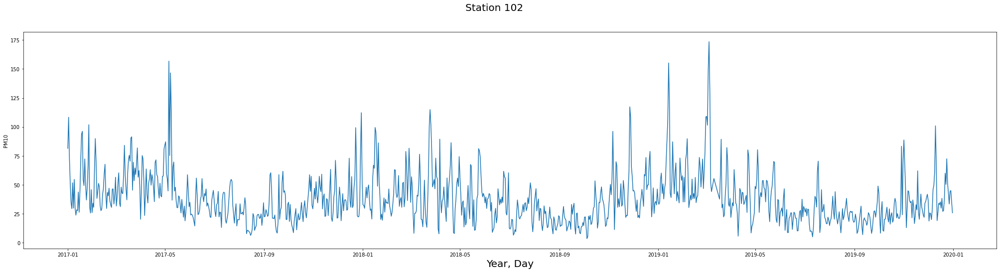

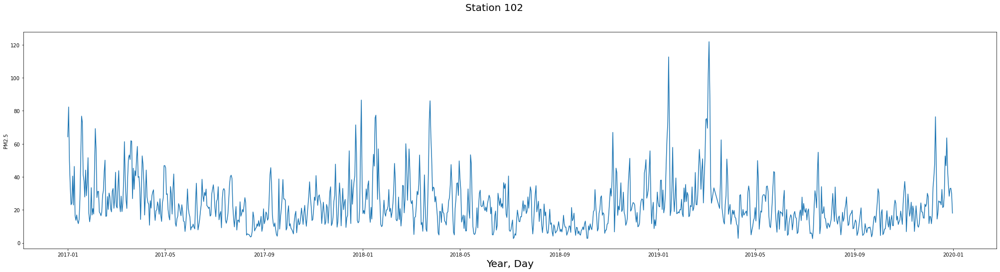

In [148]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 102", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_102)

##### So as seen above for Station 102
- NO2 reaches levels of 'Bad' on 21 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 48 occasions and 'Very Bad' on 4, can gets close to bad on many occasions.
- Lastly, PM2.5 reaches levels of 'Bad' on 147 occasions and 'Very Bad' on 12 occasions.
- Therefore, i will make a new df that only has those three pollutants since I am trying to test for pollutants that are deadly.

# Picking the relevant columns

In [149]:
columns = ['NO2', 'PM10', 'PM2.5']
df_102 = df_102[columns]
df_102

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.056667,81.416667,64.250000
2017-01-02,0.045250,108.291667,82.333333
2017-01-03,0.049083,72.916667,49.791667
2017-01-04,0.056667,50.958333,34.375000
2017-01-05,0.044833,34.666667,23.125000
...,...,...,...
2019-12-27,0.022667,33.333333,28.250000
2019-12-28,0.043792,44.000000,32.833333
2019-12-29,0.034958,44.958333,33.166667


# Train-Test Split

In [150]:
train = df_102[:-542]
test = df_102[542:]

<AxesSubplot:xlabel='Measurement date'>

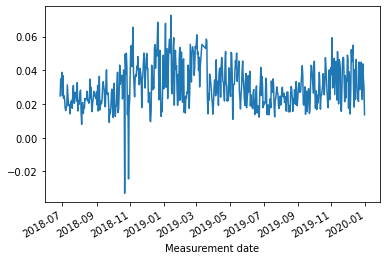

In [151]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

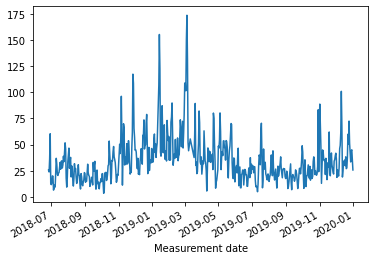

In [152]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

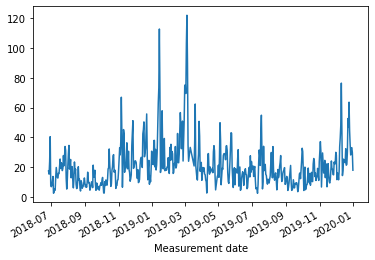

In [153]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

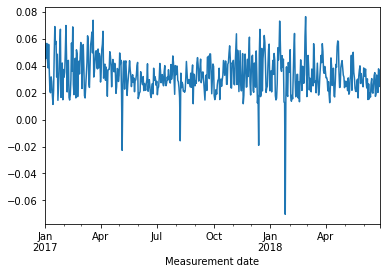

In [154]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

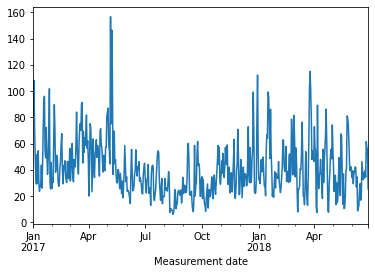

In [155]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

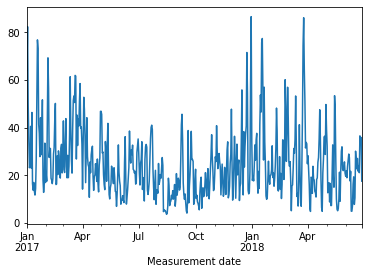

In [156]:
train['PM2.5'].plot()

In [157]:
print(stationarity_check(df_102['PM2.5']))
print(stationarity_check(df_102['PM10']))
print(stationarity_check(df_102['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -7.986390e+00
p-value                        2.542277e-12
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.749603e+00
p-value                        2.974213e-09
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)           -2.864227e+00
Critical Value (10%)          -2.568201e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -4.500309
p-value                           0.000196
#Lags Used                       17.000000
Number of Observations Used    1067.000000
Critical Value (1%)              -3.436493
Critical Value (5%)           

# Rolling Mean Difference Train¶

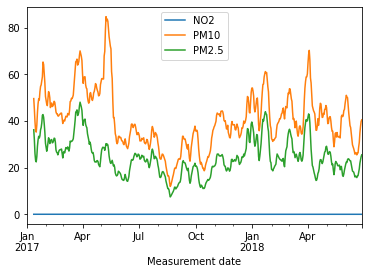

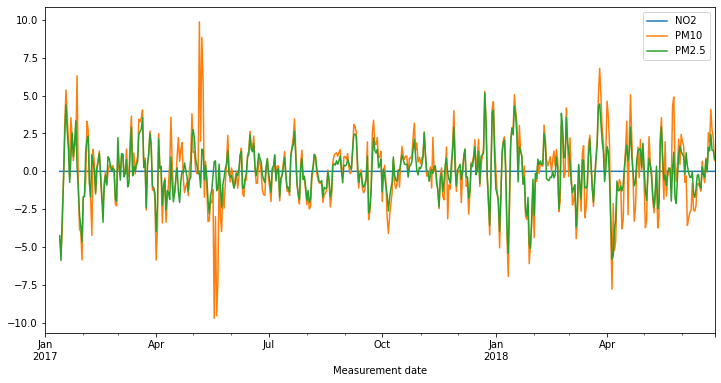

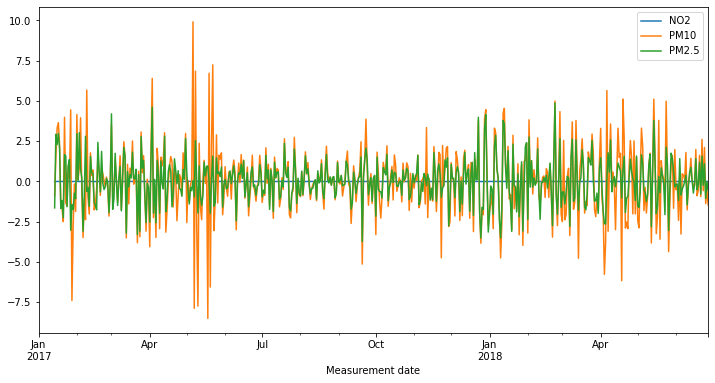

In [158]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [159]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.841801e+00
p-value                        5.909943e-12
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.381231e+00
p-value                        2.506934e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.940039e+00
p-value                        2.679423e-17
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [160]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.122836e+01
p-value                        1.935048e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.073226e+01
p-value                        2.959173e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.114692e+01
p-value                        3.010062e-20
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Test¶

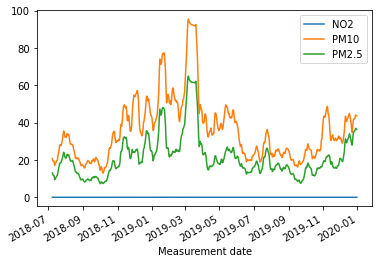

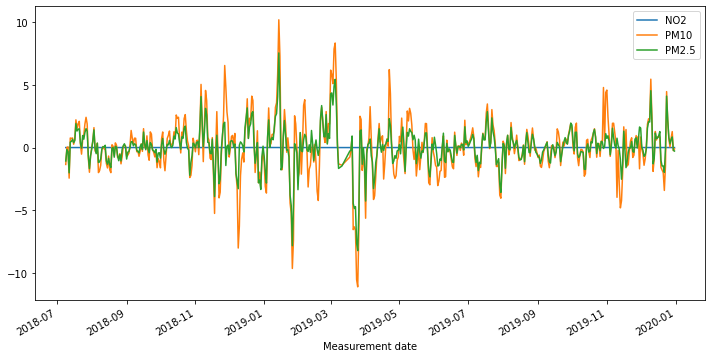

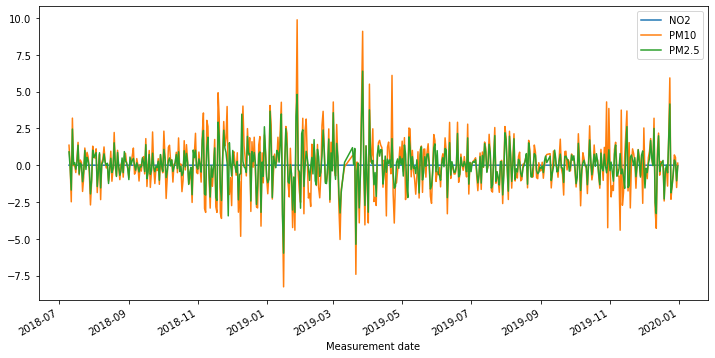

In [161]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [162]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.109808e+00
p-value                        9.392119e-08
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.600126
p-value                          0.000001
#Lags Used                      16.000000
Number of Observations Used    514.000000
Critical Value (1%)             -3.443136
Critical Value (5%)             -2.867179
Critical Value (10%)            -2.569774
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.672372e+00
p-value                        1.581161e-11
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158

In [163]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.802570e+00
p-value                        5.941216e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.154737e+01
p-value                        3.514499e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.053012e+01
p-value                        9.197947e-19
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 102 PM10

In [164]:
base_model = sm.tsa.statespace.SARIMAX(df_102['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4877.817
Date:                Mon, 18 Oct 2021   AIC                           9759.634
Time:                        11:06:39   BIC                           9769.612
Sample:                             0   HQIC                          9763.411
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     37.9718      0.851     44.595      0.000      36.303      39.641
sigma2       470.3562     14.201     33.120      0.000     442.522     498.190
Ljung-Box (L1) (Q):                 512.42   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9194.965, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11279.377, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9208.310, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10294.880, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9208.441, Time=0.11 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9065.247, Time=0.11 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=9894.008, Time=0.06 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9027.254, Time=0.23 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9028.026, Time=0.36 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9028.268, Time=0.24 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=9038.088, Time=0.17 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9029.957, Time=0.22 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=9029.286, Time=0.45 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=9021.489, Time=0.51 sec
 ARIMA(1,0,2)(0,0,0)[0] interce

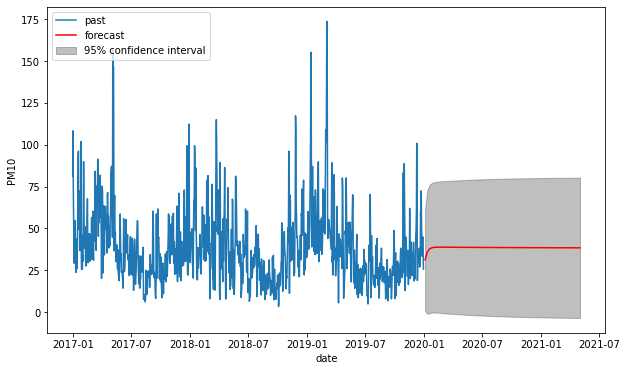

In [165]:
timeseries = df_102['PM10']
automodel = arimamodel(df_102['PM10'])
plotarima(70, timeseries, automodel)

In [166]:
best_model = sm.tsa.statespace.SARIMAX(df_102['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4504.745
Date:                Mon, 18 Oct 2021   AIC                           9021.489
Time:                        11:06:47   BIC                           9051.425
Sample:                             0   HQIC                          9032.822
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.4065      0.267      1.522      0.128      -0.117       0.930
ar.L1          1.3613      0.052     26.393      0.000       1.260       1.462
ar.L2         -0.3719      0.048     -7.797      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [167]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

Train RMSE: 16.27156562422011
Test RMSE: 28.775897078739177
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2284.086
Date:                Mon, 18 Oct 2021   AIC                           4580.173
Time:                        11:06:47   BIC                           4605.956
Sample:                    01-01-2017   HQIC                          4590.254
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         41.2074      5.283      7.801      0.000      30.854      51.561
ar.L1          1.3962      0.068     20.604      0.000       1

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 102 PM2.5

In [168]:
base_model = sm.tsa.statespace.SARIMAX(df_102['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4455.322
Date:                Mon, 18 Oct 2021   AIC                           8914.644
Time:                        11:06:47   BIC                           8924.623
Sample:                             0   HQIC                          8918.421
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     22.8691      0.600     38.098      0.000      21.693      24.046
sigma2       215.8747      6.356     33.961      0.000     203.416     228.333
Ljung-Box (L1) (Q):                 533.58   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8301.962, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10247.656, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8302.517, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9233.965, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8281.606, Time=0.10 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8303.452, Time=0.03 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8124.079, Time=0.19 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8219.717, Time=0.04 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8113.611, Time=0.29 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8208.971, Time=0.10 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8115.081, Time=0.43 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=8124.665, Time=0.52 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8113.501, Time=0.26 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=8111.700, Time=0.18 sec
 ARIMA(1,0,2)(0,0,0)[0]         

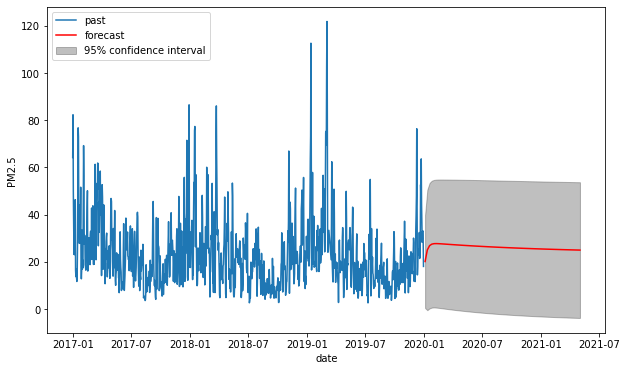

In [169]:
timeseries = df_102['PM2.5']
automodel = arimamodel(df_102['PM2.5'])
plotarima(70, timeseries, automodel)

In [170]:
best_model = sm.tsa.statespace.SARIMAX(df_102['PM2.5'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4046.362
Date:                Mon, 18 Oct 2021   AIC                           8104.724
Time:                        11:06:54   BIC                           8134.660
Sample:                             0   HQIC                          8116.057
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2596      0.179      1.452      0.147      -0.091       0.610
ar.L1          1.3625      0.051     26.751      0.000       1.263       1.462
ar.L2         -0.3735      0.047     -8.019      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [171]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

Train RMSE: 10.595628914329078
Test RMSE: 19.206907957110904
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2049.017
Date:                Mon, 18 Oct 2021   AIC                           4110.035
Time:                        11:06:54   BIC                           4135.817
Sample:                    01-01-2017   HQIC                          4120.116
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.4101      3.331      7.627      0.000      18.881      31.940
ar.L1          1.3635      0.070     19.582      0.000       

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 102 NO2

In [172]:
base_model = sm.tsa.statespace.SARIMAX(df_102['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                3155.444
Date:                Mon, 18 Oct 2021   AIC                          -6306.889
Time:                        11:06:55   BIC                          -6296.910
Sample:                             0   HQIC                         -6303.111
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0320      0.000     79.484      0.000       0.031       0.033
sigma2         0.0002    4.3e-06     40.560      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 203.05   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-6440.470, Time=0.18 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4219.576, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-6215.802, Time=0.06 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-5132.336, Time=0.08 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-6555.884, Time=0.27 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-6272.644, Time=0.05 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-6385.309, Time=0.27 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-6542.308, Time=0.28 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-6567.828, Time=0.22 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-5503.333, Time=0.15 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-6566.030, Time=0.38 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-5687.893, Time=0.18 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=inf, Time=0.45 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-6560.164, Time=0.45 sec

Best model:  ARIMA(1,0,2

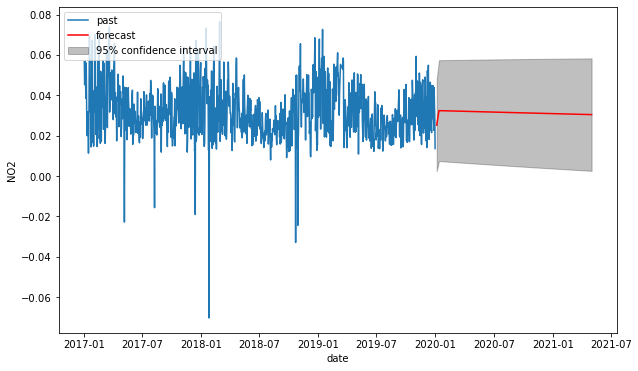

In [173]:
timeseries = df_102['NO2']
automodel = arimamodel(df_102['NO2'])
plotarima(70, timeseries, automodel)

In [174]:
best_model = sm.tsa.statespace.SARIMAX(df_102['NO2'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood                3285.082
Date:                Mon, 18 Oct 2021   AIC                          -6560.164
Time:                        11:06:58   BIC                          -6535.217
Sample:                             0   HQIC                         -6550.720
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0030      0.001      2.049      0.040       0.000       0.006
ar.L1          0.9037      0.046     19.647      0.000       0.814       0.994
ma.L1         -0.4584      0.052     -8.820      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [175]:
model_train = arima_results(train['NO2'],test['NO2'], order=[1,0,2])

Train RMSE: 0.012664950986851857
Test RMSE: 0.014194524001900998
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood                1602.015
Date:                Mon, 18 Oct 2021   AIC                          -3194.029
Time:                        11:06:58   BIC                          -3172.544
Sample:                    01-01-2017   HQIC                         -3185.628
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0334      0.001     38.048      0.000       0.032       0.035
ar.L1          0.5409      0.618      0.875      0.381   

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 103

In [176]:
df_103 = df[df['Station code'] == 103]

In [177]:
df_103['PM2.5 Level'].value_counts()

Normal      547
Good        348
Bad         172
Very Bad     18
Name: PM2.5 Level, dtype: int64

In [178]:
df_103.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,103,0.005042,0.039042,0.002500,1.112500,77.375000,73.125000,Good,Normal,Good,Good,Normal,Bad
2017-01-02,103,0.006083,0.036417,0.013083,0.979167,105.458333,96.666667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,103,0.005375,0.035792,0.012625,0.791667,64.958333,54.375000,Good,Normal,Good,Good,Normal,Bad
2017-01-04,103,0.005542,0.044167,0.006792,0.912500,49.208333,38.583333,Good,Normal,Good,Good,Normal,Bad
2017-01-05,103,0.004292,0.029792,0.013417,0.633333,28.791667,23.083333,Good,Good,Good,Good,Good,Normal


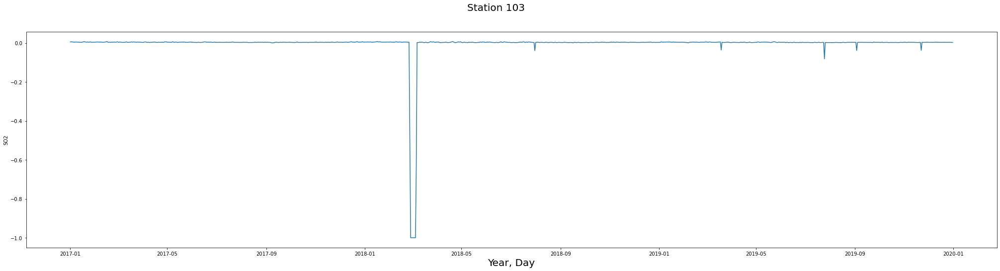

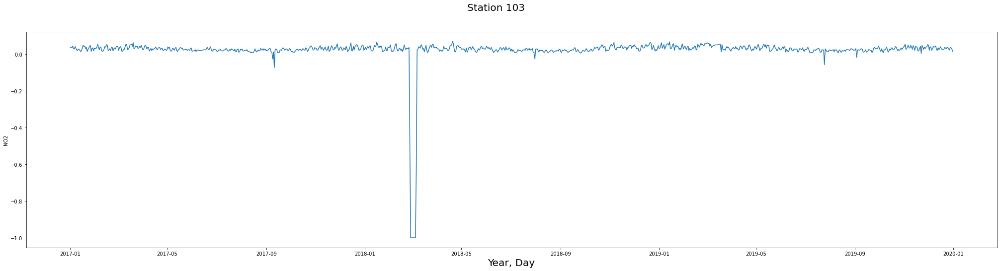

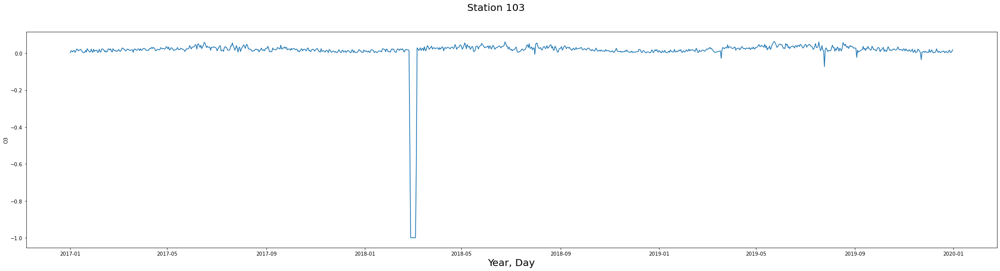

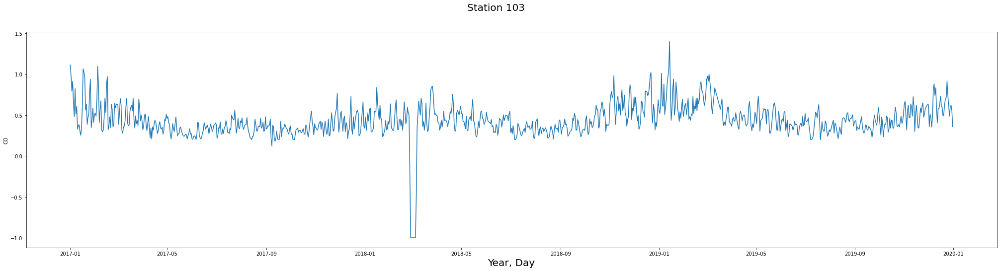

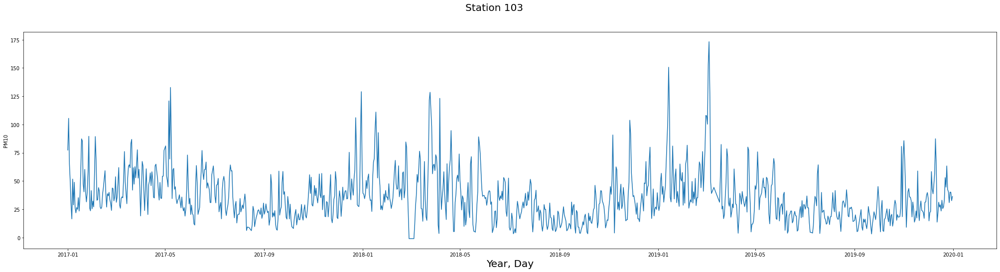

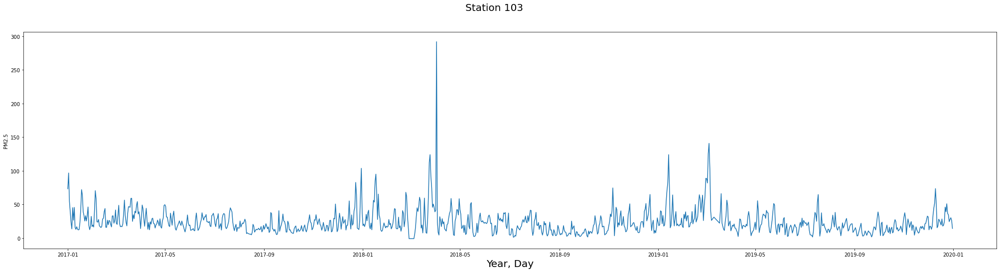

In [179]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 103", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_103)

##### So as seen above for Station 103
- NO2 reaches levels of 'Bad' on 12 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 43 occasions and 'Very Bad' on 3, can gets close to bad on many occasions.
- Lastly, PM2.5 reaches levels of 'Bad' on 172 occasions and 'Very Bad' on 12 occasions.
- Therefore, i will make a new df that only has those three pollutants since I am trying to test for pollutants that are deadly.

# Picking the relevant columns

In [180]:
columns = ['NO2', 'PM10', 'PM2.5']
df_103 = df_103[columns]
df_103

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.039042,77.375000,73.125000
2017-01-02,0.036417,105.458333,96.666667
2017-01-03,0.035792,64.958333,54.375000
2017-01-04,0.044167,49.208333,38.583333
2017-01-05,0.029792,28.791667,23.083333
...,...,...,...
2019-12-27,0.023208,30.875000,24.291667
2019-12-28,0.037375,40.166667,27.583333
2019-12-29,0.034917,40.083333,30.125000


In [181]:
train = df_103[:-542]
test = df_103[542:]

<AxesSubplot:xlabel='Measurement date'>

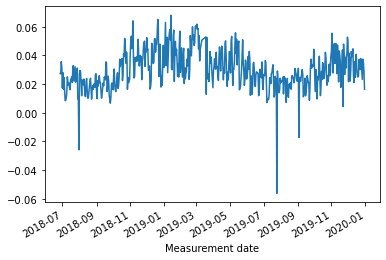

In [182]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

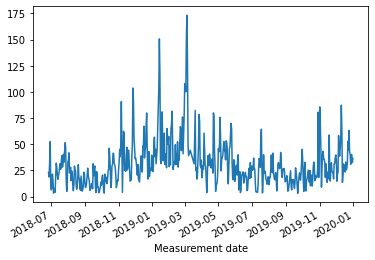

In [183]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

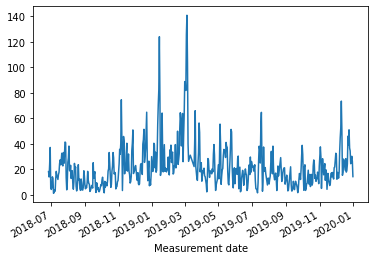

In [184]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

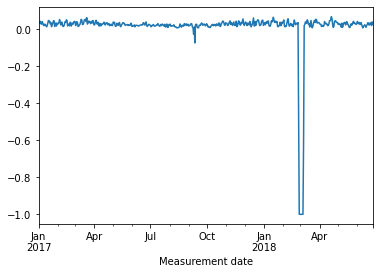

In [185]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

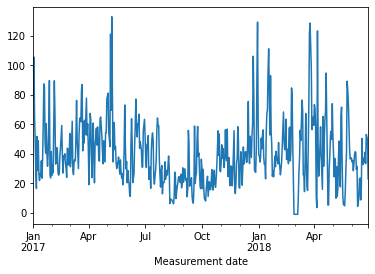

In [186]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

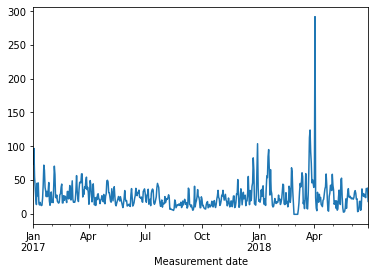

In [187]:
train['PM2.5'].plot()

In [188]:
print(stationarity_check(df_103['PM2.5']))
print(stationarity_check(df_103['PM10']))
print(stationarity_check(df_103['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -7.411134e+00
p-value                        7.129268e-11
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)           -2.864227e+00
Critical Value (10%)          -2.568201e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.548150e+00
p-value                        3.241951e-11
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.318872e+00
p-value                        3.101505e-08
#Lags Used                     1.600000e+01
Number of Observations Used    1.068000e+03
Critical Value (1%)           -3.436488e+00
Critical Value (5%)      

# Rolling Mean Difference Train

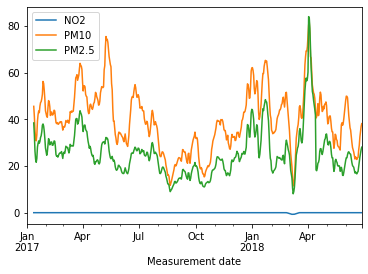

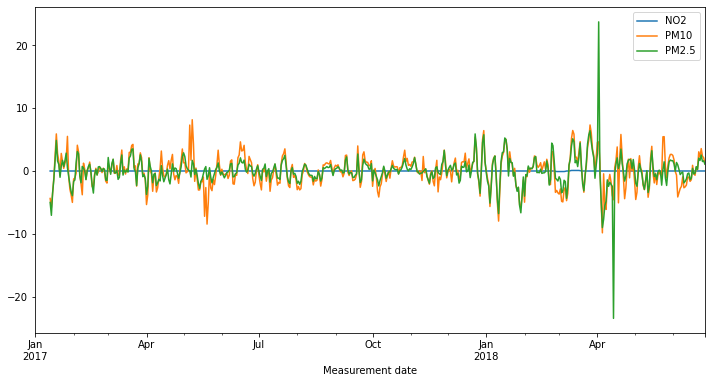

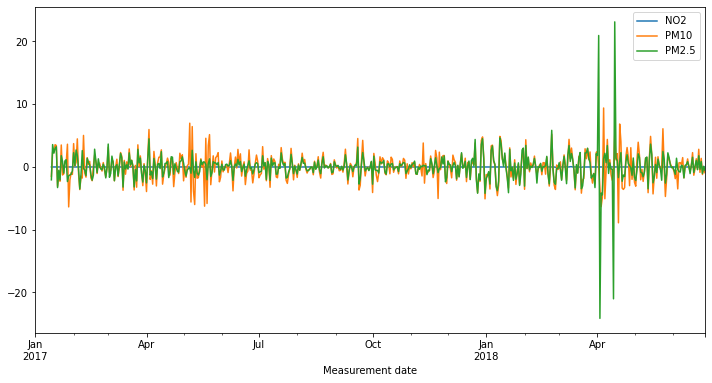

In [189]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [190]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -8.345997e+00
p-value                        3.084407e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.431747e+00
p-value                        6.334019e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.390587e+00
p-value                        8.020445e-11
#Lags Used                     1.800000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

In [191]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.027163e+01
p-value                        3.987534e-18
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.049441e+01
p-value                        1.125250e-18
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.619943e+00
p-value                        6.143749e-14
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Test

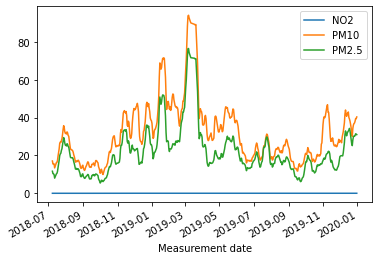

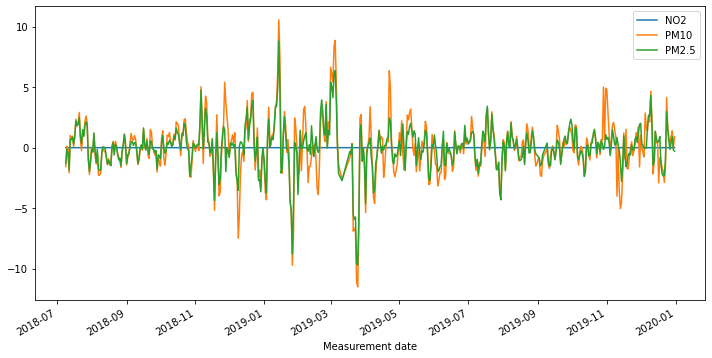

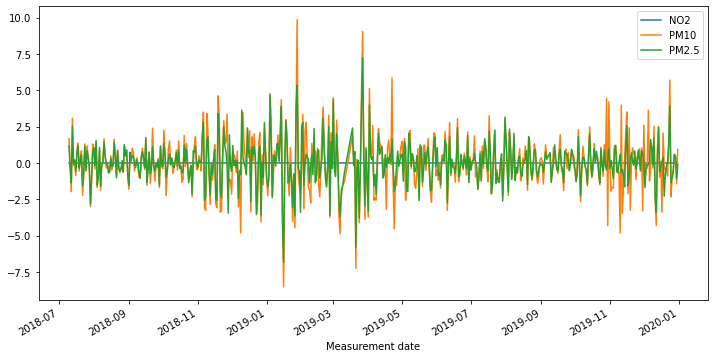

In [192]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [193]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.124007e+00
p-value                        8.717235e-08
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.575190
p-value                          0.000001
#Lags Used                      16.000000
Number of Observations Used    514.000000
Critical Value (1%)             -3.443136
Critical Value (5%)             -2.867179
Critical Value (10%)            -2.569774
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.852733e+00
p-value                        1.678151e-09
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158

In [194]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.673678e+00
p-value                        1.257247e-16
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.160972e+01
p-value                        2.530270e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.036650e+01
p-value                        2.322966e-18
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

# Station 103 PM10

In [195]:
base_model = sm.tsa.statespace.SARIMAX(df_103['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4912.484
Date:                Mon, 18 Oct 2021   AIC                           9828.967
Time:                        11:07:02   BIC                           9838.946
Sample:                             0   HQIC                          9832.745
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     35.5386      0.862     41.217      0.000      33.849      37.229
sigma2       501.3940     15.730     31.874      0.000     470.563     532.225
Ljung-Box (L1) (Q):                 529.51   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9231.692, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11192.077, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9233.873, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10220.762, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9229.247, Time=0.11 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9233.780, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9070.888, Time=0.20 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9183.380, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=9070.354, Time=0.25 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=9162.959, Time=0.09 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=9072.266, Time=0.43 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=9068.679, Time=0.32 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9070.472, Time=0.34 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=inf, Time=0.67 sec
 ARIMA(4,0,3)(0,0,0)[0]             

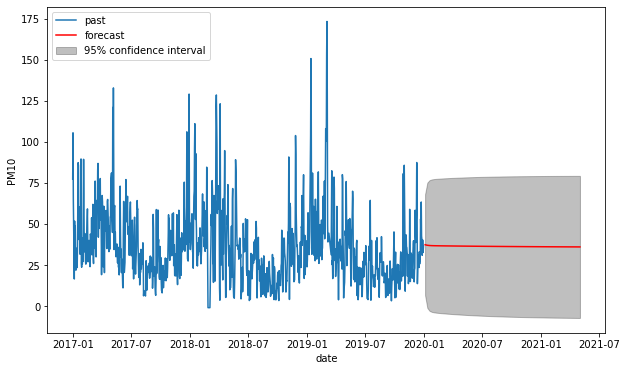

In [196]:
timeseries = df_103['PM10']
automodel = arimamodel(df_103['PM10'])
plotarima(70, timeseries, automodel)

In [197]:
best_model = sm.tsa.statespace.SARIMAX(df_103['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4524.984
Date:                Mon, 18 Oct 2021   AIC                           9061.969
Time:                        11:07:12   BIC                           9091.905
Sample:                             0   HQIC                          9073.301
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3957      0.266      1.486      0.137      -0.126       0.917
ar.L1          1.4025      0.047     29.628      0.000       1.310       1.495
ar.L2         -0.4136      0.043     -9.659      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [198]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 16.750687590611005
Test RMSE: 29.070477678727006
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2300.057
Date:                Mon, 18 Oct 2021   AIC                           4612.114
Time:                        11:07:12   BIC                           4637.896
Sample:                    01-01-2017   HQIC                          4622.195
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         40.0061      2.382     16.793      0.000      35.337      44.675
ar.L1         -0.3063      0.101     -3.036      0.002      -

# Station 103 PM2.5

In [199]:
base_model = sm.tsa.statespace.SARIMAX(df_103['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4718.790
Date:                Mon, 18 Oct 2021   AIC                           9441.580
Time:                        11:07:12   BIC                           9451.558
Sample:                             0   HQIC                          9445.357
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     23.6768      0.738     32.098      0.000      22.231      25.122
sigma2       350.8480      4.123     85.101      0.000     342.768     358.928
Ljung-Box (L1) (Q):                 383.76   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9092.030, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10475.397, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9123.435, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9759.316, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8960.822, Time=0.19 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9108.742, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8958.563, Time=0.18 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9075.323, Time=0.07 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8960.321, Time=0.29 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=inf, Time=0.33 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=8958.485, Time=0.16 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=8987.659, Time=0.11 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=8960.414, Time=0.33 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=8960.444, Time=0.09 sec
 ARIMA(3,0,3)(0,0,0)[0]             :

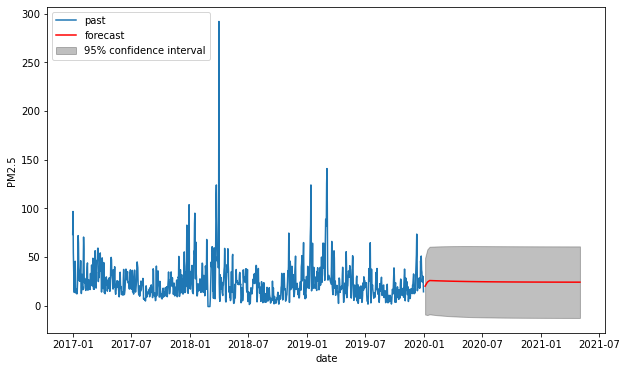

In [200]:
timeseries = df_103['PM2.5']
automodel = arimamodel(df_103['PM2.5'])
plotarima(70, timeseries, automodel)

In [201]:
best_model = sm.tsa.statespace.SARIMAX(df_103['PM2.5'], trend='c', order=[1,0,3])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(1, 0, 3)   Log Likelihood               -4467.338
Date:                Mon, 18 Oct 2021   AIC                           8946.676
Time:                        11:07:20   BIC                           8976.612
Sample:                             0   HQIC                          8958.009
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      1.1994      0.635      1.890      0.059      -0.044       2.443
ar.L1          0.9500      0.025     37.626      0.000       0.901       0.999
ma.L1         -0.3639      0.032    -11.369      0.0

In [202]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])


/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 17.54750911911633
Test RMSE: 21.227807425953497
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2325.387
Date:                Mon, 18 Oct 2021   AIC                           4662.775
Time:                        11:07:20   BIC                           4688.557
Sample:                    01-01-2017   HQIC                          4672.856
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         26.1446      3.650      7.163      0.000      18.990      33.299
ar.L1          1.3018      0.168      7.754      0.000       0

# Station 103 NO2

In [203]:
base_model = sm.tsa.statespace.SARIMAX(df_103['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                1110.972
Date:                Mon, 18 Oct 2021   AIC                          -2217.945
Time:                        11:07:20   BIC                          -2207.966
Sample:                             0   HQIC                         -2214.167
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0219      0.014      1.588      0.112      -0.005       0.049
sigma2         0.0076      0.000     35.424      0.000       0.007       0.008
Ljung-Box (L1) (Q):                 928.70   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-4538.639, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-2153.401, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-4298.166, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-3341.217, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-4539.213, Time=0.20 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-4514.076, Time=0.07 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-4541.212, Time=0.17 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-4524.763, Time=0.09 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-4555.255, Time=0.39 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-4551.804, Time=0.04 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-4547.987, Time=0.34 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=-4553.209, Time=0.45 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-4537.018, Time=0.43 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-4550.683, Time=0.16 sec
 ARIMA(5,0,2)(0,0,0

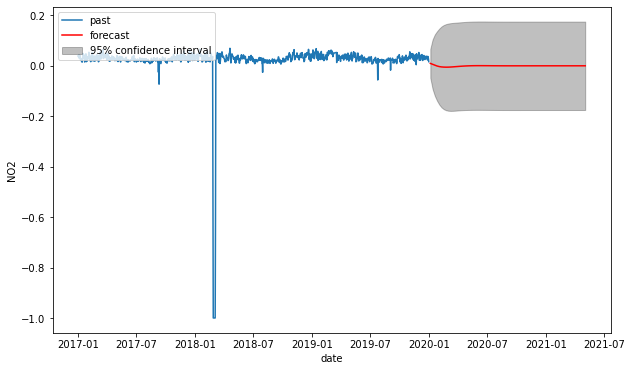

In [204]:
timeseries = df_103['NO2']
automodel = arimamodel(df_103['NO2'])
plotarima(70, timeseries, automodel)

In [205]:
best_model = sm.tsa.statespace.SARIMAX(df_103['NO2'], trend='c', order=[4,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packa

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(4, 0, 2)   Log Likelihood                2281.700
Date:                Mon, 18 Oct 2021   AIC                          -4547.401
Time:                        11:07:24   BIC                          -4507.486
Sample:                             0   HQIC                         -4532.290
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0069      0.004      1.667      0.096      -0.001       0.015
ar.L1          0.4777      0.075      6.341      0.000       0.330       0.625
ar.L2          0.0697      0.086      0.813      0.4

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [206]:
model_train = arima_results(train['NO2'],test['NO2'], order=[4,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 0.03873285618580366
Test RMSE: 0.11640928285061776
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(4, 0, 2)   Log Likelihood                 993.655
Date:                Mon, 18 Oct 2021   AIC                          -1971.310
Time:                        11:07:25   BIC                          -1936.933
Sample:                    01-01-2017   HQIC                         -1957.868
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0143      0.036      0.402      0.688      -0.056       0.084
ar.L1          0.7515      0.078      9.625      0.000     

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 104

In [207]:
df_104 = df[df['Station code'] == 104]

In [208]:
df_104['PM2.5 Level'].value_counts()

Normal      576
Good        307
Bad         183
Very Bad     19
Name: PM2.5 Level, dtype: int64

In [209]:
df_104.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,104,0.005958,0.041708,0.005458,0.708333,70.291667,45.541667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,104,0.006500,0.037333,0.019750,0.520833,102.416667,73.458333,Good,Normal,Good,Good,Bad,Bad
2017-01-03,104,0.005333,0.038292,0.016167,0.262500,73.625000,46.875000,Good,Normal,Good,Good,Normal,Bad
2017-01-04,104,0.004750,0.033625,0.006375,0.537500,46.333333,29.041667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,104,0.003917,0.014083,0.008833,0.625000,32.083333,20.041667,Good,Good,Good,Good,Normal,Normal


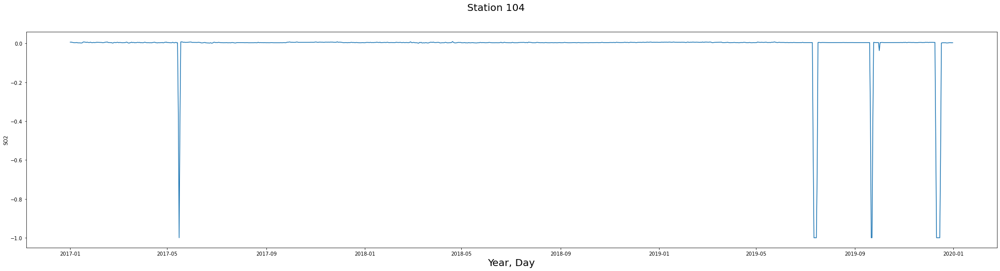

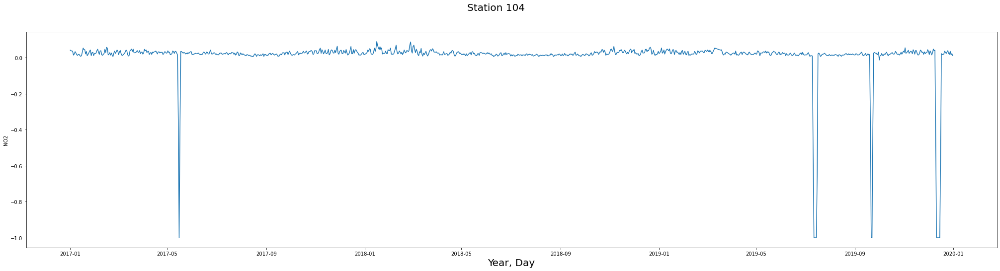

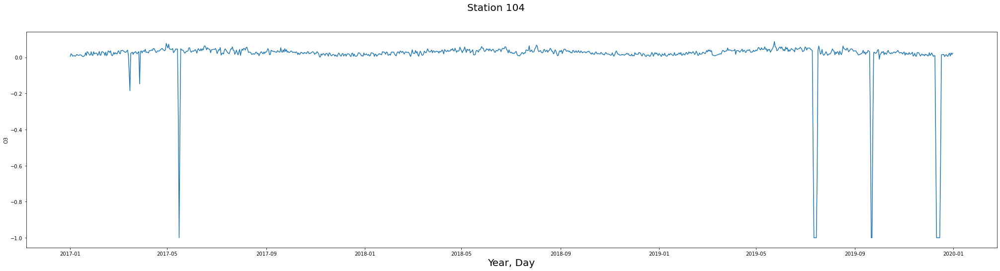

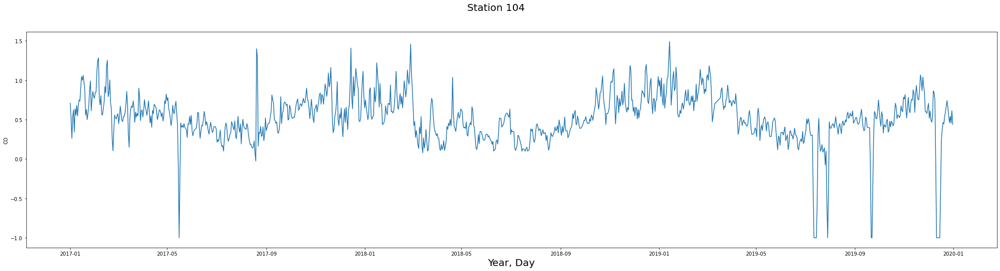

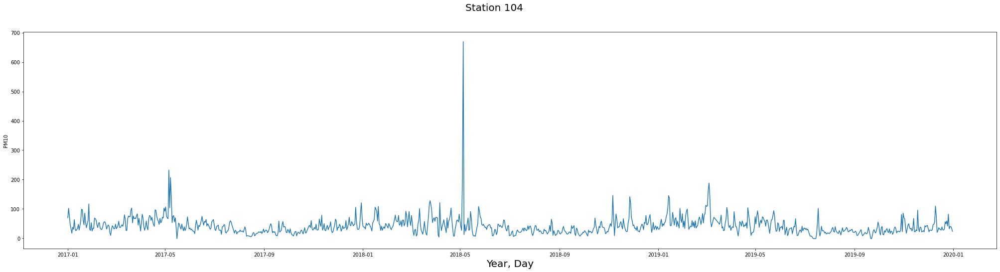

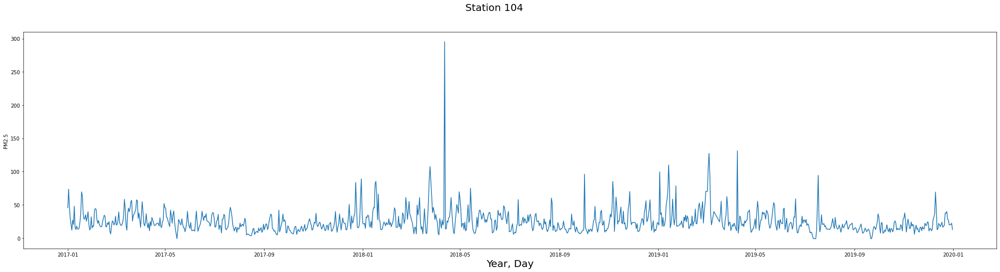

In [210]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 104", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_104)

##### So as seen above for Station 104
- NO2 reaches levels of 'Bad' on 11 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 69 occasions and 'Very Bad' on 5, can gets close to bad on many occasions.
- Lastly, PM2.5 reaches levels of 'Bad' on 183 occasions and 'Very Bad' on 19 occasions.
- Therefore, i will make a new df that only has those three pollutants since I am trying to test for pollutants that are deadly.

# Picking the relevant columns

In [211]:
columns = ['NO2', 'PM10', 'PM2.5']
df_104 = df_104[columns]
df_104

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.041708,70.291667,45.541667
2017-01-02,0.037333,102.416667,73.458333
2017-01-03,0.038292,73.625000,46.875000
2017-01-04,0.033625,46.333333,29.041667
2017-01-05,0.014083,32.083333,20.041667
...,...,...,...
2019-12-27,0.018250,32.583333,19.541667
2019-12-28,0.035458,40.250000,19.958333
2019-12-29,0.015167,40.083333,20.166667


# Train-Test Split

In [212]:
train = df_104[:-542]
test = df_104[542:]

<AxesSubplot:xlabel='Measurement date'>

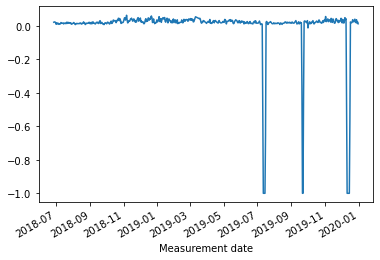

In [213]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

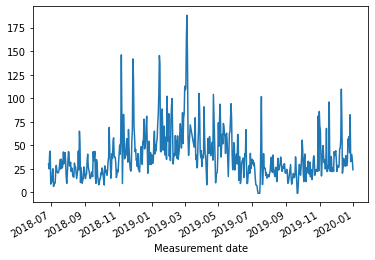

In [214]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

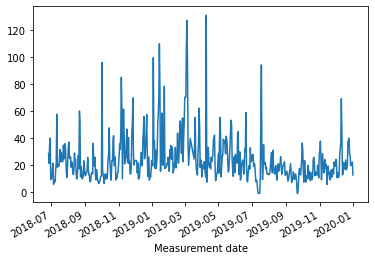

In [215]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

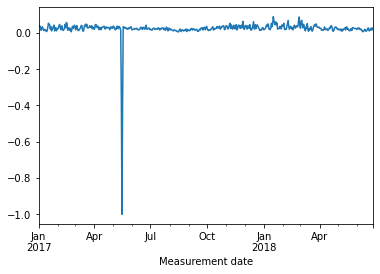

In [216]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

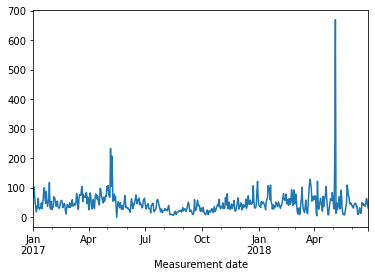

In [217]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

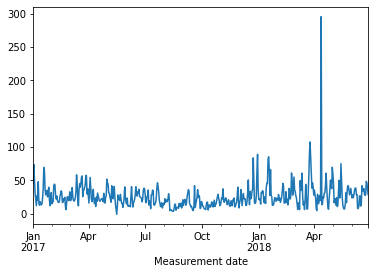

In [218]:
train['PM2.5'].plot()

In [219]:
print(stationarity_check(df_101['PM2.5']))
print(stationarity_check(df_101['PM10']))
print(stationarity_check(df_101['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                   -5.321631
p-value                           0.000005
#Lags Used                       13.000000
Number of Observations Used    1071.000000
Critical Value (1%)              -3.436470
Critical Value (5%)              -2.864242
Critical Value (10%)             -2.568209
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -5.915741e+00
p-value                        2.575463e-07
#Lags Used                     1.000000e+01
Number of Observations Used    1.074000e+03
Critical Value (1%)           -3.436453e+00
Critical Value (5%)           -2.864235e+00
Critical Value (10%)          -2.568205e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.508201e+00
p-value                        1.117369e-08
#Lags Used                     1.300000e+01
Number of Observations Used    1.071000e+03
Critical Value (1%)           -3.436470e+00
Critical Value (5%)           -2

# Rolling Mean Difference Train

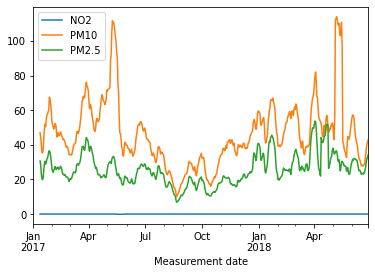

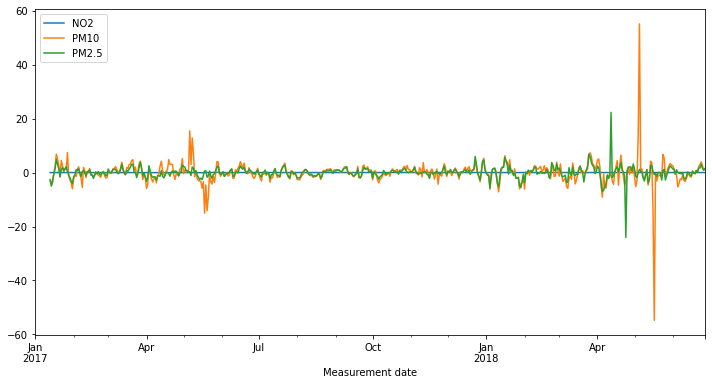

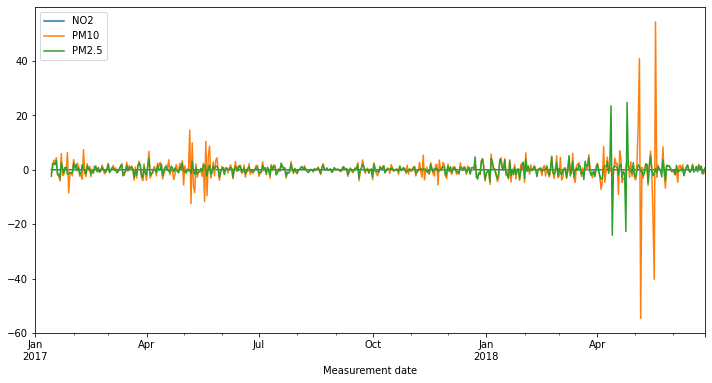

In [220]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = train.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [221]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                  -5.504779
p-value                          0.000002
#Lags Used                      17.000000
Number of Observations Used    513.000000
Critical Value (1%)             -3.443162
Critical Value (5%)             -2.867190
Critical Value (10%)            -2.569780
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.528517e+00
p-value                        2.933312e-16
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.565407e+00
p-value                        2.934753e-11
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158

In [222]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.223571e+01
p-value                        1.029336e-22
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.079593e+01
p-value                        2.075629e-19
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.782352e+00
p-value                        6.681332e-17
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Train

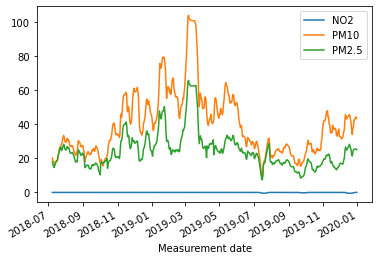

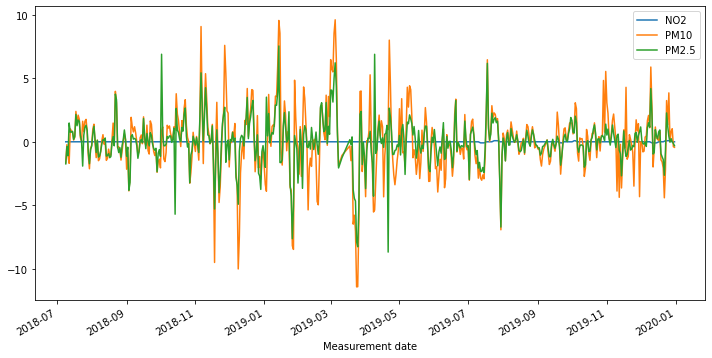

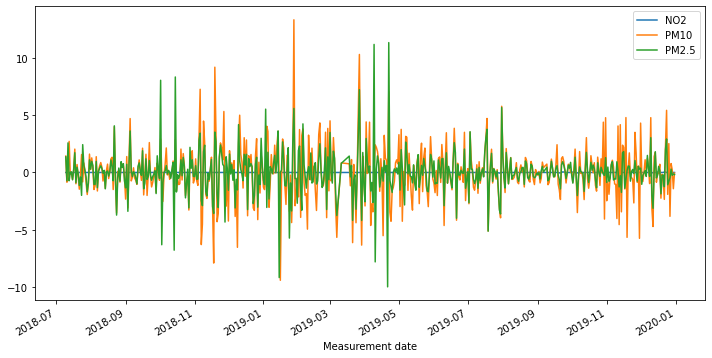

In [223]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = test.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [224]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.645853e+00
p-value                        1.843578e-11
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -5.817129e+00
p-value                        4.266569e-07
#Lags Used                     1.600000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.532628e+00
p-value                        9.783572e-09
#Lags Used                     1.800000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

In [225]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.690993e+00
p-value                        1.136635e-16
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.032529e+01
p-value                        2.936650e-18
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.405230e+00
p-value                        2.176707e-13
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Station 104 PM10

In [226]:
base_model = sm.tsa.statespace.SARIMAX(df_104['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5308.444
Date:                Mon, 18 Oct 2021   AIC                          10620.887
Time:                        11:07:29   BIC                          10630.866
Sample:                             0   HQIC                         10624.665
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     42.3415      1.315     32.211      0.000      39.765      44.918
sigma2      1040.3084      7.303    142.449      0.000    1025.995    1054.622
Ljung-Box (L1) (Q):                 254.83   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10400.684, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11705.904, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10548.150, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=11084.325, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=10296.478, Time=0.16 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=10495.992, Time=0.02 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=10297.306, Time=0.19 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=10297.144, Time=0.19 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=10302.740, Time=0.15 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=10441.045, Time=0.04 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=10298.923, Time=0.41 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=10290.198, Time=0.40 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=10330.414, Time=0.16 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=10332.634, Time=0.09 sec
 ARIMA(3,0,1)(0,0,0

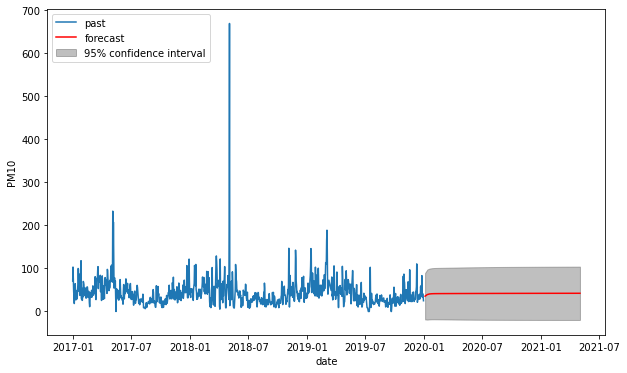

In [227]:
timeseries = df_104['PM10']
automodel = arimamodel(df_104['PM10'])
plotarima(70, timeseries, automodel)

In [228]:
best_model = sm.tsa.statespace.SARIMAX(df_104['PM10'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -5140.099
Date:                Mon, 18 Oct 2021   AIC                          10290.198
Time:                        11:07:33   BIC                          10315.145
Sample:                             0   HQIC                         10299.642
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.5448      0.507      1.074      0.283      -0.449       1.539
ar.L1          1.3337      0.033     40.828      0.000       1.270       1.398
ar.L2         -0.3468      0.023    -15.063      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [229]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,1])

Train RMSE: 34.36782712545945
Test RMSE: 33.00942447490371
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood               -2691.241
Date:                Mon, 18 Oct 2021   AIC                           5392.481
Time:                        11:07:34   BIC                           5413.967
Sample:                    01-01-2017   HQIC                          5400.882
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         46.3364     10.478      4.422      0.000      25.800      66.872
ar.L1          1.2789      0.065     19.758      0.000       1.

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

# Station 104 PM2.5

In [230]:
base_model = sm.tsa.statespace.SARIMAX(df_104['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4670.783
Date:                Mon, 18 Oct 2021   AIC                           9345.566
Time:                        11:07:34   BIC                           9355.545
Sample:                             0   HQIC                          9349.344
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     24.9032      0.706     35.271      0.000      23.519      26.287
sigma2       321.1350      3.467     92.619      0.000     314.339     327.931
Ljung-Box (L1) (Q):                 220.48   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9213.809, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10510.379, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9342.470, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9889.253, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9085.396, Time=0.20 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9288.021, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9087.052, Time=0.18 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9087.009, Time=0.19 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9097.682, Time=0.13 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9239.360, Time=0.06 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9089.085, Time=0.27 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=9086.131, Time=0.41 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 1.625 seconds


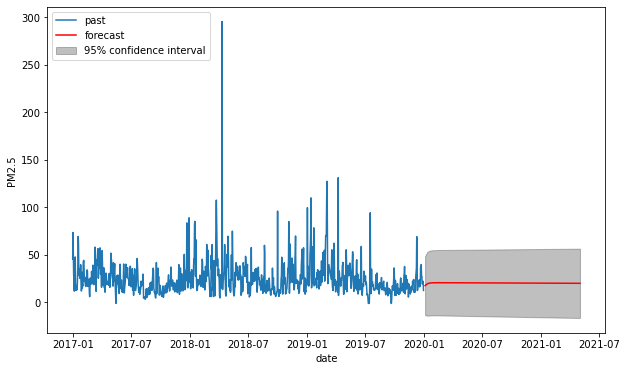

In [231]:
timeseries = df_104['PM2.5']
automodel = arimamodel(df_104['PM2.5'])
plotarima(70, timeseries, automodel)

In [232]:
best_model = sm.tsa.statespace.SARIMAX(df_104['PM2.5'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -4538.065
Date:                Mon, 18 Oct 2021   AIC                           9086.131
Time:                        11:07:36   BIC                           9111.078
Sample:                             0   HQIC                          9095.575
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.7807      0.597      1.308      0.191      -0.389       1.951
ar.L1          1.3201      0.048     27.590      0.000       1.226       1.414
ar.L2         -0.3525      0.026    -13.551      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [233]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 17.34375622135541
Test RMSE: 19.07776514700495
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2319.767
Date:                Mon, 18 Oct 2021   AIC                           4651.535
Time:                        11:07:36   BIC                           4677.317
Sample:                    01-01-2017   HQIC                          4661.616
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.9980      2.169     11.987      0.000      21.747      30.249
ar.L1          0.1034      1.505      0.069      0.945      -2.

# Station 104 PM NO2

In [234]:
base_model = sm.tsa.statespace.SARIMAX(df_104['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                 799.222
Date:                Mon, 18 Oct 2021   AIC                          -1594.444
Time:                        11:07:36   BIC                          -1584.466
Sample:                             0   HQIC                         -1590.667
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0098      0.017      0.587      0.557      -0.023       0.043
sigma2         0.0134      0.000     28.022      0.000       0.012       0.014
Ljung-Box (L1) (Q):                 779.96   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-3350.962, Time=0.12 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-1588.650, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-2961.825, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-2715.432, Time=0.07 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-3355.378, Time=0.25 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-3234.010, Time=0.06 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-3353.498, Time=0.20 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-3354.193, Time=0.28 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-3355.694, Time=0.14 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-3150.691, Time=0.15 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-3353.755, Time=0.21 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-3291.403, Time=0.12 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-3353.037, Time=0.34 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-3354.981, Time=0.18 sec

Best model:  ARIMA

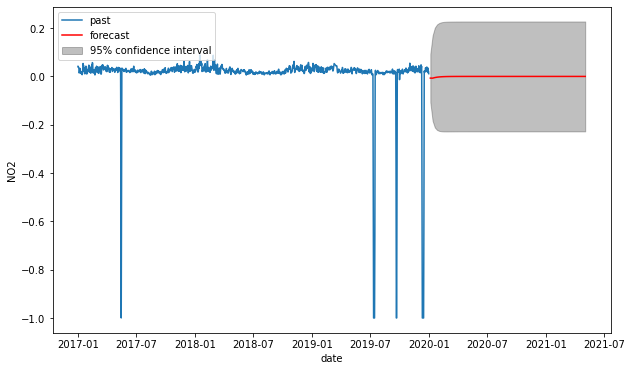

In [235]:
timeseries = df_104['NO2']
automodel = arimamodel(df_104['NO2'])
plotarima(70, timeseries, automodel)

In [236]:
best_model = sm.tsa.statespace.SARIMAX(df_104['NO2'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood                1682.490
Date:                Mon, 18 Oct 2021   AIC                          -3354.981
Time:                        11:07:39   BIC                          -3330.034
Sample:                             0   HQIC                         -3345.537
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0033      0.006      0.587      0.557      -0.008       0.015
ar.L1          0.6603      0.012     53.450      0.000       0.636       0.684
ma.L1          0.7802      0.011     68.206      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


In [237]:
model_train = arima_results(train['NO2'],test['NO2'], order=[1,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 0.036924614621430416
Test RMSE: 0.16067075439030037
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood                1020.360
Date:                Mon, 18 Oct 2021   AIC                          -2030.720
Time:                        11:07:39   BIC                          -2009.234
Sample:                    01-01-2017   HQIC                         -2022.319
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0231      0.009      2.625      0.009       0.006       0.040
ar.L1          0.0165      0.144      0.115      0.909    

# Station 105

In [238]:
df_105 = df[df['Station code'] == 105]

In [239]:
df_105['PM2.5 Level'].value_counts()

Normal      489
Good        396
Bad         186
Very Bad     14
Name: PM2.5 Level, dtype: int64

In [240]:
df_105.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,105,0.005250,0.038500,0.007625,0.783333,91.291667,49.541667,Good,Normal,Good,Good,Bad,Bad
2017-01-02,105,0.005625,0.032708,0.020208,0.741667,126.333333,64.291667,Good,Normal,Good,Good,Bad,Bad
2017-01-03,105,0.006250,0.033292,0.016417,0.683333,90.291667,40.166667,Good,Normal,Good,Good,Bad,Bad
2017-01-04,105,0.006000,0.040000,0.013167,0.783333,60.458333,32.166667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,105,0.005292,0.025917,0.021042,0.591667,27.333333,17.541667,Good,Good,Good,Good,Good,Normal


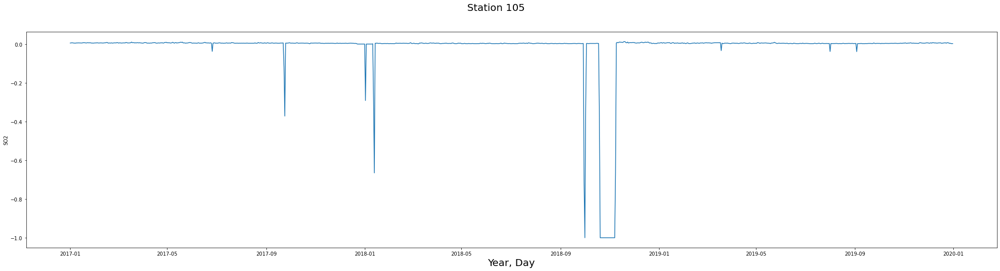

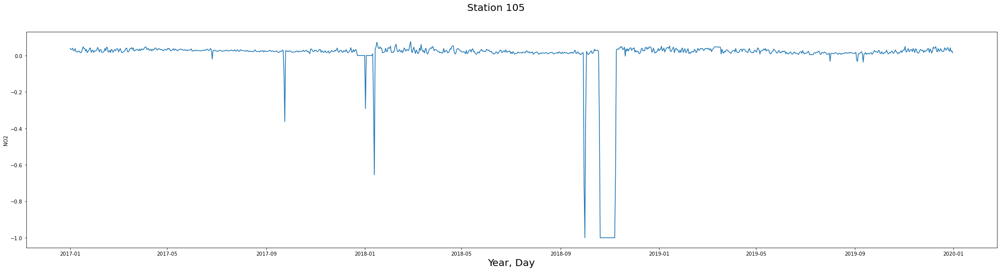

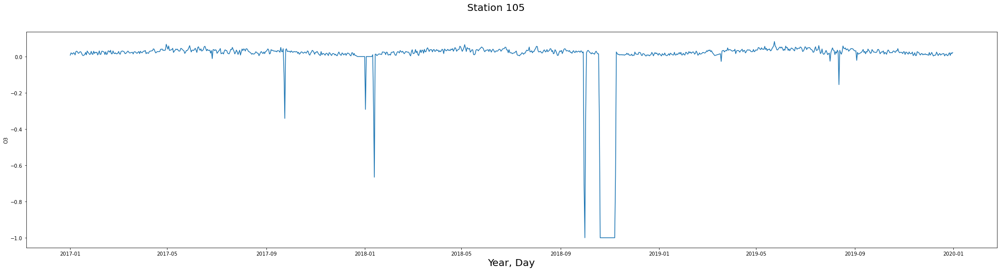

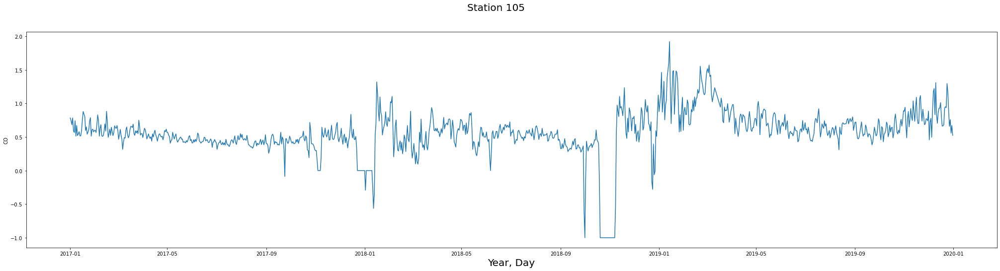

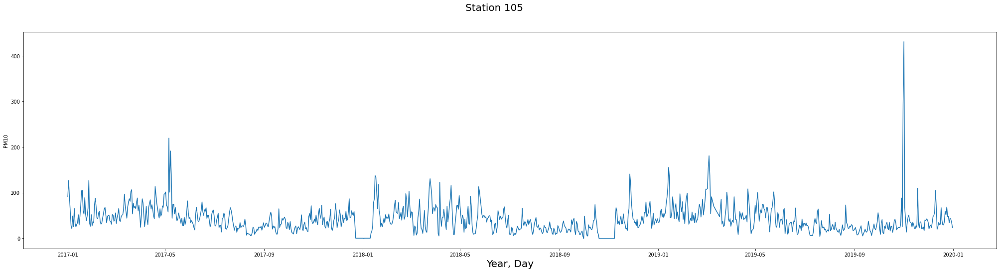

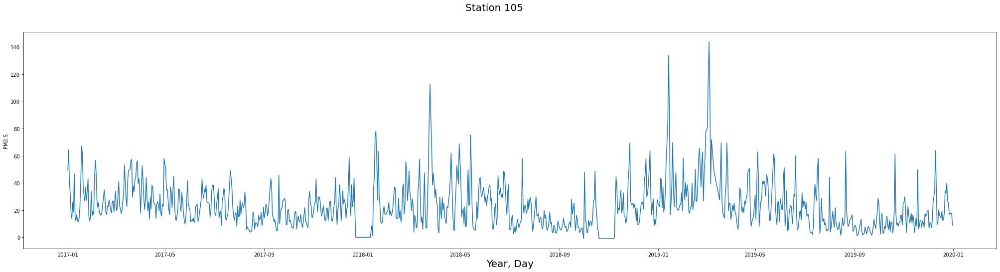

In [241]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 105", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_105)

##### So as seen above for Station 105
- NO2 reaches levels of 'Bad' on 4 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 77 occasions and 'Very Bad' on 7, can gets close to bad on many occasions.
- Lastly, PM2.5 reaches levels of 'Bad' on 187 occasions and 'Very Bad' on 14 occasions.
- Therefore, i will make a new df that only has those three pollutants since I am trying to test for pollutants that are deadly.

# Picking the relevant columns

In [242]:
columns = ['NO2', 'PM10', 'PM2.5']
df_105 = df_105[columns]
df_105

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.038500,91.291667,49.541667
2017-01-02,0.032708,126.333333,64.291667
2017-01-03,0.033292,90.291667,40.166667
2017-01-04,0.040000,60.458333,32.166667
2017-01-05,0.025917,27.333333,17.541667
...,...,...,...
2019-12-27,0.023375,33.666667,16.875000
2019-12-28,0.042125,43.916667,17.708333
2019-12-29,0.022042,41.250000,17.041667


# Train-Test Split

In [243]:
train = df_105[:-542]
test = df_105[542:]

<AxesSubplot:xlabel='Measurement date'>

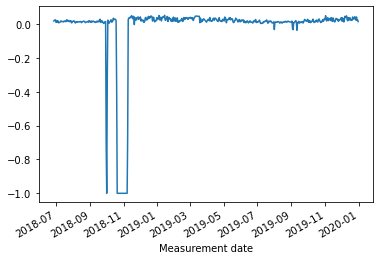

In [244]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

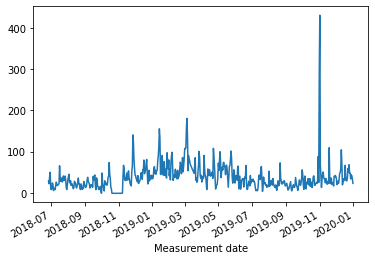

In [245]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

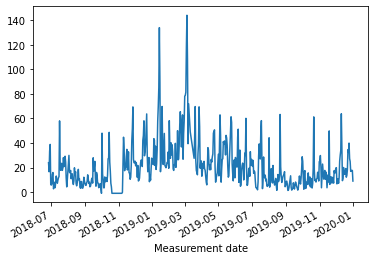

In [246]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

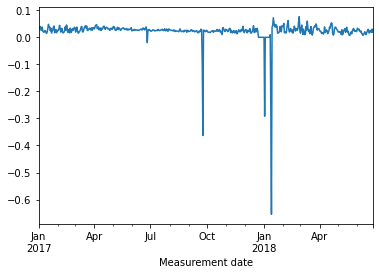

In [247]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

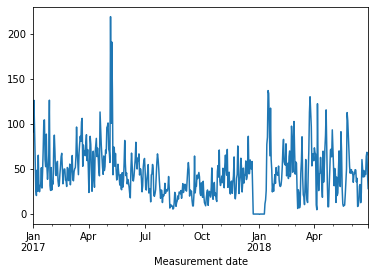

In [248]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

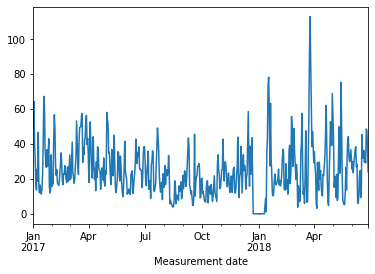

In [249]:
train['PM2.5'].plot()

In [250]:
print(stationarity_check(df_101['PM2.5']))
print(stationarity_check(df_101['PM10']))
print(stationarity_check(df_101['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                   -5.321631
p-value                           0.000005
#Lags Used                       13.000000
Number of Observations Used    1071.000000
Critical Value (1%)              -3.436470
Critical Value (5%)              -2.864242
Critical Value (10%)             -2.568209
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -5.915741e+00
p-value                        2.575463e-07
#Lags Used                     1.000000e+01
Number of Observations Used    1.074000e+03
Critical Value (1%)           -3.436453e+00
Critical Value (5%)           -2.864235e+00
Critical Value (10%)          -2.568205e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.508201e+00
p-value                        1.117369e-08
#Lags Used                     1.300000e+01
Number of Observations Used    1.071000e+03
Critical Value (1%)           -3.436470e+00
Critical Value (5%)           -2

# Rolling Mean Difference Train

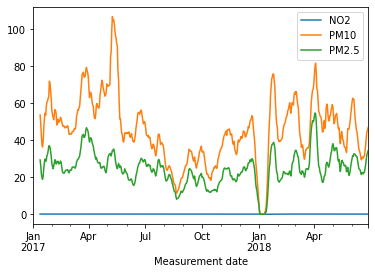

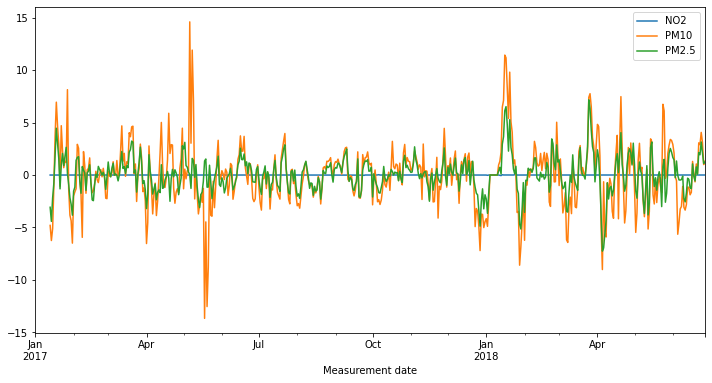

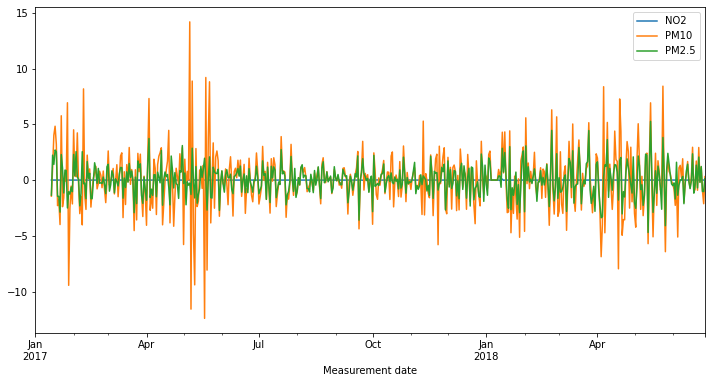

In [251]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [252]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.387981e+00
p-value                        8.141118e-11
#Lags Used                     1.900000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.265591e+00
p-value                        4.948491e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.675165e+00
p-value                        1.555790e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [253]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.013643e+01
p-value                        8.645008e-18
#Lags Used                     1.400000e+01
Number of Observations Used    5.150000e+02
Critical Value (1%)           -3.443112e+00
Critical Value (5%)           -2.867168e+00
Critical Value (10%)          -2.569768e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.006366e+01
p-value                        1.313370e-17
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.133648e+00
p-value                        2.975578e-15
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

# Rolling Mean Difference Test

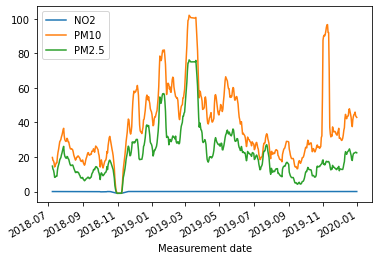

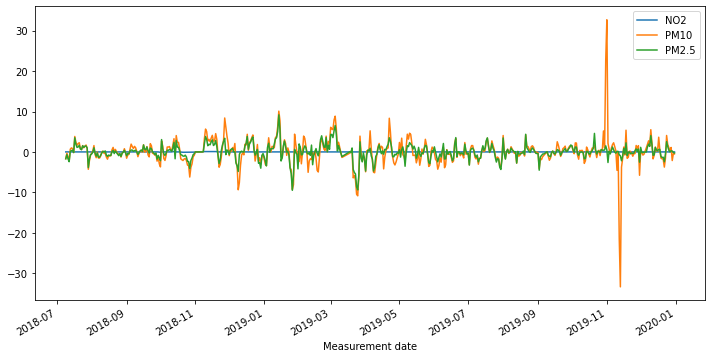

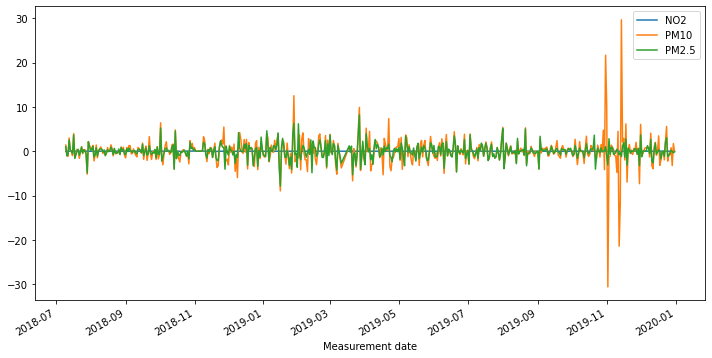

In [254]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [255]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -5.902127e+00
p-value                        2.762231e-07
#Lags Used                     1.600000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.113366e+00
p-value                        9.218333e-08
#Lags Used                     1.700000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.617222
p-value                          0.000001
#Lags Used                      16.000000
Number of Observations Used    514.000000
Critical Value (1%)             -3.443136
Critical Value (5%)             -2.

In [256]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.724324e+00
p-value                        9.361900e-17
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.138614e+01
p-value                        8.281109e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.810005e+00
p-value                        2.003216e-14
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)      

# Station 105 PM2.5

In [257]:
base_model = sm.tsa.statespace.SARIMAX(df_105['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4619.998
Date:                Mon, 18 Oct 2021   AIC                           9243.997
Time:                        11:07:43   BIC                           9253.976
Sample:                             0   HQIC                          9247.774
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     22.8773      0.664     34.430      0.000      21.575      24.180
sigma2       292.4369      7.918     36.932      0.000     276.918     307.956
Ljung-Box (L1) (Q):                 552.87   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8581.175, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10355.129, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8582.925, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9441.970, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8581.531, Time=0.13 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=8494.731, Time=0.10 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=9083.446, Time=0.06 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=8447.126, Time=0.19 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8447.451, Time=0.30 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=8446.270, Time=0.30 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=8465.823, Time=0.13 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=8449.362, Time=0.44 sec
 ARIMA(2,0,4)(0,0,0)[0]             : AIC=8450.556, Time=0.44 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=8458.000, Time=0.24 sec
 ARIMA(3,0,4)(0,0,0)[0]         

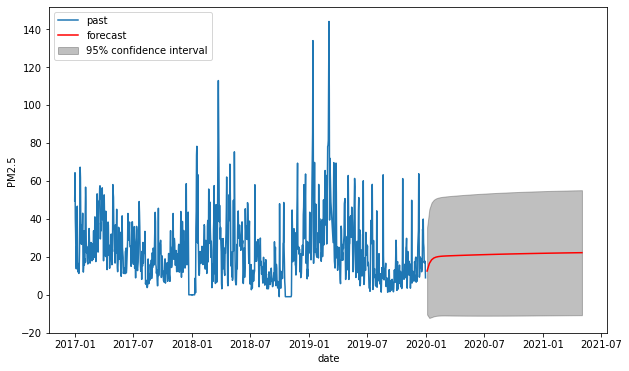

In [258]:
timeseries = df_105['PM2.5']
automodel = arimamodel(df_105['PM2.5'])
plotarima(70, timeseries, automodel)

In [259]:
best_model = sm.tsa.statespace.SARIMAX(df_105['PM2.5'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4214.570
Date:                Mon, 18 Oct 2021   AIC                           8441.140
Time:                        11:07:50   BIC                           8471.076
Sample:                             0   HQIC                          8452.473
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2040      0.147      1.387      0.165      -0.084       0.492
ar.L1          1.4646      0.049     29.722      0.000       1.368       1.561
ar.L2         -0.4734      0.045    -10.422      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [260]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 10.771127885881748
Test RMSE: 22.677321025019026
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2060.157
Date:                Mon, 18 Oct 2021   AIC                           4132.314
Time:                        11:07:51   BIC                           4158.097
Sample:                    01-01-2017   HQIC                          4142.395
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.4403      2.887      8.812      0.000      19.782      31.099
ar.L1          1.5224      0.064     23.938      0.000       

# Station 105 PM10

In [261]:
base_model = sm.tsa.statespace.SARIMAX(df_105['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5247.565
Date:                Mon, 18 Oct 2021   AIC                          10499.131
Time:                        11:07:51   BIC                          10509.109
Sample:                             0   HQIC                         10502.908
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     41.4613      1.154     35.931      0.000      39.200      43.723
sigma2       929.8790     12.446     74.715      0.000     905.486     954.272
Ljung-Box (L1) (Q):                 467.04   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10006.314, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11632.966, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10027.143, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10763.862, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=10021.153, Time=0.10 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9888.246, Time=0.10 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=10502.808, Time=0.06 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9864.843, Time=0.18 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9856.305, Time=0.22 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9868.836, Time=0.19 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=9863.682, Time=0.55 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=9858.144, Time=0.41 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9859.202, Time=0.36 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=9861.810, Time=0.30 sec
 ARIMA(4,0,3)(0,0,0)[0]    

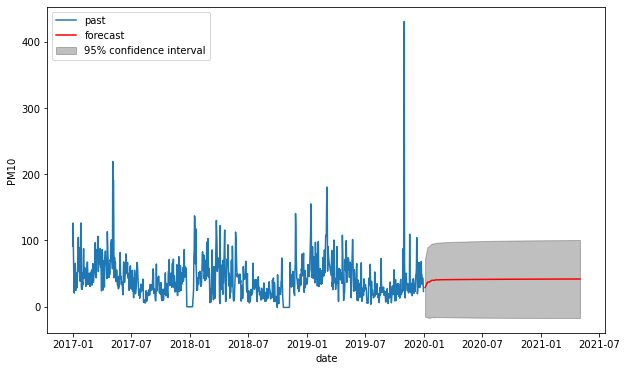

In [262]:
timeseries = df_105['PM10']
automodel = arimamodel(df_105['PM10'])
plotarima(70, timeseries, automodel)

In [263]:
best_model = sm.tsa.statespace.SARIMAX(df_105['PM10'], trend='c', order=[3,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(3, 0, 2)   Log Likelihood               -4918.162
Date:                Mon, 18 Oct 2021   AIC                           9850.324
Time:                        11:07:59   BIC                           9885.250
Sample:                             0   HQIC                          9863.546
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.7647      0.526      1.453      0.146      -0.267       1.796
ar.L1          0.8290      0.110      7.514      0.000       0.613       1.045
ar.L2          0.4617      0.172      2.691      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [264]:
model_train = arima_results(train['PM10'],test['PM10'], order=[3,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 20.431646329199054
Test RMSE: 41.10056942082306
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(3, 0, 2)   Log Likelihood               -2407.886
Date:                Mon, 18 Oct 2021   AIC                           4829.772
Time:                        11:07:59   BIC                           4859.852
Sample:                    01-01-2017   HQIC                          4841.534
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         46.2624      6.786      6.818      0.000      32.963      59.562
ar.L1          0.6155      0.067      9.164      0.000       0

# Station 105 NO2 

In [265]:
base_model = sm.tsa.statespace.SARIMAX(df_105['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                 560.136
Date:                Mon, 18 Oct 2021   AIC                          -1116.271
Time:                        11:08:00   BIC                          -1106.293
Sample:                             0   HQIC                         -1112.494
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0012      0.027      0.044      0.965      -0.052       0.054
sigma2         0.0209      0.001     17.543      0.000       0.019       0.023
Ljung-Box (L1) (Q):                 924.75   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-3217.813, Time=0.13 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-1118.196, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-3172.819, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-2206.824, Time=0.09 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-3232.063, Time=0.20 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-3198.292, Time=0.10 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-3247.573, Time=0.34 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-3249.182, Time=0.08 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-3247.508, Time=0.04 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-3245.805, Time=0.25 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=-3247.189, Time=0.10 sec

Best model:  ARIMA(3,0,0)(0,0,0)[0]          
Total fit time: 1.414 seconds


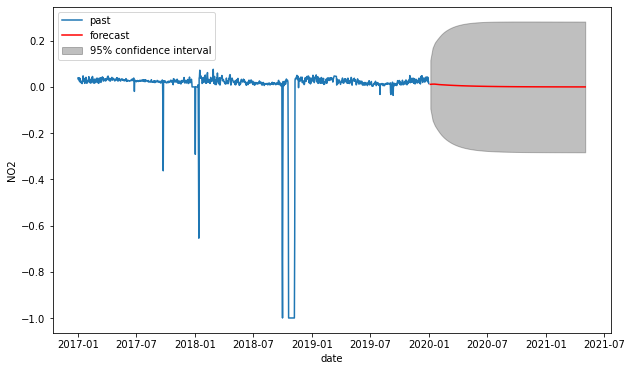

In [266]:
timeseries = df_105['NO2']
automodel = arimamodel(df_105['NO2'])
plotarima(70, timeseries, automodel)

In [267]:
best_model = sm.tsa.statespace.SARIMAX(df_105['NO2'], trend='c', order=[3,0,0])
res = best_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(3, 0, 0)   Log Likelihood                1628.595
Date:                Mon, 18 Oct 2021   AIC                          -3247.189
Time:                        11:08:01   BIC                          -3222.242
Sample:                             0   HQIC                         -3237.745
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0001      0.003      0.041      0.967      -0.006       0.006
ar.L1          1.1019      0.009    126.793      0.000       1.085       1.119
ar.L2         -0.3904      0.012    -33.819      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


In [268]:
model_train = arima_results(train['NO2'],test['NO2'], order=[3,0,0])

Train RMSE: 0.03758851283499046
Test RMSE: 0.20348702716986444
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(3, 0, 0)   Log Likelihood                1011.070
Date:                Mon, 18 Oct 2021   AIC                          -2012.140
Time:                        11:08:01   BIC                          -1990.654
Sample:                    01-01-2017   HQIC                         -2003.739
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0227      0.006      3.922      0.000       0.011       0.034
ar.L1          0.3729      0.013     29.331      0.000     

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 106

In [81]:
df_106 = df[df['Station code'] == 106]

In [82]:
df_106.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,106,2017-01-01,0.004792,0.054917,0.004083,1.162500,76.083333,68.000000,Good,Normal,Good,Good,Normal,Bad
2017-01-02,106,2017-01-02,0.005167,0.045500,0.014500,1.070833,103.333333,91.041667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,106,2017-01-03,0.005083,0.048125,0.012458,0.900000,66.375000,54.708333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,106,2017-01-04,0.005125,0.058458,0.009000,1.041667,49.125000,39.500000,Good,Normal,Good,Good,Normal,Bad
2017-01-05,106,2017-01-05,0.003917,0.041875,0.011000,0.750000,31.750000,24.250000,Good,Normal,Good,Good,Normal,Normal


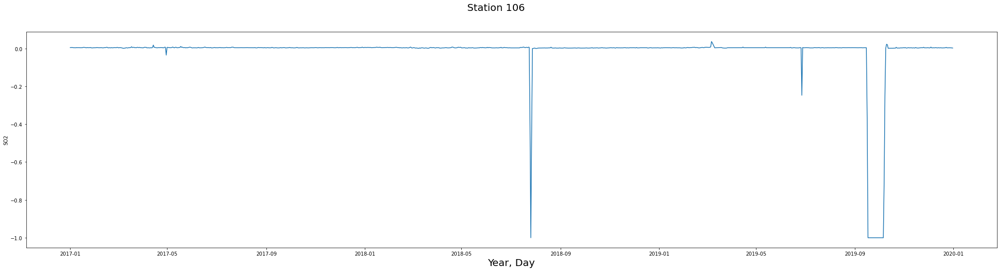

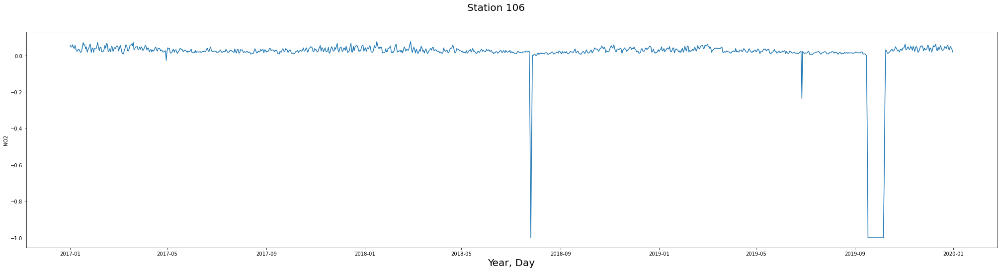

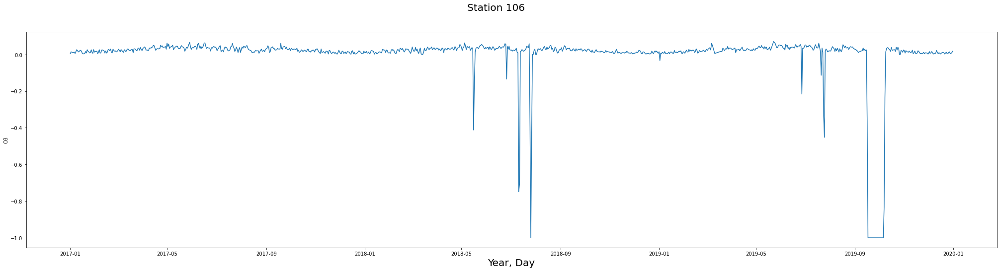

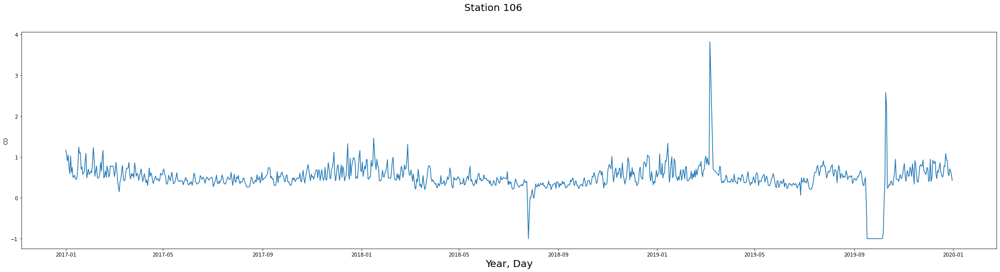

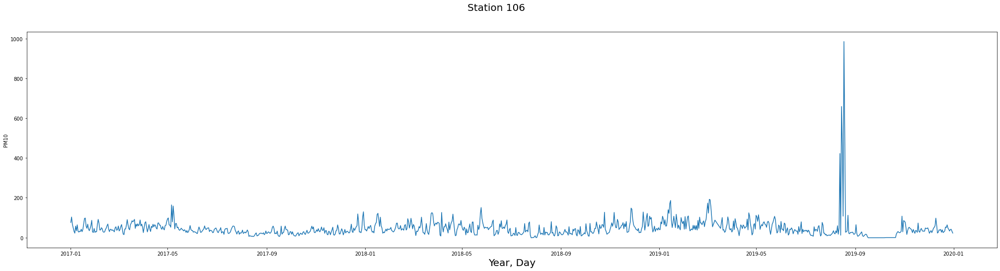

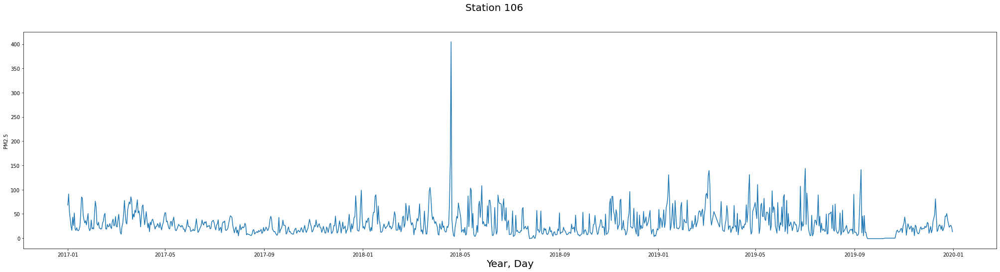

In [83]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 106", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_106)

# Station 107

In [84]:
df_107 = df[df['Station code'] == 107]

In [85]:
df_107.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,107,2017-01-01,0.004500,0.045458,0.002875,0.791667,76.916667,52.916667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,107,2017-01-02,0.005083,0.038042,0.013875,0.666667,111.500000,80.125000,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,107,2017-01-03,0.004917,0.045583,0.011208,0.525000,82.291667,51.875000,Good,Normal,Good,Good,Bad,Bad
2017-01-04,107,2017-01-04,0.005208,0.056500,0.006208,0.604167,58.291667,35.458333,Good,Normal,Good,Good,Normal,Bad
2017-01-05,107,2017-01-05,0.004417,0.033125,0.014083,0.450000,39.291667,22.833333,Good,Normal,Good,Good,Normal,Normal


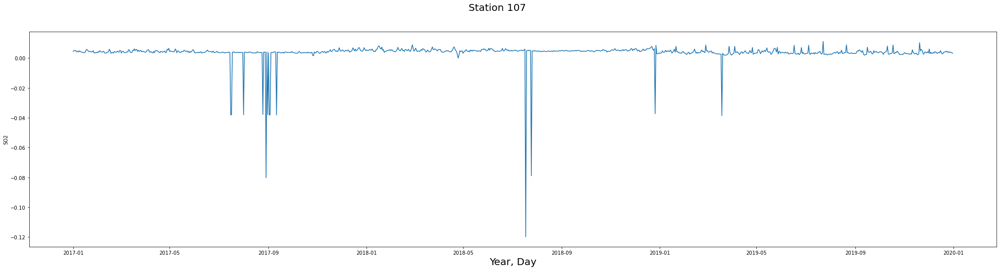

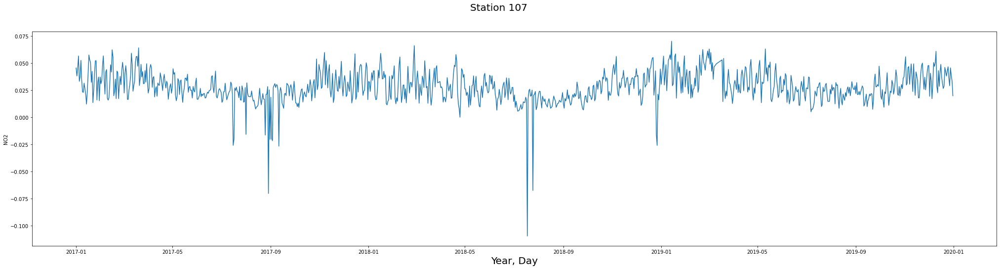

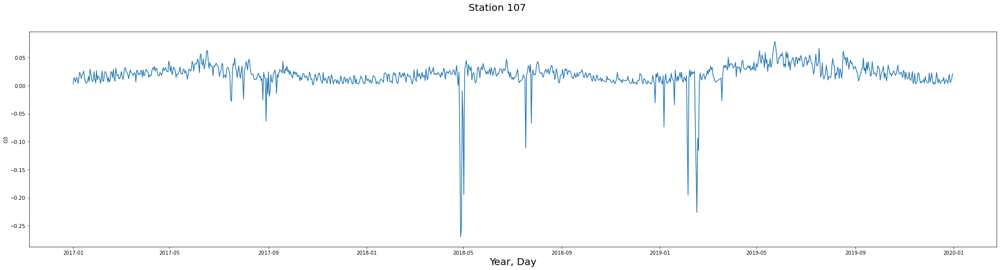

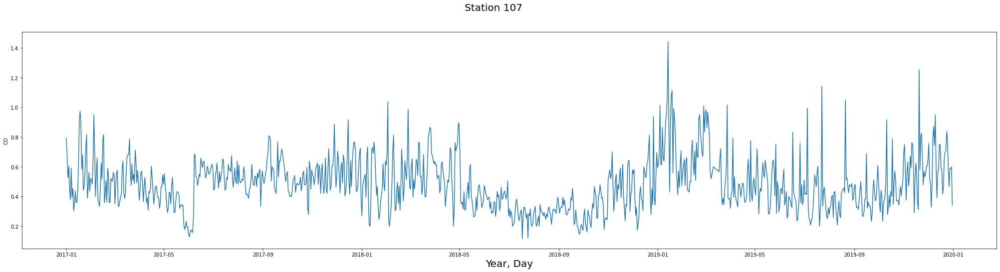

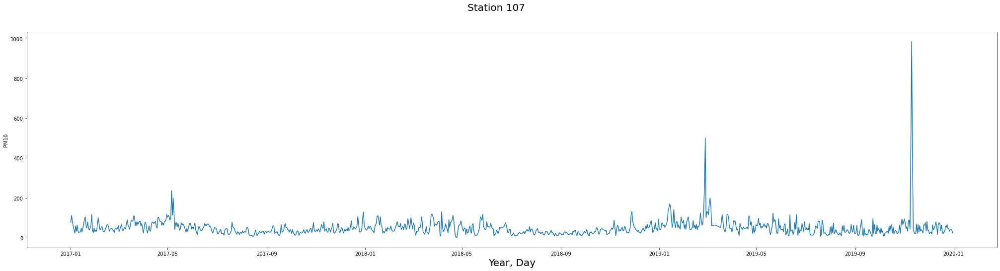

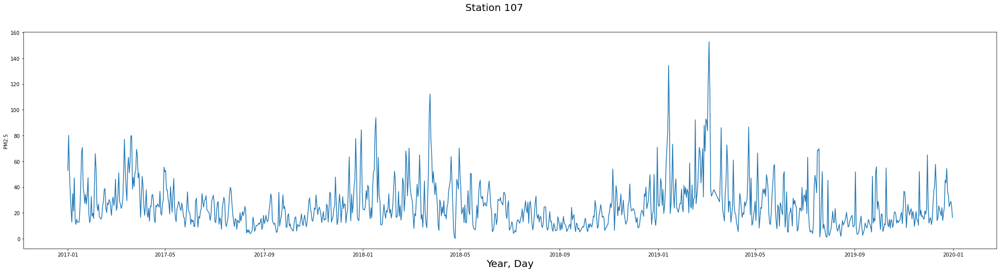

In [86]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 107", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_107)

# Station 108

In [87]:
df_108 = df[df['Station code'] == 108]

In [88]:
df_108.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,108,2017-01-01,0.004375,0.044542,0.005042,0.812500,79.708333,71.333333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,108,2017-01-02,0.005208,0.044792,0.019208,0.900000,110.750000,95.458333,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,108,2017-01-03,0.004875,0.047708,0.015875,0.862500,85.750000,69.041667,Good,Normal,Good,Good,Bad,Bad
2017-01-04,108,2017-01-04,0.006083,0.055833,0.008042,0.945833,55.875000,41.250000,Good,Normal,Good,Good,Normal,Bad
2017-01-05,108,2017-01-05,0.004000,0.033042,0.017125,0.612500,32.583333,21.750000,Good,Normal,Good,Good,Normal,Normal


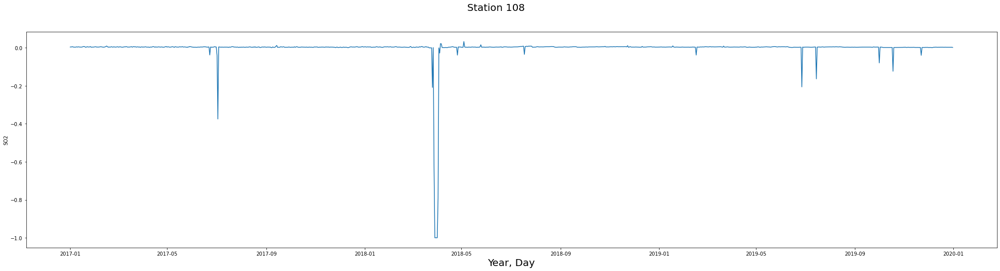

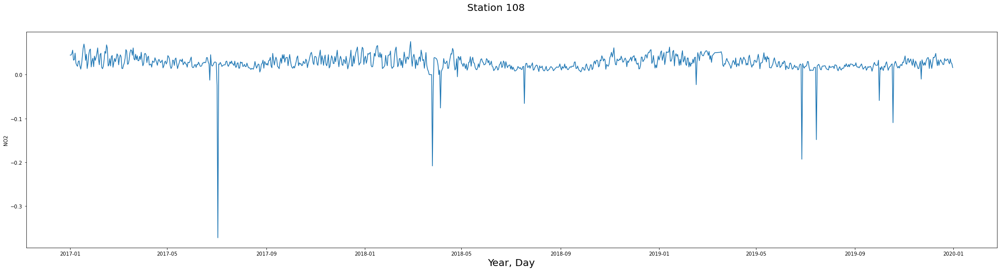

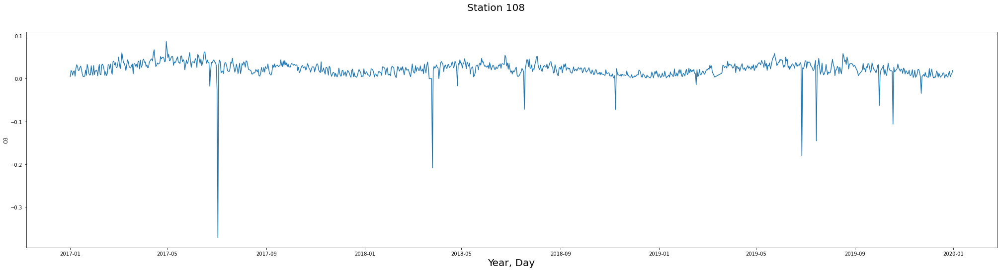

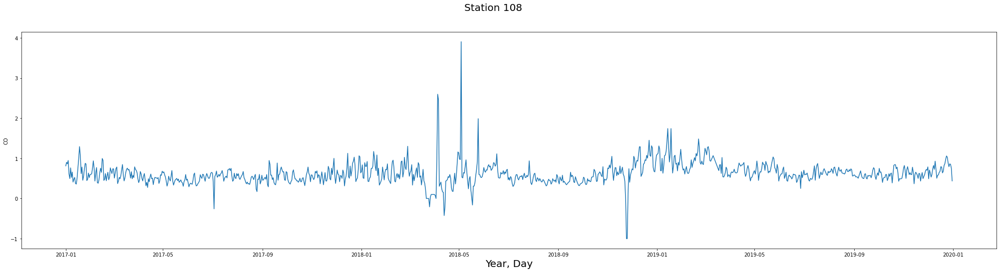

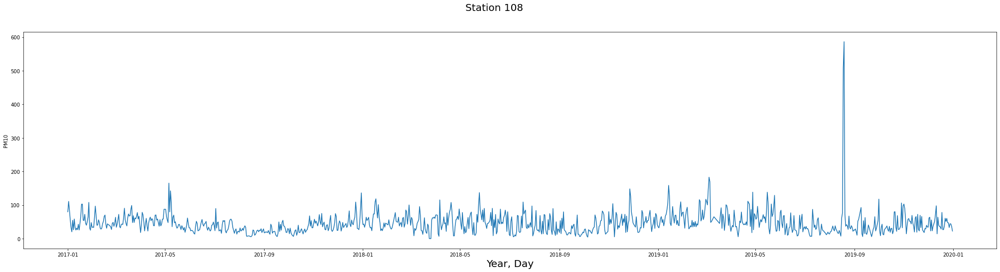

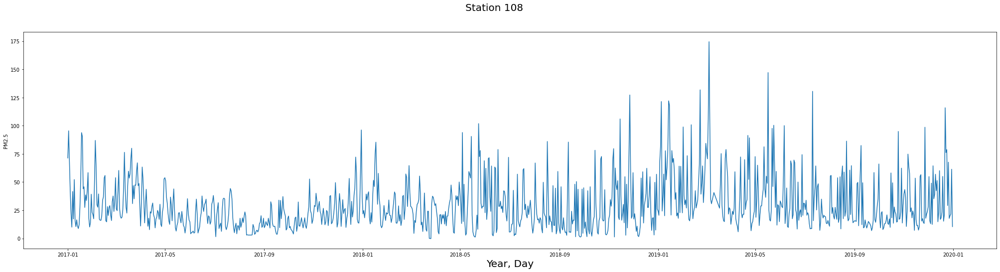

In [89]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 108", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_108)

# Station 109

In [90]:
df_109 = df[df['Station code'] == 109]

In [91]:
df_109.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,109,2017-01-01,0.005583,0.046292,0.002917,1.016667,87.083333,62.250000,Good,Normal,Good,Good,Bad,Bad
2017-01-02,109,2017-01-02,0.005625,0.039417,0.012250,1.041667,128.041667,89.250000,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,109,2017-01-03,0.006042,0.043958,0.010042,0.945833,91.958333,62.583333,Good,Normal,Good,Good,Bad,Bad
2017-01-04,109,2017-01-04,0.006250,0.051583,0.007208,0.995833,55.958333,34.791667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,109,2017-01-05,0.005292,0.040375,0.006667,0.804167,43.416667,24.458333,Good,Normal,Good,Good,Normal,Normal


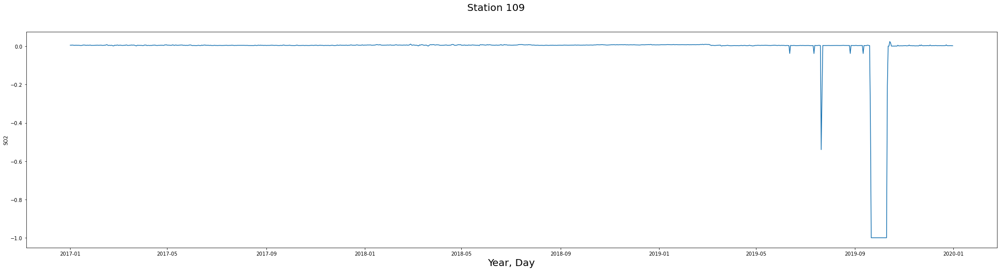

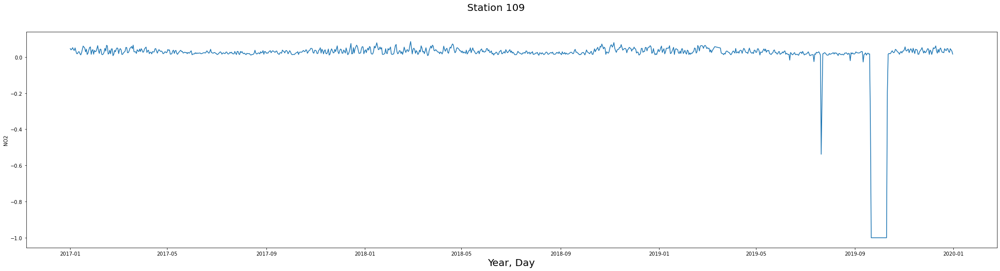

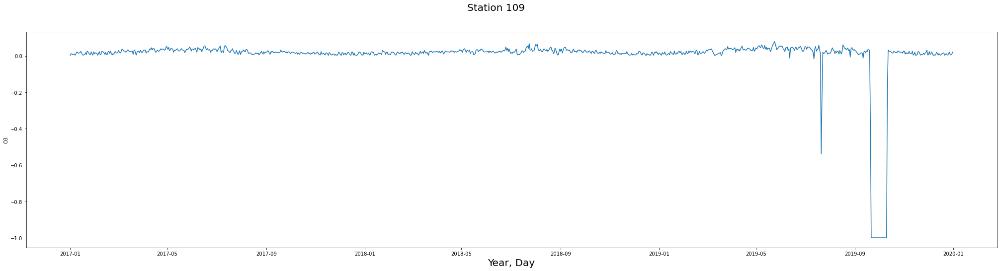

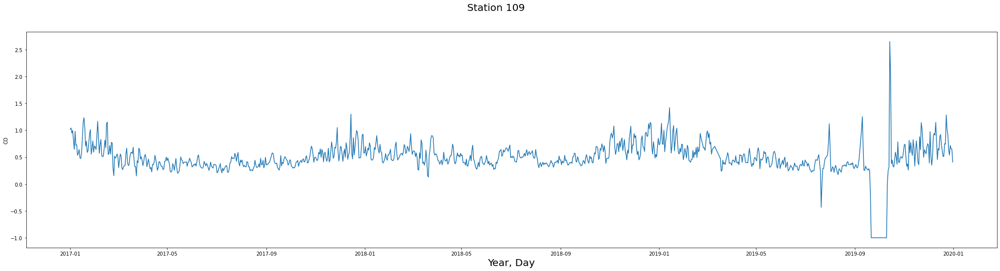

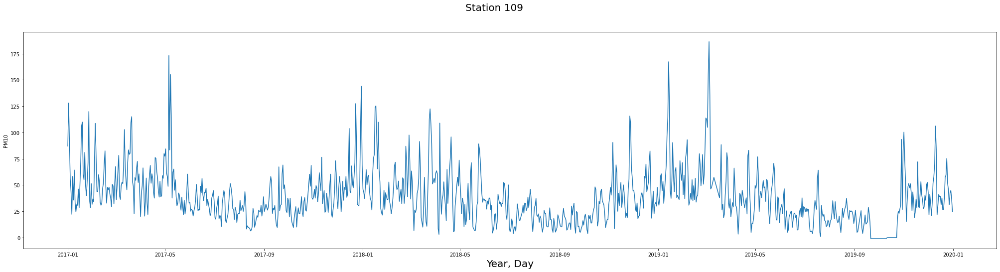

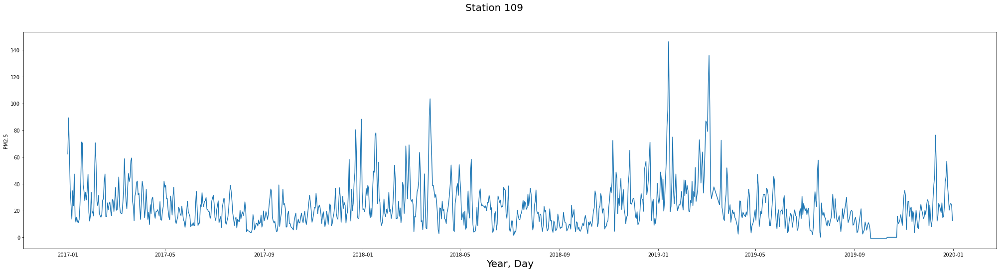

In [92]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 109", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_109)

# Station 110

In [93]:
df_110 = df[df['Station code'] == 110]

In [94]:
df_110.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,110,2017-01-01,0.005250,0.040792,0.004542,0.795833,80.166667,63.750000,Good,Normal,Good,Good,Bad,Bad
2017-01-02,110,2017-01-02,0.005417,0.040958,0.013583,0.866667,122.166667,94.583333,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,110,2017-01-03,0.004875,0.043542,0.008250,0.716667,93.916667,69.458333,Good,Normal,Good,Good,Bad,Bad
2017-01-04,110,2017-01-04,0.005667,0.052417,0.005917,0.779167,60.625000,38.666667,Good,Normal,Good,Good,Normal,Bad
2017-01-05,110,2017-01-05,0.005000,0.031375,0.014208,0.520833,38.333333,23.291667,Good,Normal,Good,Good,Normal,Normal


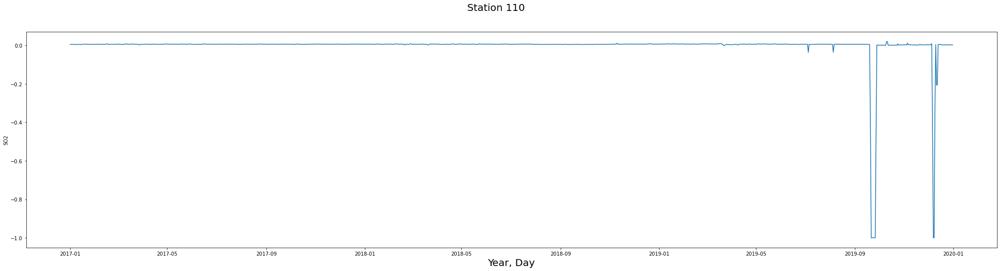

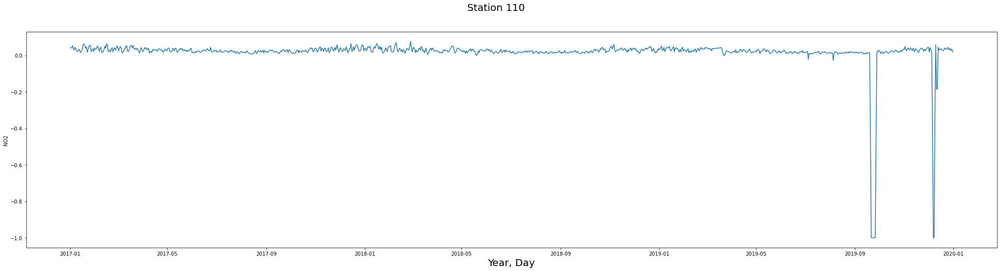

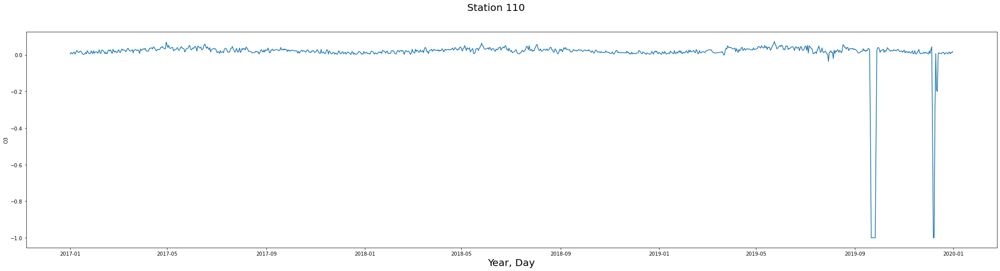

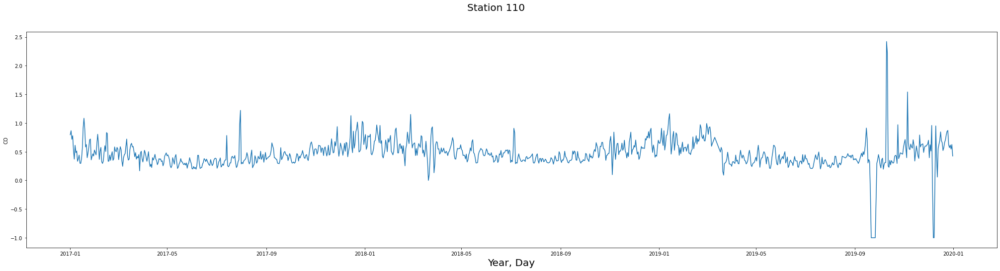

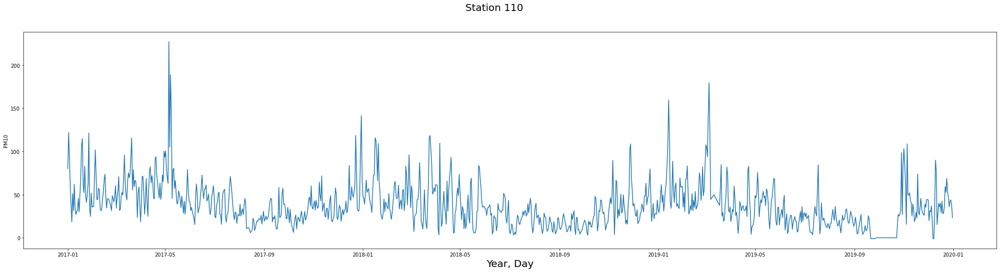

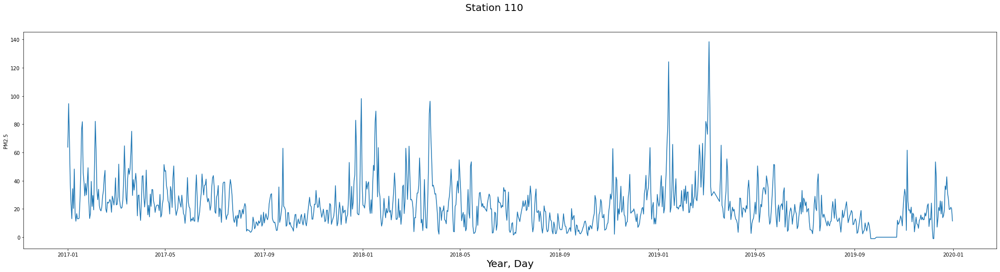

In [95]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 110", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_110)

# Station 111

In [96]:
df_111 = df[df['Station code'] == 111]

In [97]:
df_111.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,111,2017-01-01,0.004917,0.047708,0.002625,0.916667,65.750000,43.708333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,111,2017-01-02,0.005750,0.043375,0.010958,0.929167,98.791667,62.375000,Good,Normal,Good,Good,Bad,Bad
2017-01-03,111,2017-01-03,0.006083,0.050417,0.008583,0.866667,101.083333,58.666667,Good,Normal,Good,Good,Bad,Bad
2017-01-04,111,2017-01-04,0.005750,0.056250,0.007083,0.945833,60.375000,30.833333,Good,Normal,Good,Good,Normal,Normal
2017-01-05,111,2017-01-05,0.004542,0.040375,0.007792,0.645833,50.708333,24.625000,Good,Normal,Good,Good,Normal,Normal


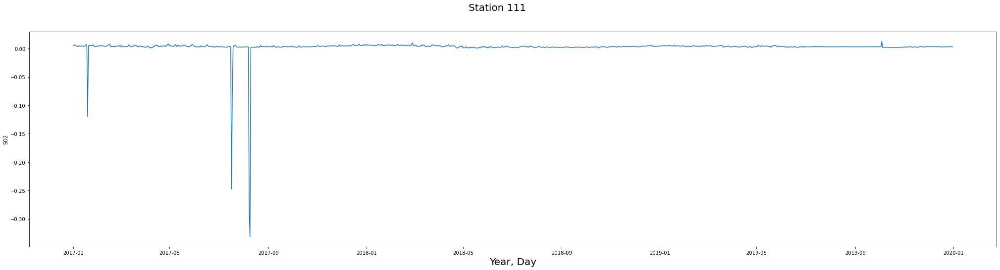

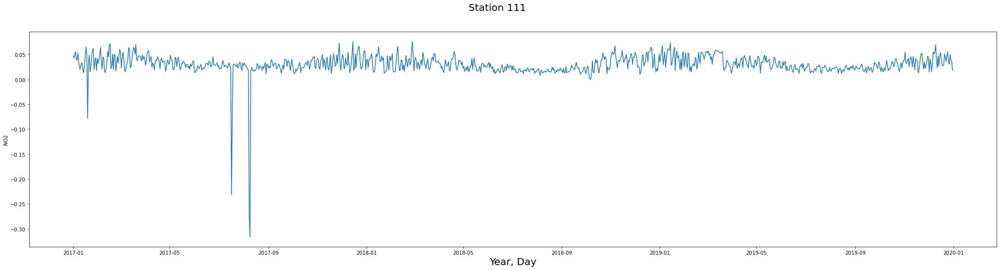

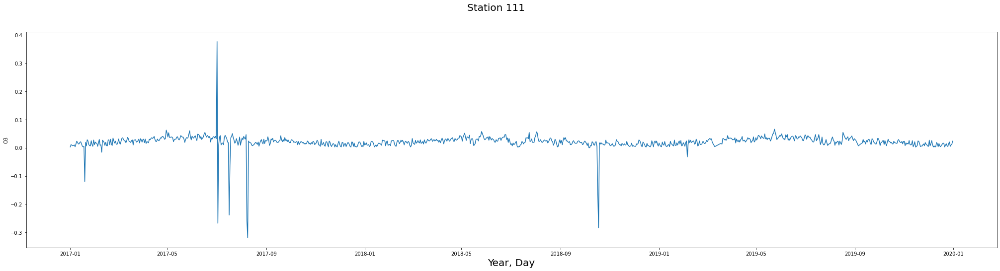

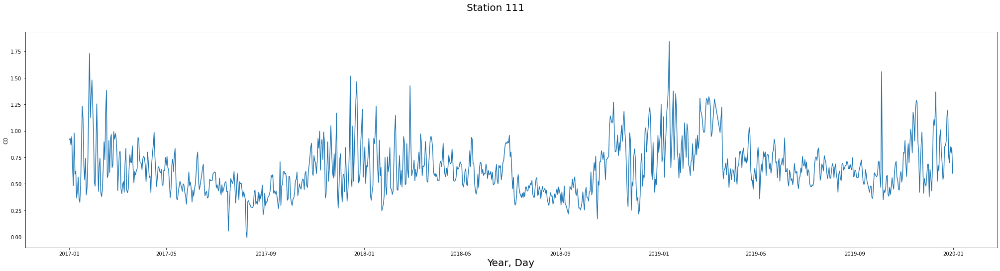

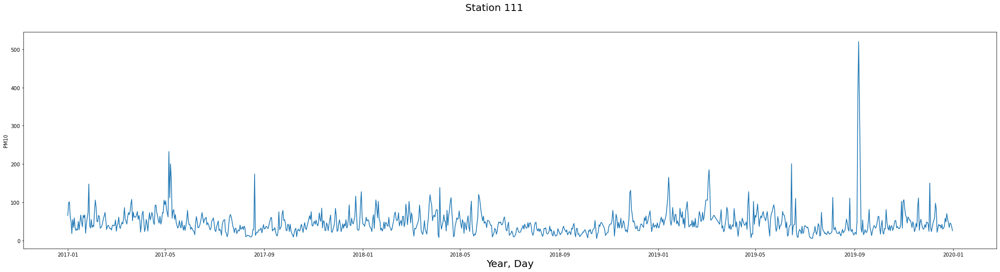

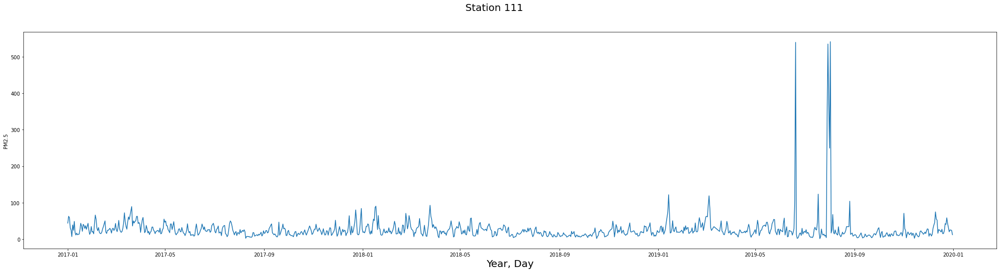

In [98]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 111", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_111)

# Station 112

In [99]:
df_112 = df[df['Station code'] == 112]

In [100]:
df_112.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,112,2017-01-01,0.004875,0.046375,0.002625,0.858333,78.166667,65.208333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,112,2017-01-02,0.008542,0.033792,0.022875,0.966667,102.916667,85.291667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,112,2017-01-03,0.006000,0.038917,0.014958,0.729167,77.875000,59.791667,Good,Normal,Good,Good,Normal,Bad
2017-01-04,112,2017-01-04,0.006667,0.044125,0.013792,0.808333,43.583333,33.291667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,112,2017-01-05,0.005000,0.030375,0.013458,0.591667,27.500000,20.291667,Good,Normal,Good,Good,Good,Normal


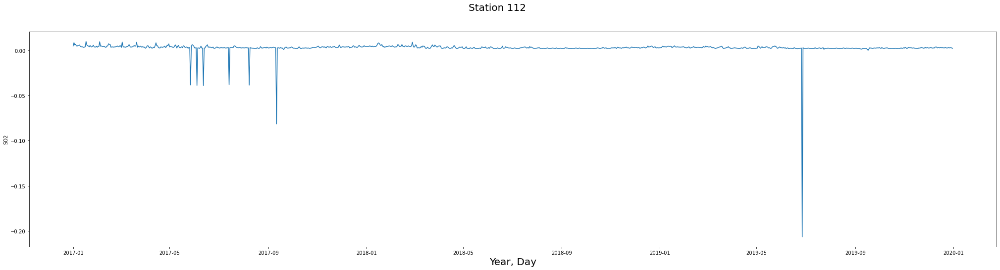

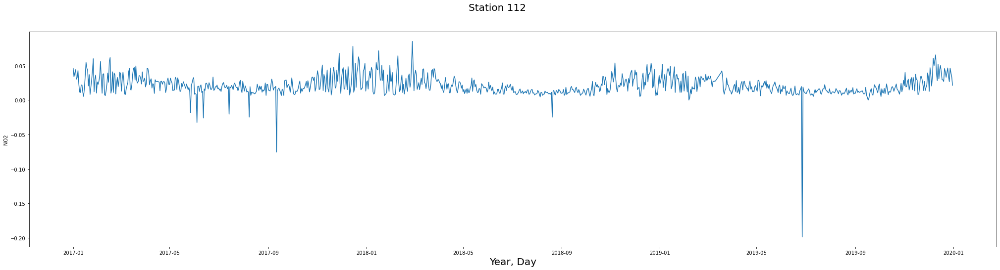

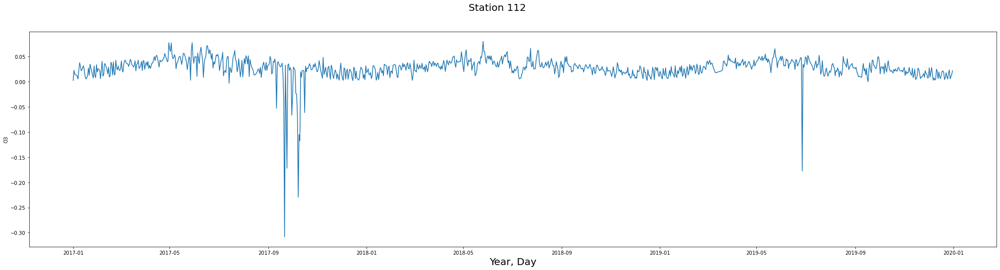

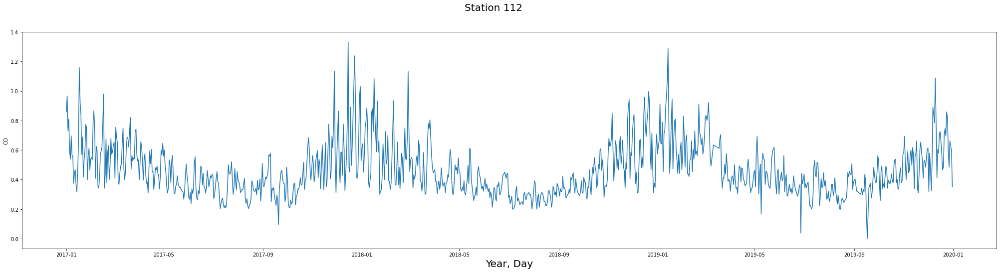

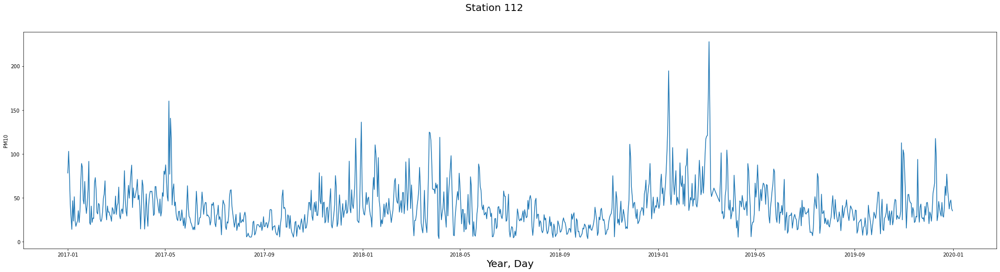

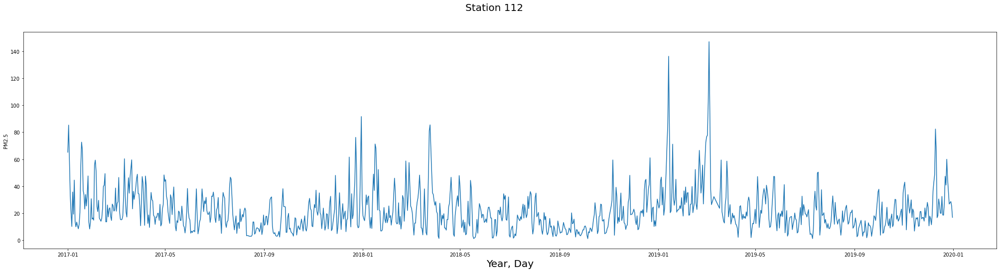

In [101]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 112", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_112)

# Station 113

In [102]:
df_113 = df[df['Station code'] == 113]

In [103]:
df_113.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,113,2017-01-01,-0.036250,0.008292,-0.038708,0.833333,75.000000,45.083333,Good,Good,Good,Good,Normal,Bad
2017-01-02,113,2017-01-02,-0.035292,-0.003375,-0.021250,0.812500,110.833333,67.000000,Good,Good,Good,Good,Bad,Bad
2017-01-03,113,2017-01-03,0.006708,0.043875,0.016083,0.891667,93.125000,55.583333,Good,Normal,Good,Good,Bad,Bad
2017-01-04,113,2017-01-04,-0.035083,0.008333,-0.030708,0.875000,51.500000,30.291667,Good,Good,Good,Good,Normal,Normal
2017-01-05,113,2017-01-05,-0.036750,-0.010250,-0.027792,0.541667,40.458333,21.958333,Good,Good,Good,Good,Normal,Normal


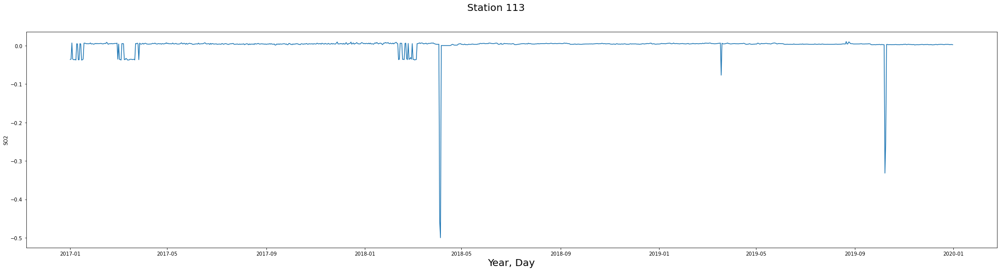

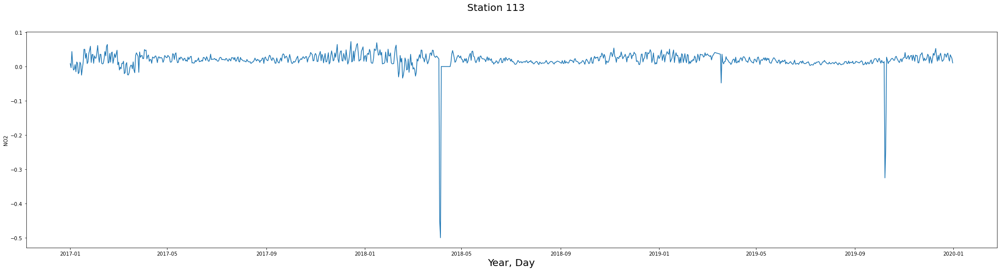

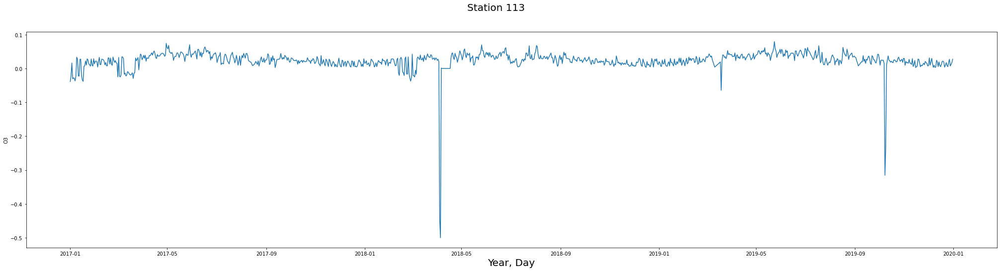

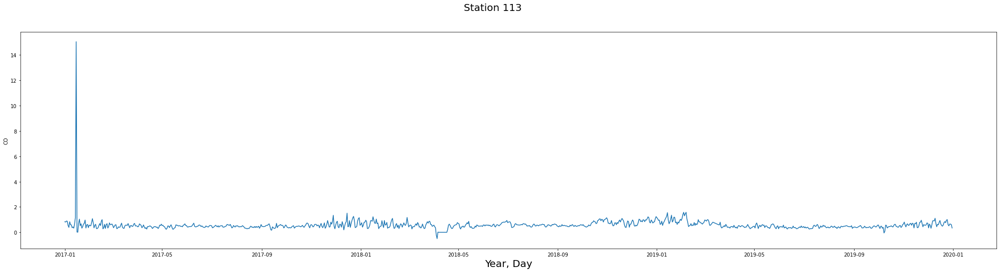

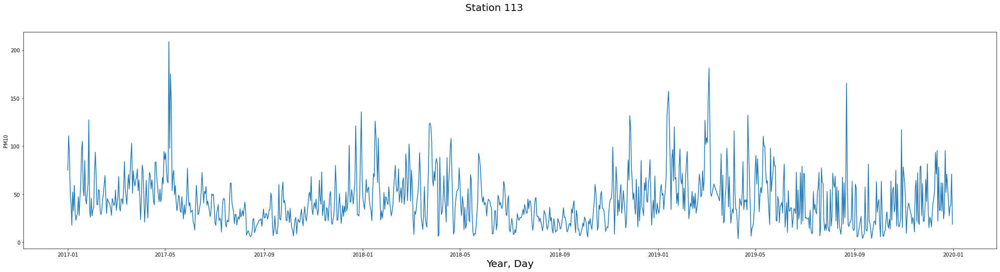

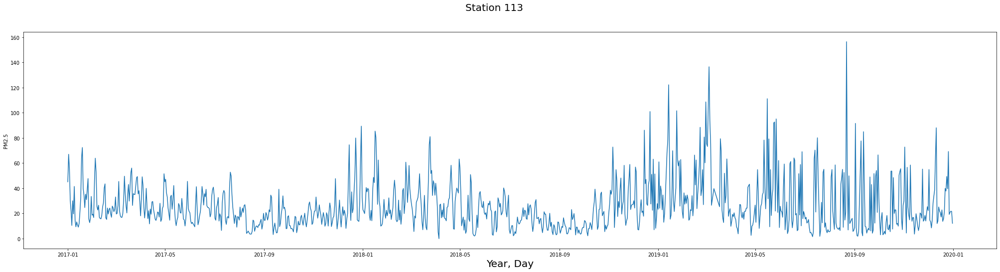

In [104]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 113", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_113)

# Station 114

In [105]:
df_114 = df[df['Station code'] == 114]

In [106]:
df_114.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,114,2017-01-01,0.007958,0.052375,0.003875,1.191667,82.125000,65.208333,Good,Normal,Good,Good,Bad,Bad
2017-01-02,114,2017-01-02,0.007542,0.040375,0.020042,0.912500,105.083333,82.208333,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,114,2017-01-03,0.006792,0.053958,0.009333,1.037500,84.791667,63.625000,Good,Normal,Good,Good,Bad,Bad
2017-01-04,114,2017-01-04,0.006292,0.055250,0.010167,0.945833,49.041667,33.625000,Good,Normal,Good,Good,Normal,Normal
2017-01-05,114,2017-01-05,0.006667,0.038000,0.014500,0.812500,36.541667,24.166667,Good,Normal,Good,Good,Normal,Normal


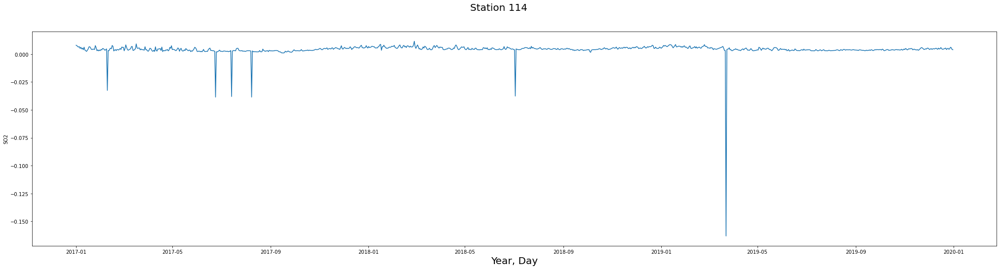

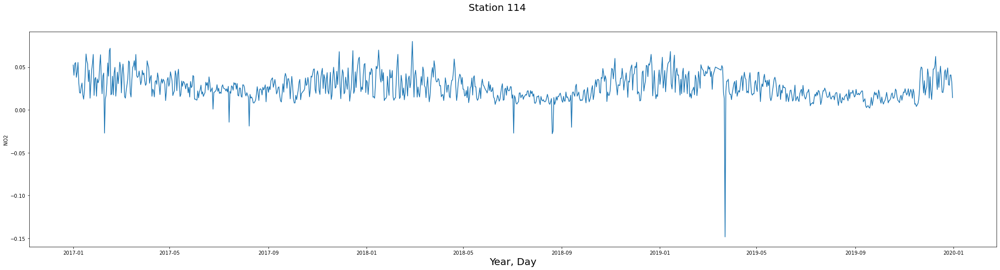

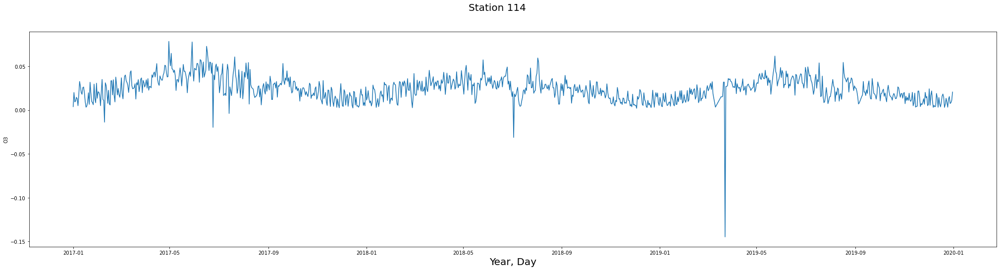

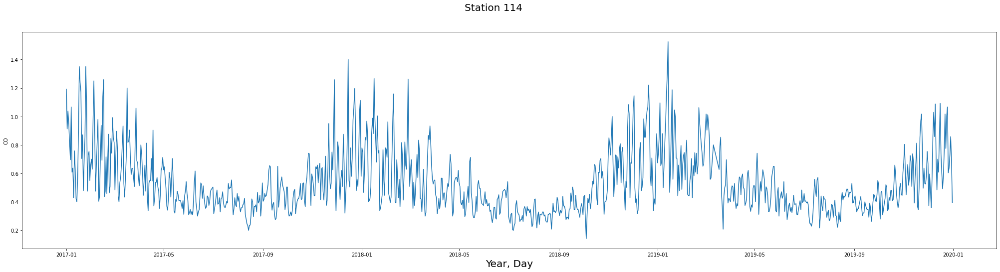

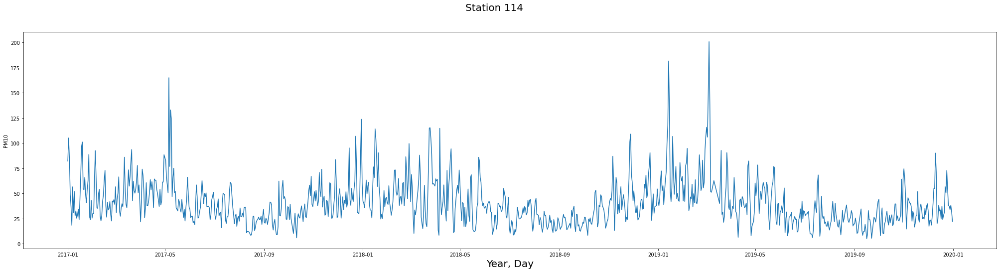

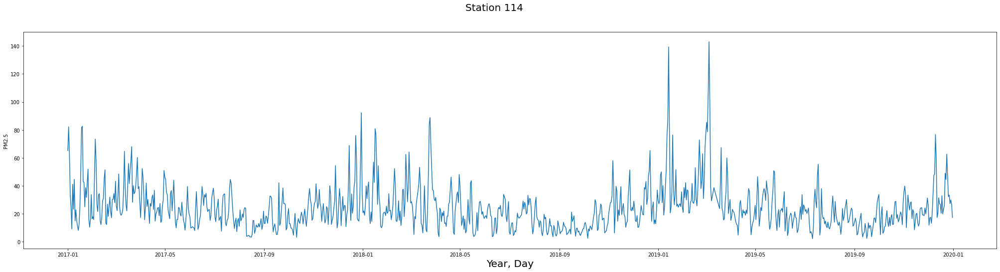

In [107]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 114", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_114)

# Station 115

In [108]:
df_115 = df[df['Station code'] == 115]

In [109]:
df_115.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,115,2017-01-01,0.005125,0.046375,0.003625,1.058333,79.625000,51.041667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,115,2017-01-02,0.005167,0.039167,0.011125,0.875000,106.958333,62.791667,Good,Normal,Good,Good,Bad,Bad
2017-01-03,115,2017-01-03,0.004833,0.040625,0.007750,0.816667,73.166667,38.416667,Good,Normal,Good,Good,Normal,Bad
2017-01-04,115,2017-01-04,0.006417,0.049500,0.006417,0.970833,58.375000,31.500000,Good,Normal,Good,Good,Normal,Normal
2017-01-05,115,2017-01-05,0.004958,0.039167,0.006083,0.820833,39.000000,20.291667,Good,Normal,Good,Good,Normal,Normal


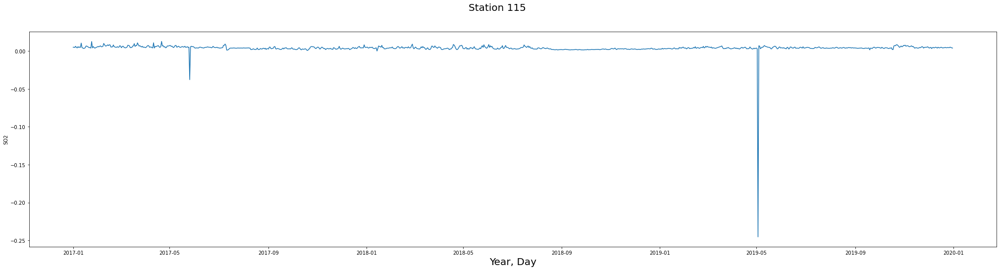

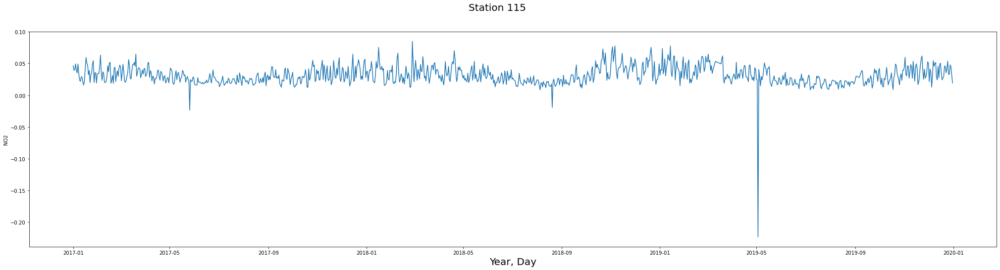

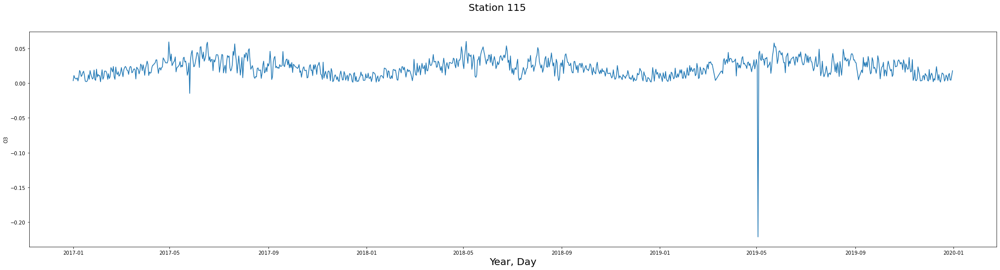

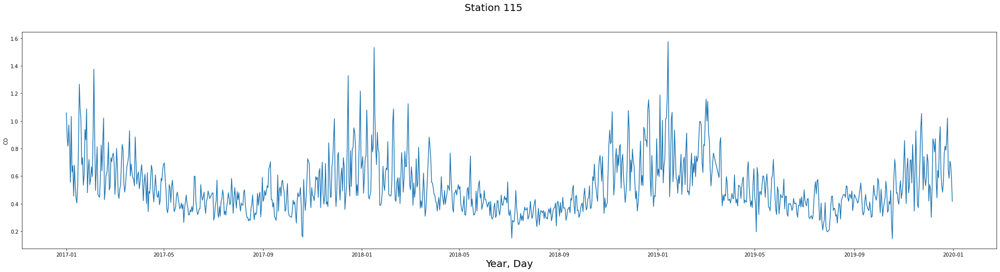

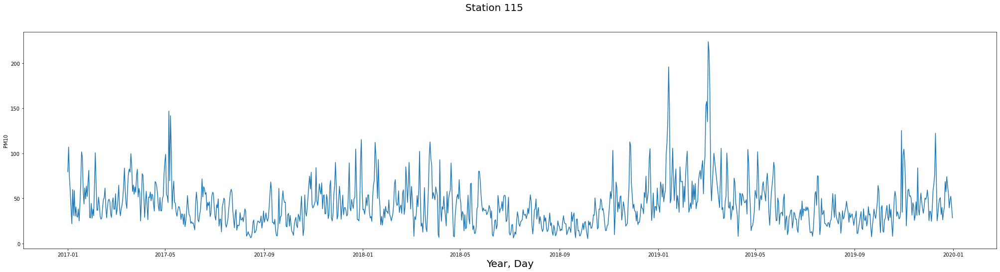

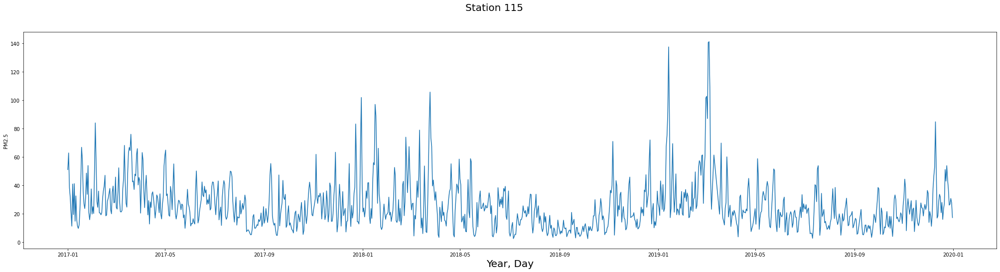

In [110]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 115", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_115)

# Station 116

In [111]:
df_116 = df[df['Station code'] == 116]

In [112]:
df_116.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,116,2017-01-01,0.006292,0.053292,0.005250,0.962500,75.125000,53.708333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,116,2017-01-02,0.006500,0.036500,0.017833,0.683333,107.083333,71.000000,Good,Normal,Good,Good,Bad,Bad
2017-01-03,116,2017-01-03,0.006875,0.044125,0.012542,0.716667,75.208333,45.875000,Good,Normal,Good,Good,Normal,Bad
2017-01-04,116,2017-01-04,0.007125,0.051667,0.010000,0.787500,62.875000,37.208333,Good,Normal,Good,Good,Normal,Bad
2017-01-05,116,2017-01-05,0.006167,0.042583,0.007458,0.679167,51.541667,28.541667,Good,Normal,Good,Good,Normal,Normal


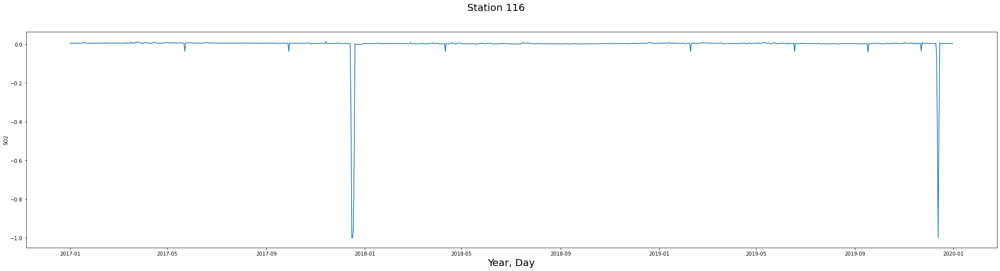

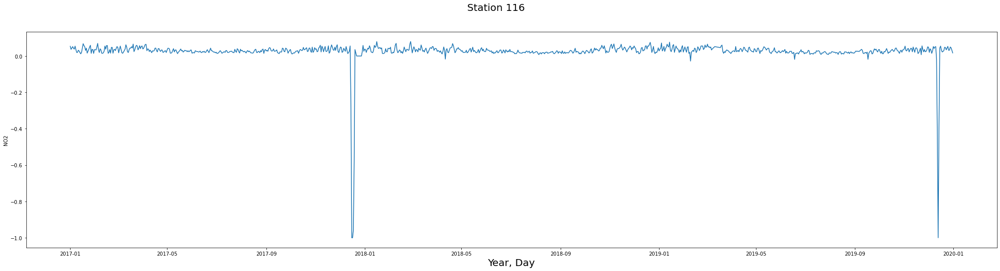

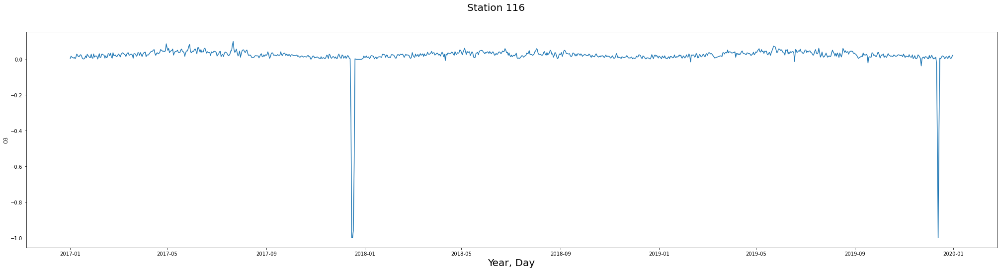

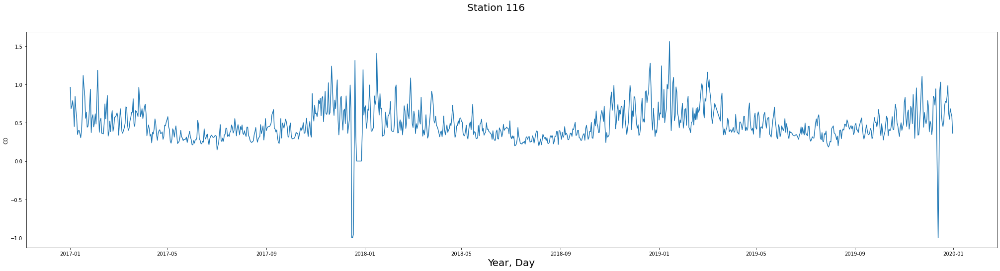

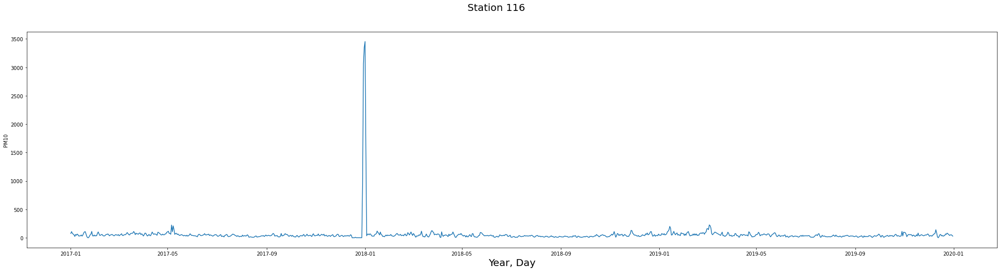

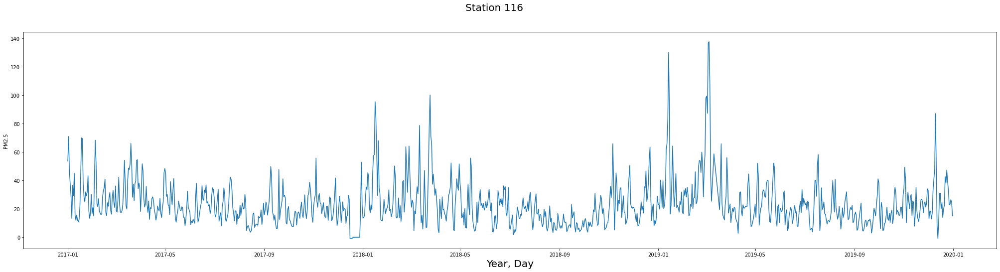

In [113]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 116", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_116)

# Station 117

In [114]:
df_117 = df[df['Station code'] == 117]

In [115]:
df_117.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,117,2017-01-01,0.007000,0.036333,0.006208,0.983333,79.000000,54.375000,Good,Normal,Good,Good,Normal,Bad
2017-01-02,117,2017-01-02,0.008000,0.030458,0.016500,0.754167,116.416667,77.958333,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,117,2017-01-03,0.007417,0.030125,0.014958,0.637500,75.125000,48.750000,Good,Normal,Good,Good,Normal,Bad
2017-01-04,117,2017-01-04,0.007750,0.039250,0.009458,0.795833,60.166667,35.583333,Good,Normal,Good,Good,Normal,Bad
2017-01-05,117,2017-01-05,0.006000,0.029292,0.010417,0.554167,38.500000,21.583333,Good,Good,Good,Good,Normal,Normal


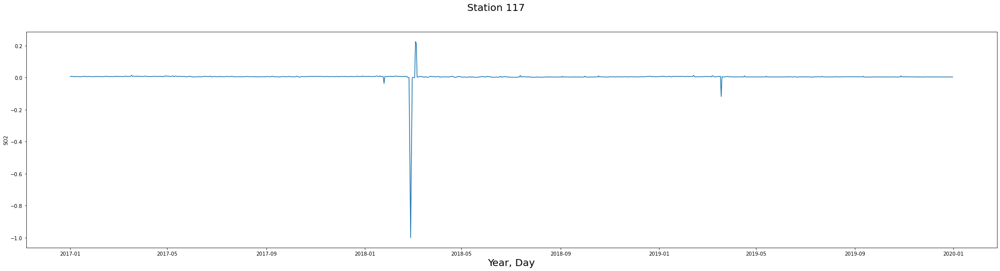

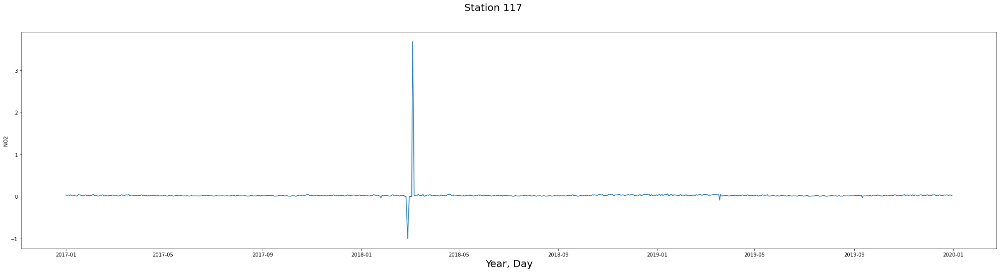

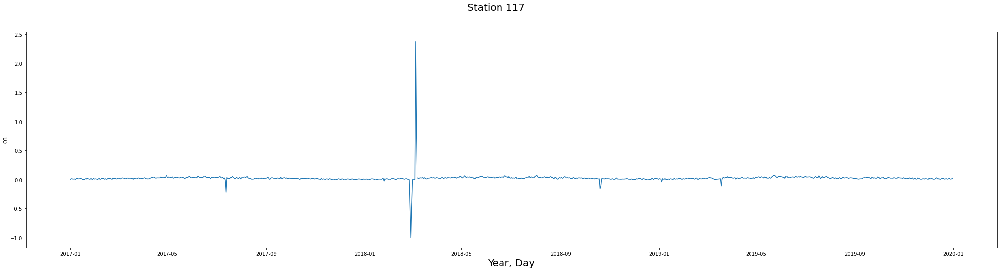

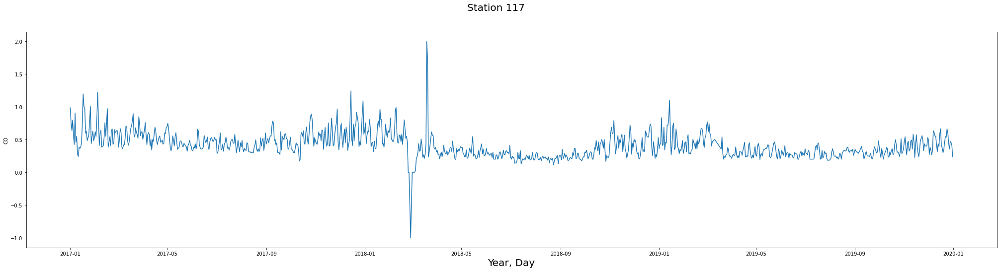

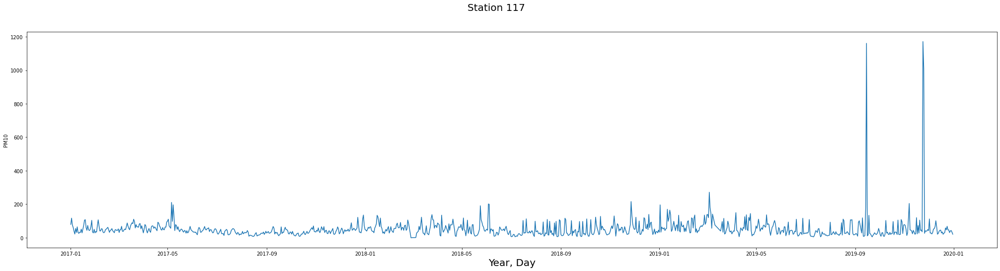

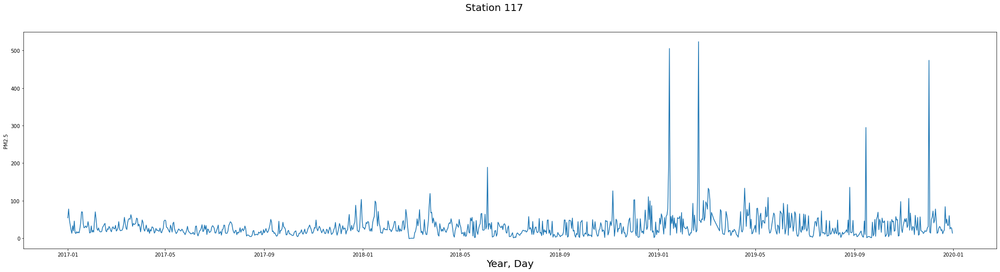

In [116]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 117", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_117)

# Station 118

In [117]:
df_118 = df[df['Station code'] == 118]

In [118]:
df_118.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,118,2017-01-01,0.004875,0.053458,0.006083,1.029167,65.958333,45.000000,Good,Normal,Good,Good,Normal,Bad
2017-01-02,118,2017-01-02,0.005292,0.046000,0.015208,0.808333,100.666667,66.875000,Good,Normal,Good,Good,Bad,Bad
2017-01-03,118,2017-01-03,0.005000,0.043917,0.015625,0.675000,62.541667,37.958333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,118,2017-01-04,0.004958,0.056167,0.008625,0.845833,52.416667,31.750000,Good,Normal,Good,Good,Normal,Normal
2017-01-05,118,2017-01-05,0.004000,0.040792,0.011375,0.679167,32.208333,18.916667,Good,Normal,Good,Good,Normal,Normal


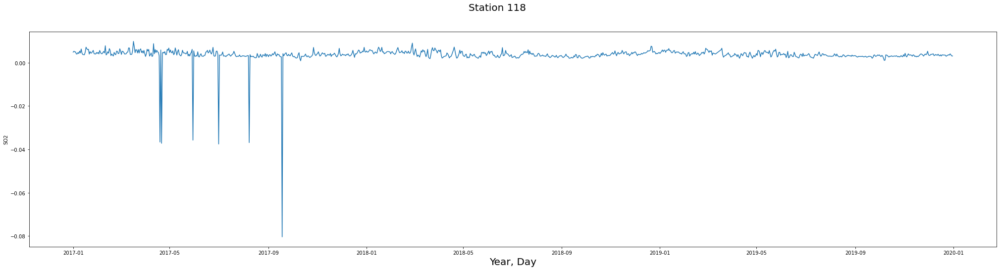

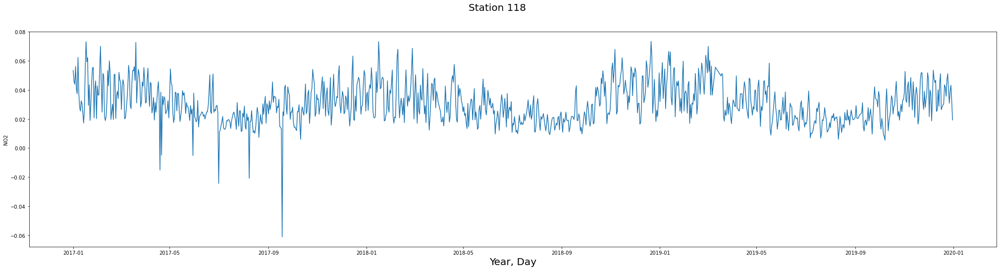

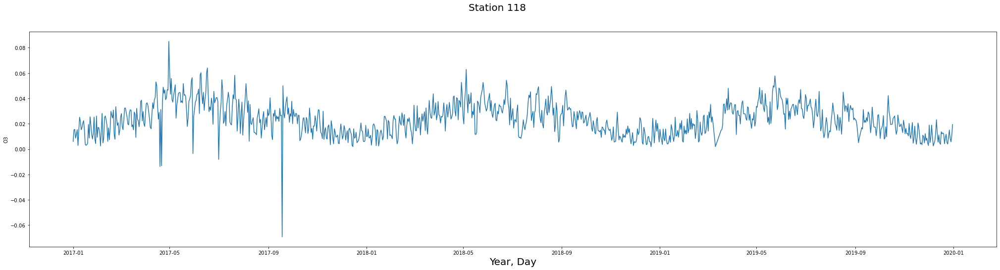

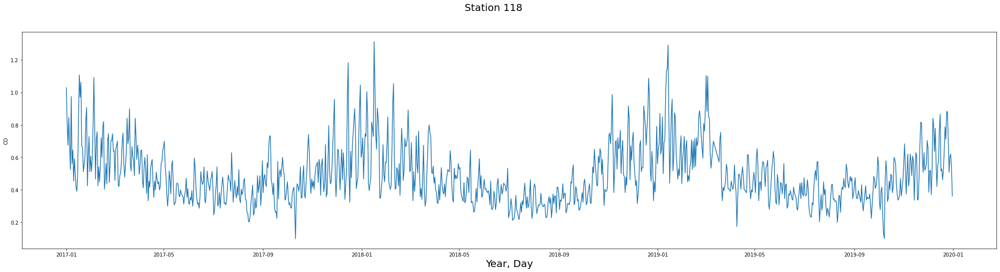

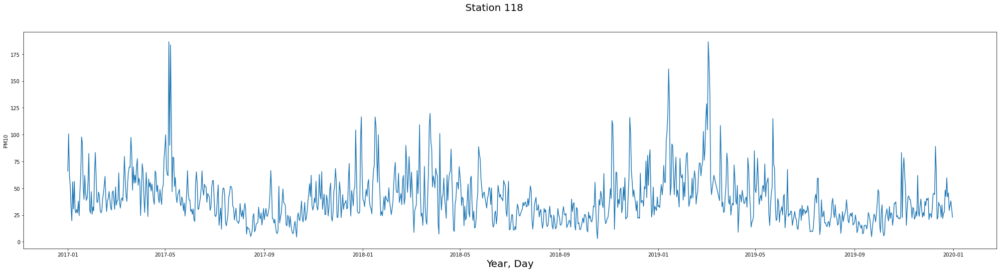

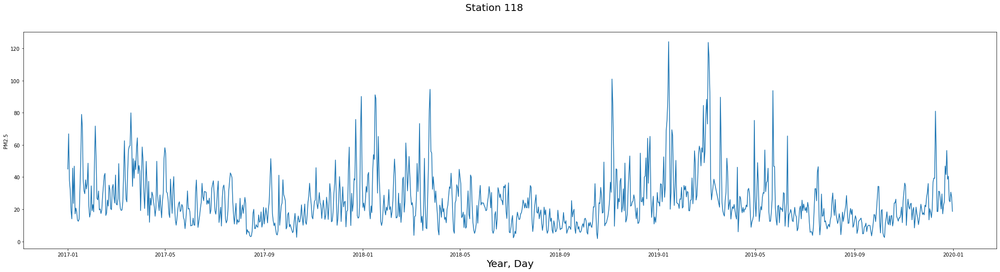

In [119]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 118", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_118)

# Station 119

In [120]:
df_119 = df[df['Station code'] == 119]

In [121]:
df_119.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,119,2017-01-01,0.004458,0.030333,0.005708,1.179167,70.250000,52.583333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,119,2017-01-02,0.004292,0.027042,0.013875,1.025000,107.333333,74.541667,Good,Good,Good,Good,Bad,Bad
2017-01-03,119,2017-01-03,-0.121292,-0.102583,-0.114958,0.583333,55.833333,36.416667,Good,Good,Good,Good,Normal,Bad
2017-01-04,119,2017-01-04,0.004375,0.033333,0.007958,1.008333,56.708333,33.500000,Good,Normal,Good,Good,Normal,Normal
2017-01-05,119,2017-01-05,0.004417,0.025292,0.010083,0.733333,36.750000,23.958333,Good,Good,Good,Good,Normal,Normal


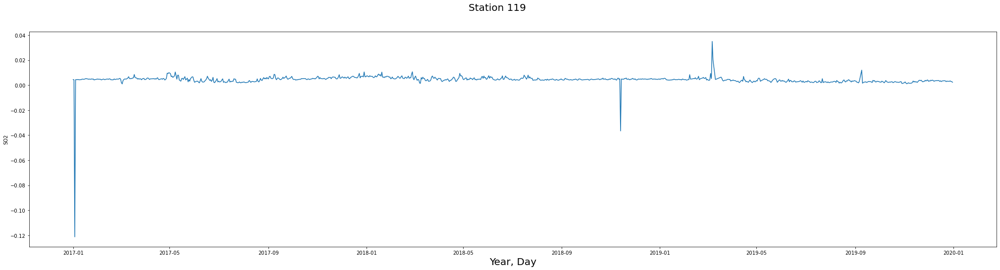

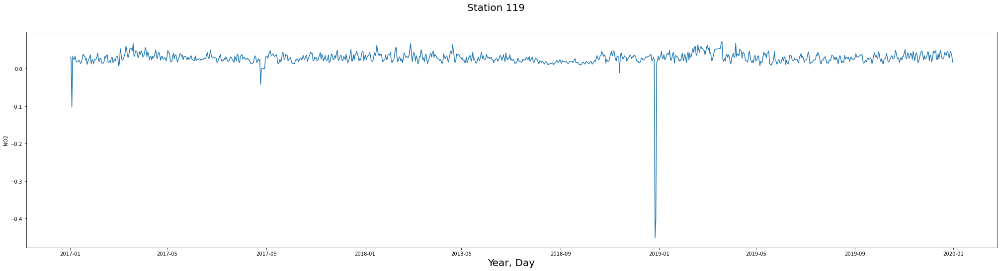

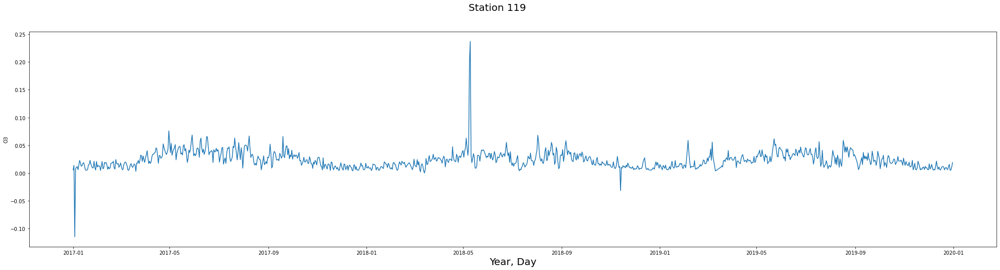

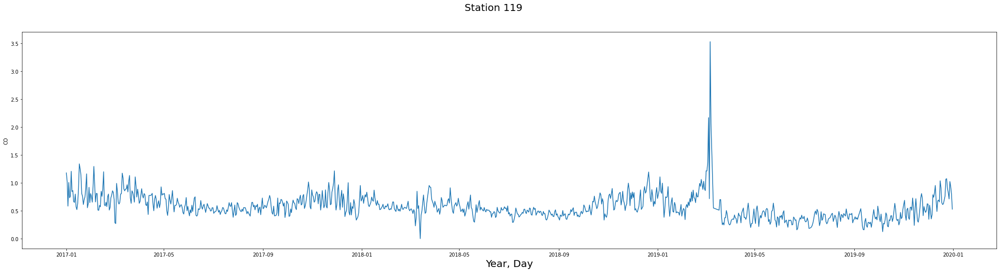

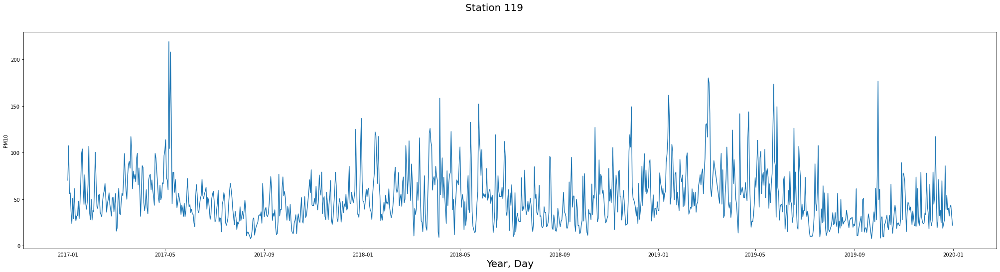

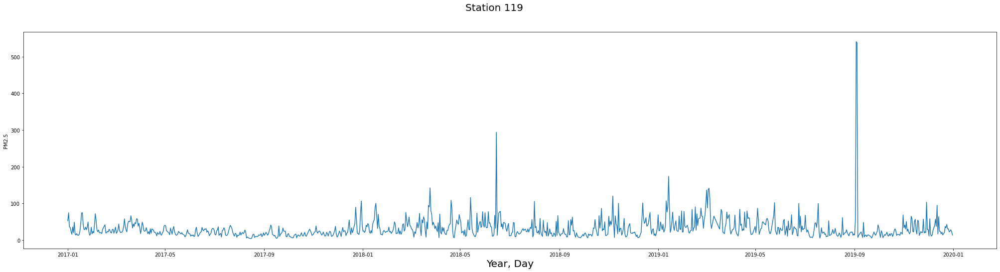

In [122]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 119", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_119)

# Station 120

In [123]:
df_120 = df[df['Station code'] == 120]

In [124]:
df_120.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,120,2017-01-01,0.005417,0.058292,0.003583,1.104167,71.666667,57.666667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,120,2017-01-02,0.009417,0.045167,0.018000,1.270833,99.791667,82.041667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,120,2017-01-03,0.004708,0.041167,0.017417,0.729167,63.416667,45.500000,Good,Normal,Good,Good,Normal,Bad
2017-01-04,120,2017-01-04,0.005000,0.055958,0.008958,0.862500,52.250000,35.333333,Good,Normal,Good,Good,Normal,Bad
2017-01-05,120,2017-01-05,0.003833,0.045333,0.008750,0.720833,32.458333,23.958333,Good,Normal,Good,Good,Normal,Normal


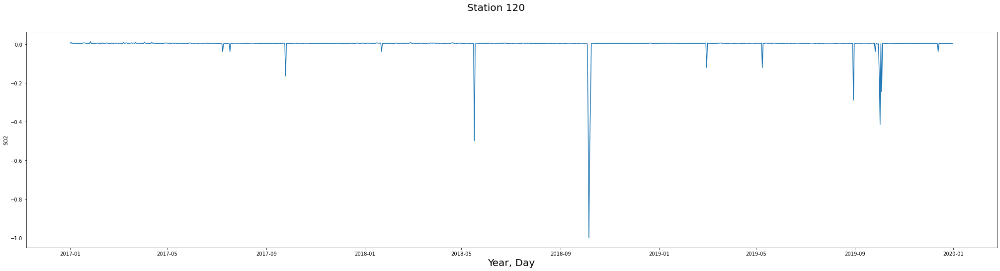

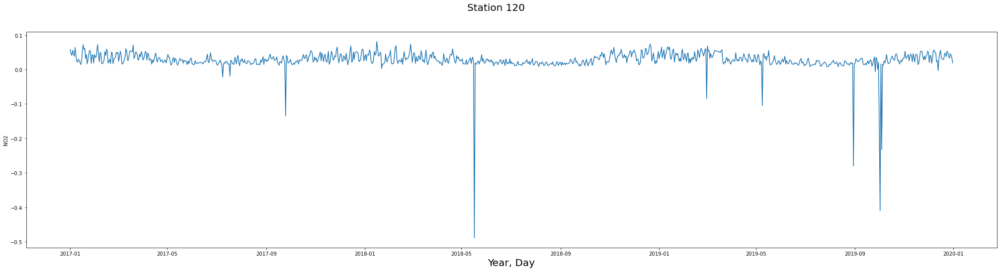

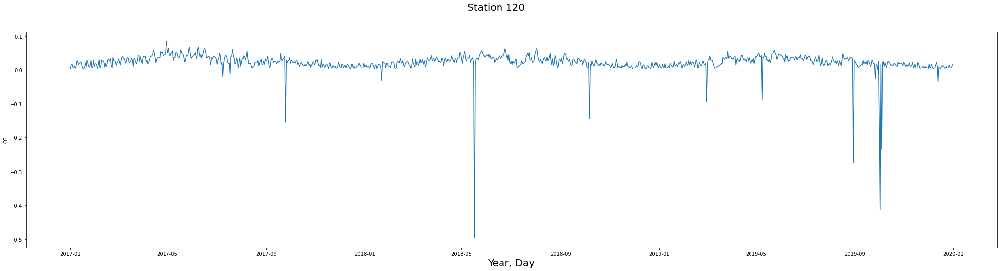

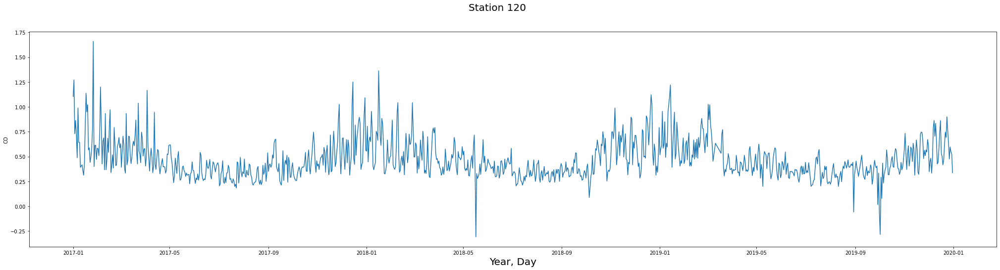

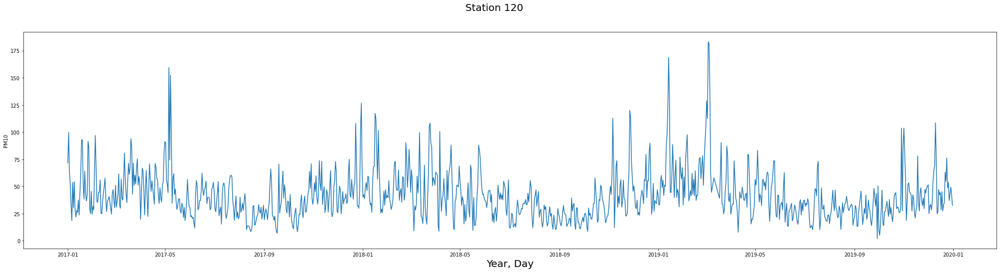

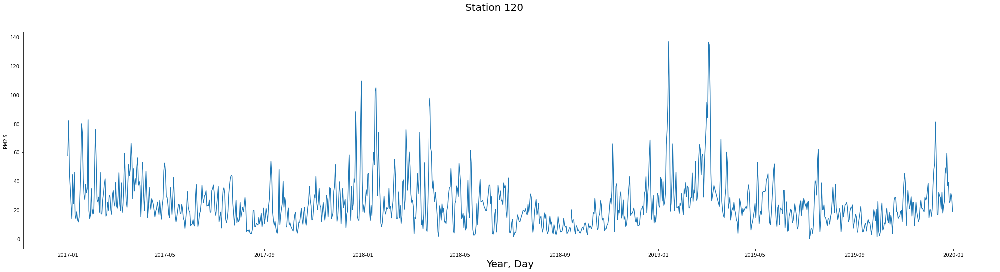

In [125]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 120", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_120)

# Station 121

In [126]:
df_121 = df[df['Station code'] == 121]

In [127]:
df_121.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,121,2017-01-01,0.006375,0.064333,0.005375,1.258333,74.958333,55.750000,Good,Bad,Good,Good,Normal,Bad
2017-01-02,121,2017-01-02,0.007833,0.047792,0.016667,0.975000,95.375000,67.916667,Good,Normal,Good,Good,Bad,Bad
2017-01-03,121,2017-01-03,0.006917,0.048583,0.013875,0.816667,64.291667,42.083333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,121,2017-01-04,0.006750,0.063958,0.008792,1.000000,54.666667,37.000000,Good,Bad,Good,Good,Normal,Bad
2017-01-05,121,2017-01-05,0.005542,0.049667,0.007667,0.695833,33.708333,24.541667,Good,Normal,Good,Good,Normal,Normal


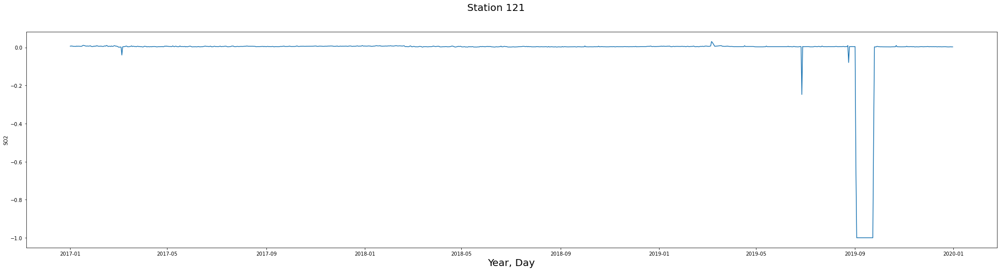

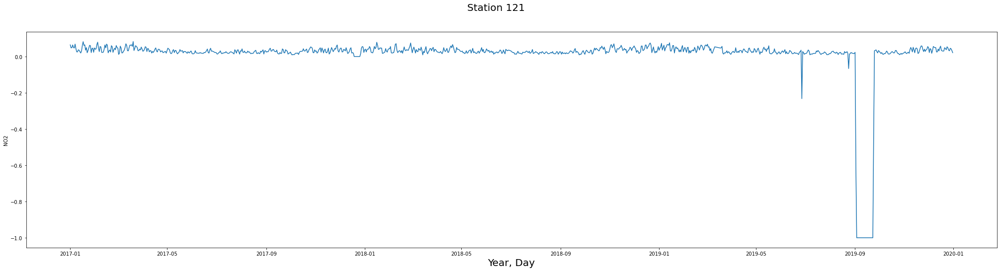

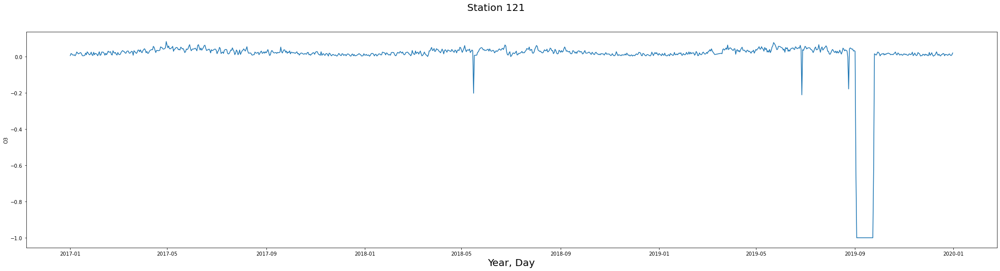

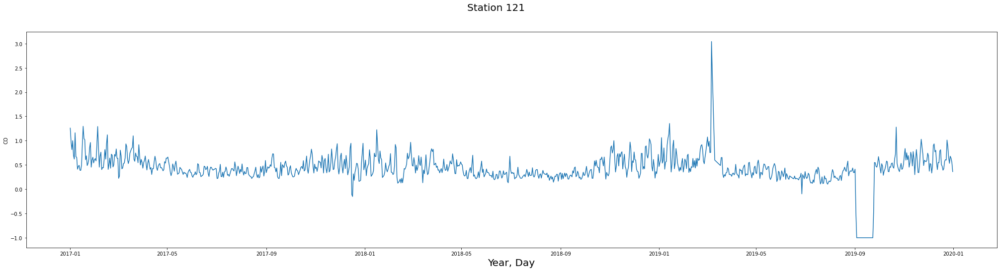

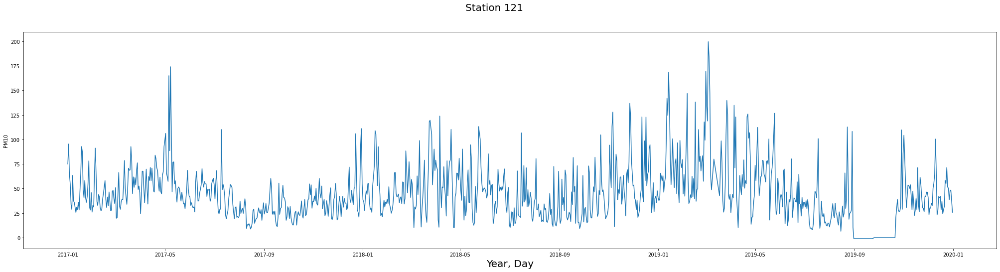

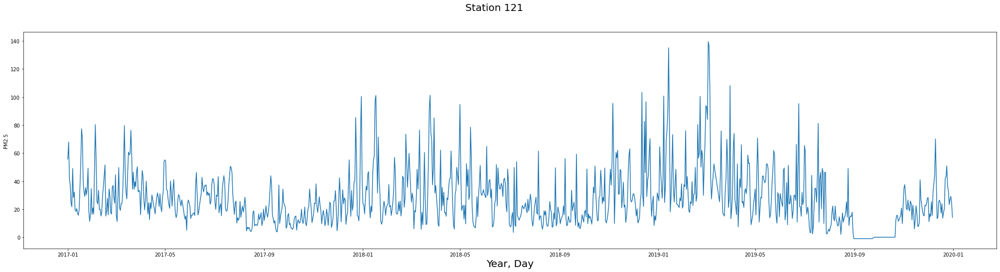

In [128]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 121", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_121)

# Station 122

In [129]:
df_122 = df[df['Station code'] == 122]

In [130]:
df_122.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,122,2017-01-01,0.005292,0.041500,0.005000,1.195833,87.250000,51.208333,Good,Normal,Good,Good,Bad,Bad
2017-01-02,122,2017-01-02,0.006000,0.036917,0.021458,0.925000,122.958333,68.250000,Good,Normal,Good,Good,Bad,Bad
2017-01-03,122,2017-01-03,0.005667,0.039750,0.018000,0.725000,76.166667,39.166667,Good,Normal,Good,Good,Normal,Bad
2017-01-04,122,2017-01-04,0.005417,0.047500,0.011792,0.895833,55.708333,28.041667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,122,2017-01-05,0.004917,0.038375,0.013292,0.795833,37.708333,17.625000,Good,Normal,Good,Good,Normal,Normal


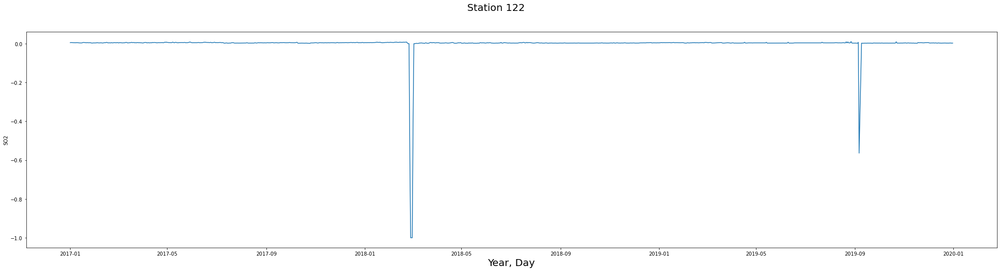

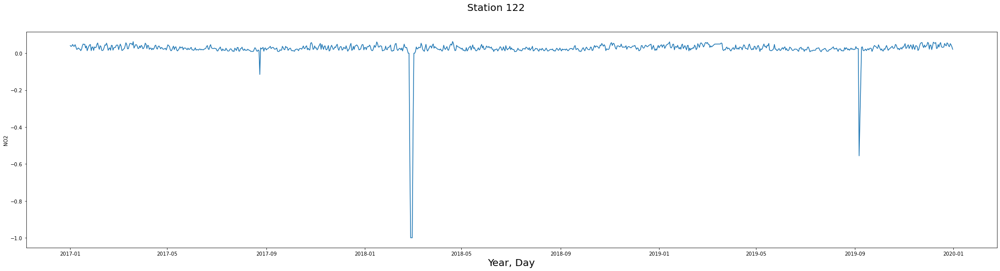

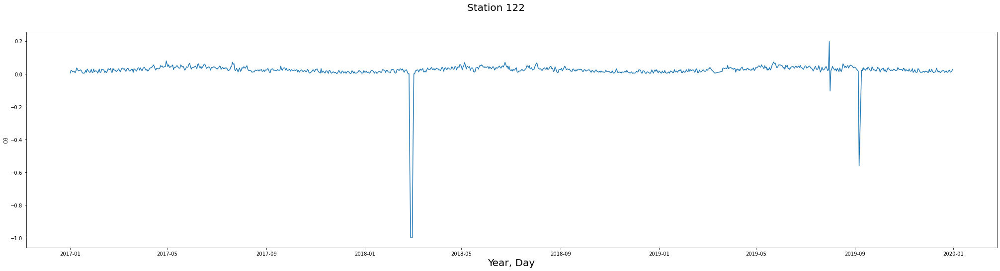

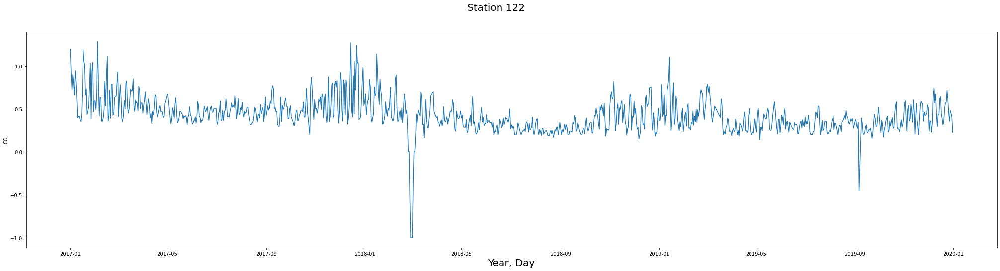

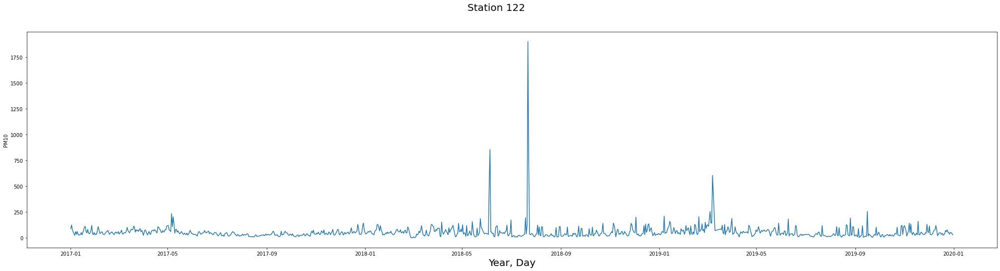

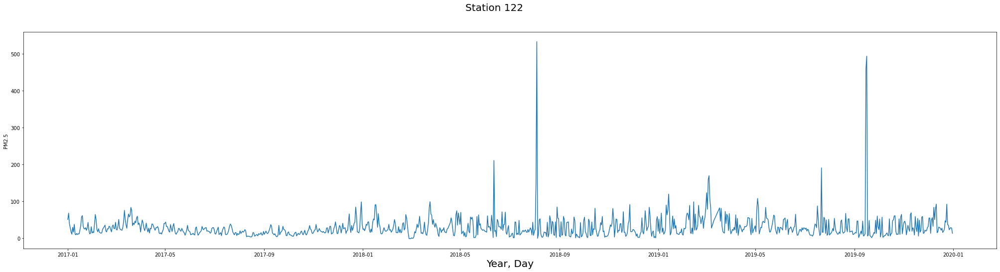

In [131]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 122", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_122)

# Station 123

In [132]:
df_123 = df[df['Station code'] == 123]

In [133]:
df_123.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,123,2017-01-01,0.004792,0.039750,0.002375,0.775000,79.625000,57.791667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,123,2017-01-02,0.005542,0.036000,0.014625,0.783333,118.416667,79.000000,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,123,2017-01-03,0.005625,0.036750,0.013542,0.641667,83.916667,50.041667,Good,Normal,Good,Good,Bad,Bad
2017-01-04,123,2017-01-04,0.005542,0.049667,0.006833,0.712500,57.875000,33.625000,Good,Normal,Good,Good,Normal,Normal
2017-01-05,123,2017-01-05,0.004667,0.038417,0.007542,0.512500,39.333333,20.541667,Good,Normal,Good,Good,Normal,Normal


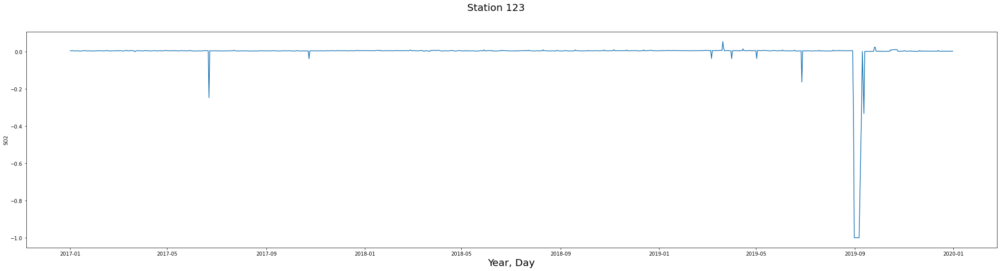

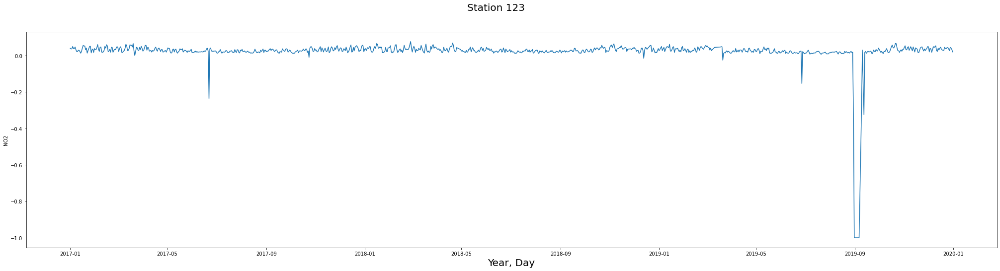

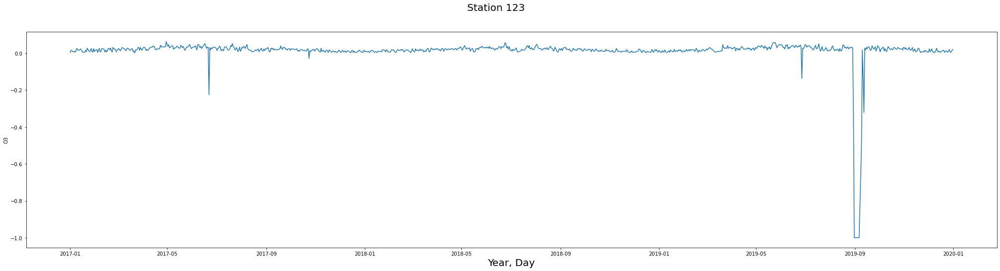

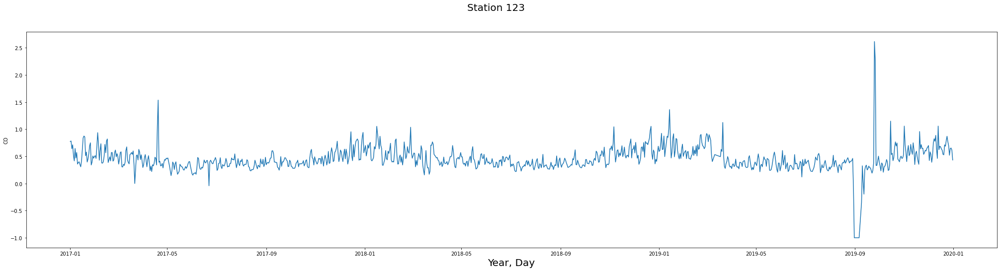

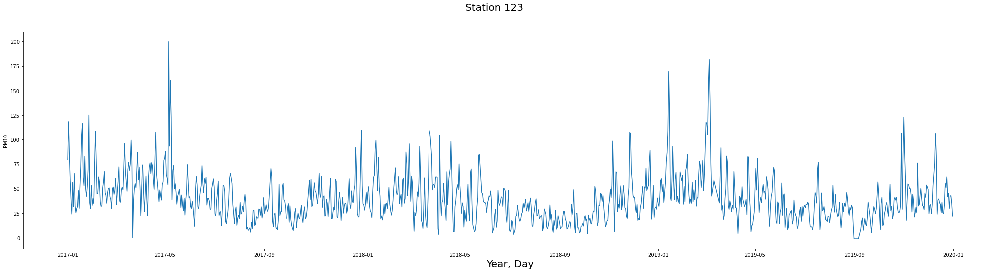

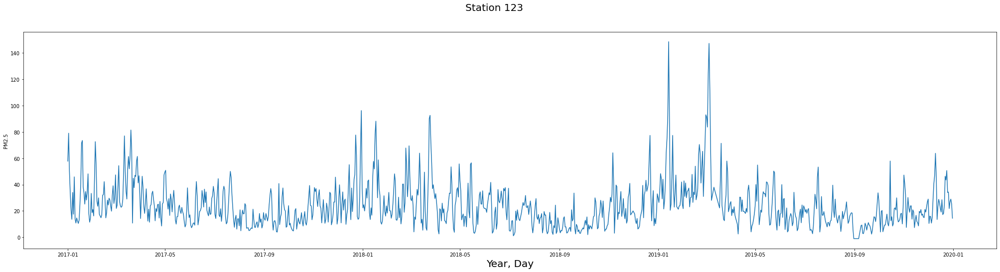

In [134]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 123", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_123)

# Station 124

In [135]:
df_124 = df[df['Station code'] == 124]

In [136]:
df_124.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,124,2017-01-01,0.005333,0.039500,0.003750,1.162500,63.958333,48.791667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,124,2017-01-02,0.005167,0.036375,0.018458,1.016667,92.416667,64.250000,Good,Normal,Good,Good,Bad,Bad
2017-01-03,124,2017-01-03,0.006083,0.038333,0.016583,0.866667,76.166667,47.041667,Good,Normal,Good,Good,Normal,Bad
2017-01-04,124,2017-01-04,0.006000,0.046958,0.008000,1.095833,54.583333,33.333333,Good,Normal,Good,Good,Normal,Normal
2017-01-05,124,2017-01-05,0.005625,0.032417,0.013542,0.783333,31.083333,19.375000,Good,Normal,Good,Good,Normal,Normal


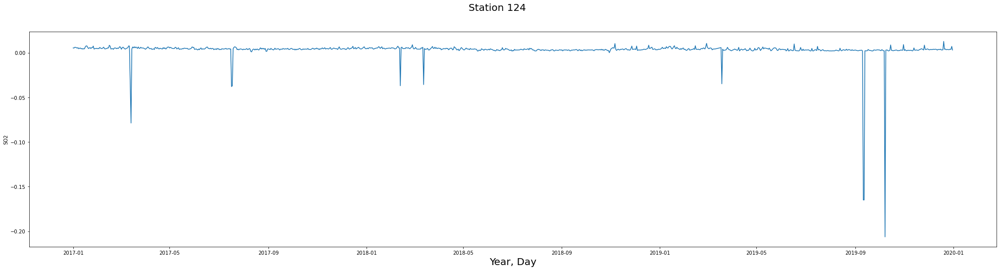

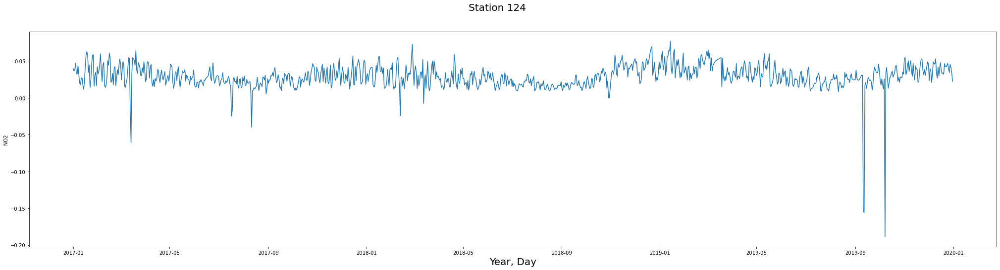

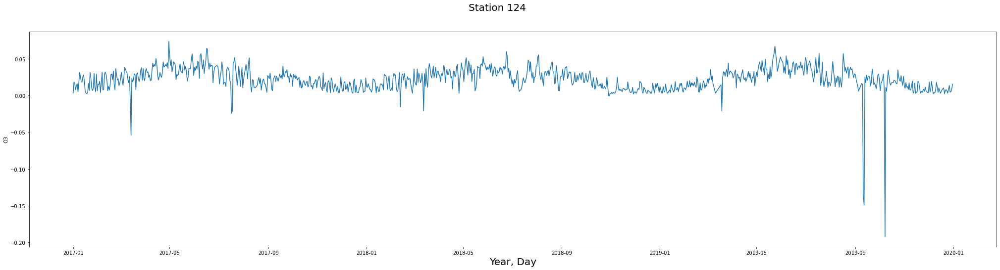

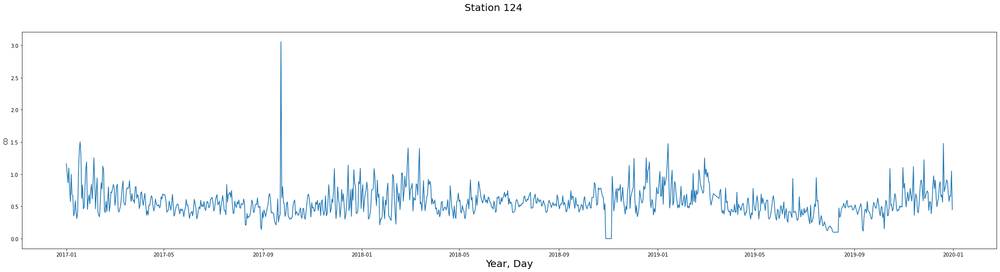

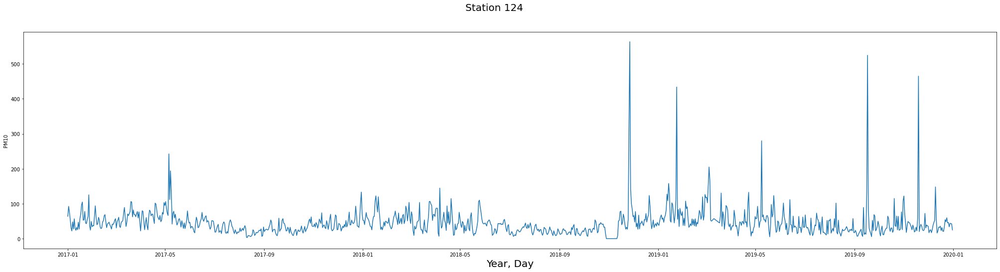

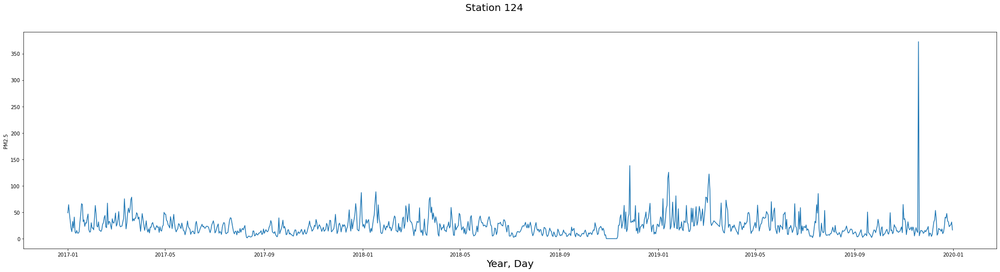

In [137]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 124", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_124)

# Station 125

In [138]:
df_125 = df[df['Station code'] == 125]

In [139]:
df_125.head()

,Station code,Measurement date,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,,
2017-01-01,125,2017-01-01,0.003833,0.039042,0.003375,0.825000,79.583333,54.208333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,125,2017-01-02,-0.037167,-0.003250,-0.028083,0.845833,115.583333,80.083333,Good,Good,Good,Good,Bad,Very Bad
2017-01-03,125,2017-01-03,0.004917,0.045333,0.011458,0.891667,105.958333,68.708333,Good,Normal,Good,Good,Bad,Bad
2017-01-04,125,2017-01-04,0.005000,0.055000,0.005208,0.958333,66.083333,39.666667,Good,Normal,Good,Good,Normal,Bad
2017-01-05,125,2017-01-05,0.004042,0.031708,0.013750,0.587500,35.541667,21.500000,Good,Normal,Good,Good,Normal,Normal


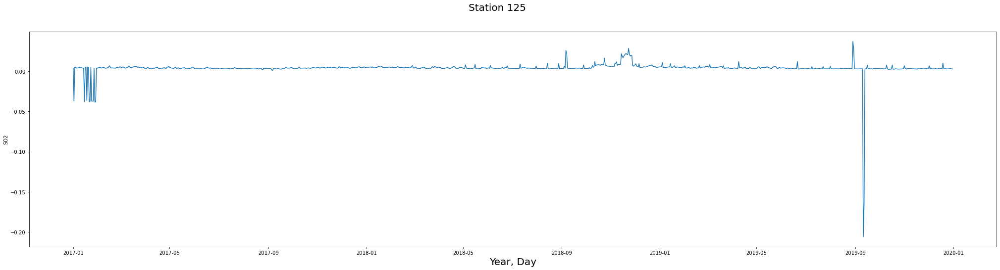

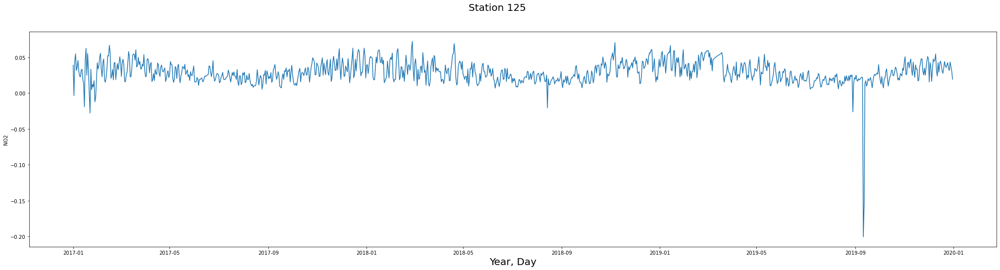

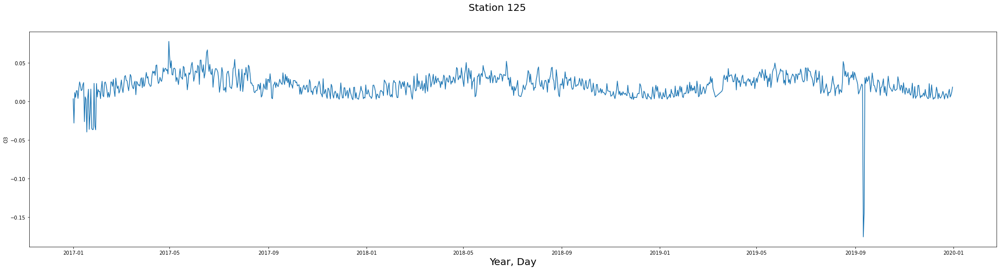

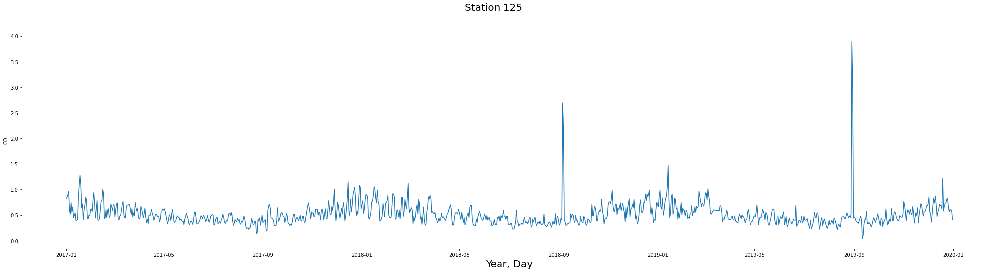

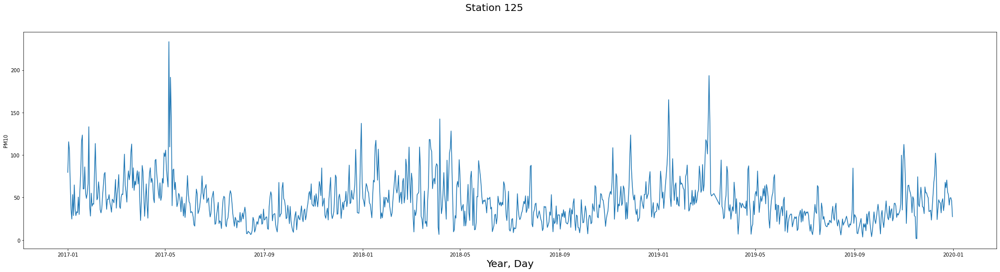

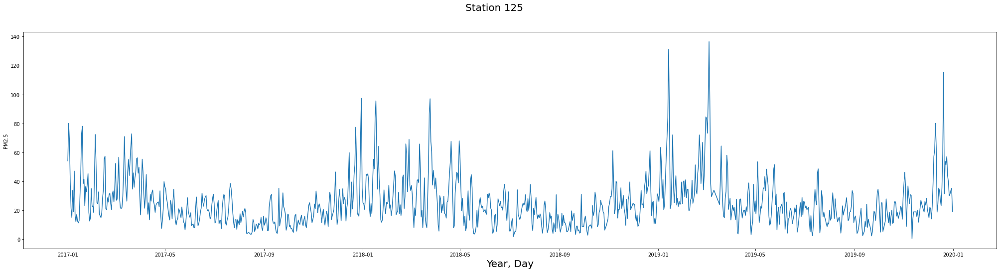

In [140]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 125", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_125)

# Visualizations

<AxesSubplot:xlabel='NO2 Level', ylabel='count'>

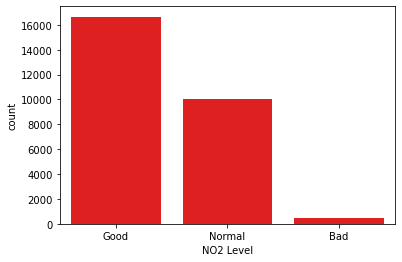

In [269]:
sns.countplot(x='NO2 Level',data=df, order=['Good', 'Normal', 'Bad'], color='red')

<AxesSubplot:xlabel='PM10 Level', ylabel='count'>

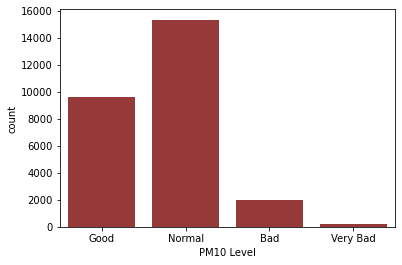

In [270]:
sns.countplot(x='PM10 Level',data=df, order=['Good', 'Normal', 'Bad', 'Very Bad'], color='brown')

<AxesSubplot:xlabel='PM2.5 Level', ylabel='count'>

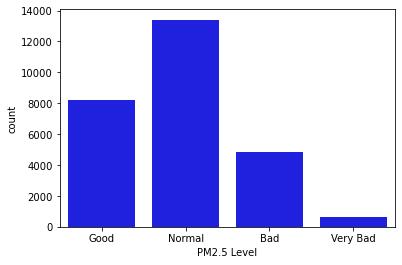

In [271]:
sns.countplot(x='PM2.5 Level',data=df, order=['Good', 'Normal', 'Bad', 'Very Bad'], color='blue')